# RESEARCH QUESTION: Consumption forecasting.
We can use the weather forecast for the same day, but consumnption forecasting stops 5 days in advance.

It is said that the forecase is made at around 10 am., but considering the rest of the information we assume the following:

If the forecast is made for the 19th we can use the hourly consumption until 23:59 the 13th.

**Explain methods used in pipeline**
1. Domain understanding
2. Data acquisition
3. Data exploration and visualization
4. Data preprocessing: cleaning, transformation, normalization
5. Feature engineering: construction, selection
6. Model engineering: construction, selection, hyperparameter tuning
7. Evaluation: cross-validation, comparing with baselines

**Time series components:**
- Seasonal
- Trend
- Irregular

This will only be included if we use statistical models.

**Methods:**
- Baseline
- XGBoost (simle input) scrapped, performed poorly
- XGBoost 1 per city
- XGBoost all
- XGBoost all kfold tuned
- RNN: LSTM 1 per city
- RNN: LSTM all
- RNN: Dual-LSTM all 
- RNN: Dual-LSTM all kfold tuned
- Transformer all
- Transformer encoder-only all
- Dual-Transformer all 

## Load Data

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [3]:
dtype_mapping = {
    'location': 'category',
    'consumption': 'float',
    'temperature': 'float',
}
df = pd.read_csv('data/consumption_temp.csv', dtype=dtype_mapping, parse_dates=['time'])
# set column

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49494 entries, 0 to 49493
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   time         49494 non-null  datetime64[ns]
 1   location     49494 non-null  category      
 2   consumption  49494 non-null  float64       
 3   temperature  49494 non-null  float64       
dtypes: category(1), datetime64[ns](1), float64(2)
memory usage: 1.2 MB


In [5]:
df.head()

,time,location,consumption,temperature
0,2022-04-07 21:00:00,bergen,1.113325,-0.3
1,2022-04-07 21:00:00,oslo,4.092830,1.0
2,2022-04-07 21:00:00,stavanger,2.057858,1.3
3,2022-04-07 21:00:00,tromsø,1.246582,-3.9
4,2022-04-07 21:00:00,trondheim,1.970098,-2.8


In [6]:
# get counts of each location
df['location'].value_counts()

location
bergen         8641
oslo           8641
stavanger      8641
tromsø         8641
trondheim      8641
helsingfors    6289
Name: count, dtype: int64

In [7]:
# drop location helsingfors
df = df[df['location'] != 'helsingfors']
df['location'] = df['location'].cat.remove_unused_categories()
df['location'].value_counts()

location
bergen       8641
oslo         8641
stavanger    8641
tromsø       8641
trondheim    8641
Name: count, dtype: int64

In [8]:
cities = df['location'].unique()

In [9]:
# explode data based on location
# Pivot for consumption
df_consumption = df.pivot(index='time', columns='location', values='consumption')
df_consumption.columns = [f'{col}_consumption' for col in df_consumption.columns]

# Pivot for temperature
df_temperature = df.pivot(index='time', columns='location', values='temperature')
df_temperature.columns = [f'{col}_temp' for col in df_temperature.columns]

# Merge the two dataframes on time
df_merged = df_consumption.merge(df_temperature, left_index=True, right_index=True)
df_merged.head()

,bergen_consumption,oslo_consumption,stavanger_consumption,tromsø_consumption,trondheim_consumption,bergen_temp,oslo_temp,stavanger_temp,tromsø_temp,trondheim_temp
time,,,,,,,,,,
2022-04-07 21:00:00,1.113325,4.092830,2.057858,1.246582,1.970098,-0.3,1.0,1.3,-3.9,-2.8
2022-04-07 22:00:00,1.050327,3.818095,1.918996,1.180321,1.839443,0.0,0.4,0.8,-4.3,-3.3
2022-04-07 23:00:00,1.008794,3.660981,1.821749,1.138952,1.747675,-0.5,0.3,1.1,-5.1,-3.8
2022-04-08 00:00:00,0.984202,3.584066,1.782011,1.140786,1.703176,-1.1,0.2,1.1,-5.7,-4.2
2022-04-08 01:00:00,0.950335,3.549536,1.744253,1.140567,1.694300,-0.7,0.4,1.0,-3.9,-4.1


In [10]:
# add hour column
df_merged['hour'] = df_merged.index.hour
# add weekday column
df_merged['weekday'] = df_merged.index.weekday
df_merged.head()

,bergen_consumption,oslo_consumption,stavanger_consumption,tromsø_consumption,trondheim_consumption,bergen_temp,oslo_temp,stavanger_temp,tromsø_temp,trondheim_temp,hour,weekday
time,,,,,,,,,,,,
2022-04-07 21:00:00,1.113325,4.092830,2.057858,1.246582,1.970098,-0.3,1.0,1.3,-3.9,-2.8,21,3
2022-04-07 22:00:00,1.050327,3.818095,1.918996,1.180321,1.839443,0.0,0.4,0.8,-4.3,-3.3,22,3
2022-04-07 23:00:00,1.008794,3.660981,1.821749,1.138952,1.747675,-0.5,0.3,1.1,-5.1,-3.8,23,3
2022-04-08 00:00:00,0.984202,3.584066,1.782011,1.140786,1.703176,-1.1,0.2,1.1,-5.7,-4.2,0,4
2022-04-08 01:00:00,0.950335,3.549536,1.744253,1.140567,1.694300,-0.7,0.4,1.0,-3.9,-4.1,1,4


# Pre process

## Standarization

In [11]:
def standardize_data(df):
    # Per location
    # standardize data
    np_df = df.to_numpy()
    for i in range(5):
        # get mean and std for consumption
        consumption_mean = np_df[:, i].mean()
        consumption_std = np_df[:, i].std()

        # get mean and std for temperature
        temp_mean = np_df[:, i+5].mean()
        temp_std = np_df[:, i+5].std()

        # standardize data
        np_df[:, i] = (np_df[:, i] - consumption_mean) / consumption_std
        np_df[:, i+5] = (np_df[:, i+5] - temp_mean) / temp_std
    return np_df

In [12]:
np_df = standardize_data(df_merged)
df = pd.DataFrame(np_df, columns=df_merged.columns, index=df_merged.index)
df.head()

,bergen_consumption,oslo_consumption,stavanger_consumption,tromsø_consumption,trondheim_consumption,bergen_temp,oslo_temp,stavanger_temp,tromsø_temp,trondheim_temp,hour,weekday
time,,,,,,,,,,,,
2022-04-07 21:00:00,-0.660391,-0.595758,-0.590128,-0.168468,-0.271248,-1.227807,-0.728916,-1.241145,-0.930639,-1.183463,21.0,3.0
2022-04-07 22:00:00,-0.714890,-0.654558,-0.655851,-0.286978,-0.386136,-1.182052,-0.797328,-1.326767,-0.980848,-1.249112,22.0,3.0
2022-04-07 23:00:00,-0.750819,-0.688184,-0.701877,-0.360968,-0.466829,-1.258311,-0.808730,-1.275394,-1.081266,-1.314761,23.0,3.0
2022-04-08 00:00:00,-0.772093,-0.704646,-0.720685,-0.357688,-0.505958,-1.349822,-0.820132,-1.275394,-1.156579,-1.367279,0.0,4.0
2022-04-08 01:00:00,-0.801390,-0.712036,-0.738556,-0.358079,-0.513762,-1.288814,-0.797328,-1.292518,-0.930639,-1.354150,1.0,4.0


<Axes: xlabel='time'>

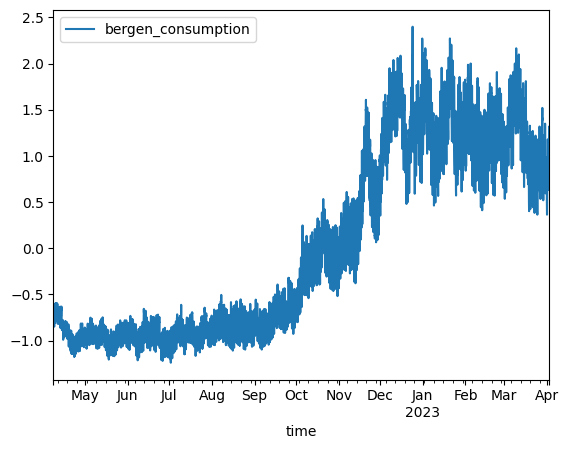

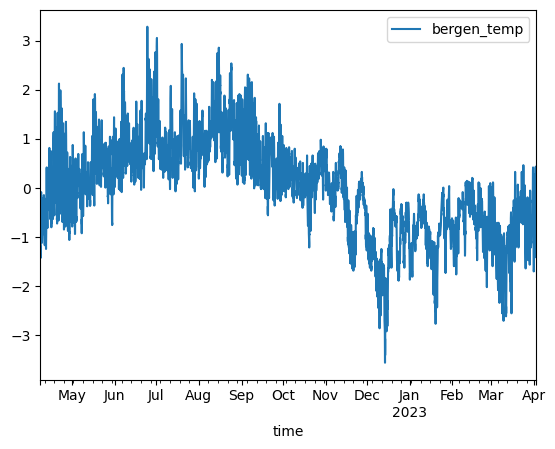

In [13]:
# plot to check if data is standardized
df[['bergen_consumption']].plot()
df[['bergen_temp']].plot()

## Split data

We split the data into training-validation-set and test-set. 
To ensure no leaks we make sure each period does not have overlap.
This however leads to significantly less data than if we would allow for overlap.
Still, we can allow for the test-set to have features from the trainin-validation-set, which makes us able to test on more data or decrease the dedicatedtest-set to train on more data.


To also ensure that the data is varied we split on a cyclic basis to cover seasonality variety in all splits. 
This also leads to even more loss of data... but we believe it is nessecary for the models to see less, but closer data than more data that is further from the same distributions.

It is a pity there is not more data. 1 year is awfully little data and 5 days delay is an awful lot, escpecially when we lose even more y-values due to needing data before. 
Setting up a system to get reliable consumptions hours or just 1 day before forecasts could be looked into. And it could be a possibility to see how that would increase the performance of the models.
However, I suspect that it will be left out.

In [14]:
# create a function to makes splits of the data
# we get time series as output
def split_data(df_, train_val_size, splits):
    # df: df to split
    # train_val_size: size of the training and validation data in float percentage
    # splits: number of splits to make
    train_val = []
    test = []
    split_size = df_.shape[0] // splits
    # loop through the data
    for i in range(splits):
        # get the start and end index of the split
        start = i * split_size
        end = (i + 1) * split_size
        # get the data
        data = df_[start:end]
        # get the train and validation data
        train_val.append(data.index[:int(train_val_size * data.shape[0])])
        # get the test data
        test.append(data.index[int(train_val_size * data.shape[0]):])
    # return the split data
    return np.array(train_val), np.array(test)

In [15]:
# split the data
train_val_times, test_times = split_data(df, 0.8, 4)
train_val_times

array([['2022-04-07T21:00:00.000000000', '2022-04-07T22:00:00.000000000',
        '2022-04-07T23:00:00.000000000', ...,
        '2022-06-18T18:00:00.000000000', '2022-06-18T19:00:00.000000000',
        '2022-06-18T20:00:00.000000000'],
       ['2022-07-06T21:00:00.000000000', '2022-07-06T22:00:00.000000000',
        '2022-07-06T23:00:00.000000000', ...,
        '2022-09-16T18:00:00.000000000', '2022-09-16T19:00:00.000000000',
        '2022-09-16T20:00:00.000000000'],
       ['2022-10-04T21:00:00.000000000', '2022-10-04T22:00:00.000000000',
        '2022-10-04T23:00:00.000000000', ...,
        '2022-12-15T18:00:00.000000000', '2022-12-15T19:00:00.000000000',
        '2022-12-15T20:00:00.000000000'],
       ['2023-01-02T21:00:00.000000000', '2023-01-02T22:00:00.000000000',
        '2023-01-02T23:00:00.000000000', ...,
        '2023-03-15T18:00:00.000000000', '2023-03-15T19:00:00.000000000',
        '2023-03-15T20:00:00.000000000']], dtype='datetime64[ns]')

In [16]:
# check the length of each split
train_val_times.shape[1], test_times.shape[1]

(1728, 432)

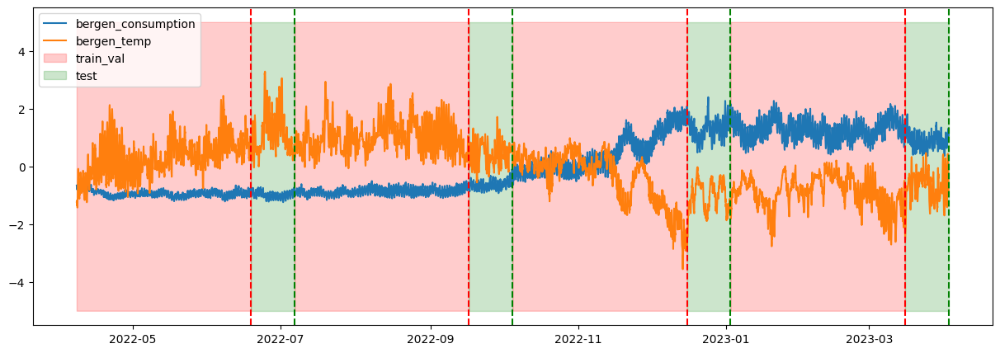

In [17]:
# plot the time splits
def plot_time_splits(city, min_y, max_y, train_val_times, test_times):
    plt.figure(figsize=(15, 5))
    plt.plot(df.index, df[f'{city}_consumption'], label=f'{city}_consumption')
    plt.plot(df.index, df[f'{city}_temp'], label=f'{city}_temp')

    # Initialize previous period end
    prev_period_end = df.index[0]

    # Alternate between train_val and test times
    for train_period, test_period in zip(train_val_times, test_times):
        # Fill train_val period
        plt.fill_between(df.index, min_y, max_y, where=(df.index >= prev_period_end) & (df.index < train_period[-1]),
                         color='red', alpha=0.2, label='train_val' if prev_period_end == df.index[0] else None)
        # Draw train_val vertical line
        plt.axvline(train_period[-1], color='red', linestyle='--')

        # Fill test period
        plt.fill_between(df.index, min_y, max_y, where=(df.index >= train_period[-1]) & (df.index < test_period[-1]),
                         color='green', alpha=0.2, label='test' if prev_period_end == df.index[0] else None)
        # Draw test vertical line
        plt.axvline(test_period[-1], color='green', linestyle='--')

        # Update previous period end
        prev_period_end = test_period[-1]

    # Handle any remaining train_val period after the last test period
    if len(train_val_times) > len(test_times):
        last_train_period = train_val_times[-1]
        plt.fill_between(df.index, min_y, max_y, where=(df.index >= prev_period_end),
                         color='red', alpha=0.2, label='train_val' if prev_period_end == df.index[0] else None)
        plt.axvline(last_train_period[-1], color='red', linestyle='--')

    # If there are more test periods, handle the last one
    if len(test_times) > len(train_val_times):
        last_test_period = test_times[-1]
        plt.fill_between(df.index, min_y, max_y, where=(df.index >= prev_period_end),
                         color='green', alpha=0.2, label='test' if prev_period_end == df.index[0] else None)
        plt.axvline(last_test_period[-1], color='green', linestyle='--')

    # Add legend
    plt.legend()
    plt.show()
plot_time_splits('bergen', -5, 5, train_val_times, test_times)

# Baseline prediction

In [18]:
def visualize_and_get_metrics(splits, prediction, truth):
    # Setup table to get metrics
    metrics_dict = {'Split': [], 'City': [], 'MAE': [], 'MSE': [], 'RMSE': [], 'MAPE': []}

    # Set up the 3x5 grid of subplots
    fig, axs = plt.subplots(splits, 5, figsize=(25, 15))

    for i in range(splits): # For each split
        for j in range(5):  # For each city
            prediction_ = prediction[i, :, j]
            truth_ = truth[i, :, j]
            axis = np.arange(prediction_.shape[0])
            # Calculate mean absolute error
            mae = np.mean(np.abs(prediction_ - truth_))
            # Calculate mean squared error
            mse = np.mean(np.square(prediction_ - truth_))
            # Calculate root mean squared error
            rmse = np.sqrt(mse)
            # Calculate mean absolute percentage error
            mape = np.mean(np.abs((prediction_ - truth_) / truth_)) * 100

            # Store metrics in the dictionary
            metrics_dict['Split'].append(i+1)
            metrics_dict['City'].append(j+1)
            metrics_dict['MAE'].append(mae)
            metrics_dict['MSE'].append(mse)
            metrics_dict['RMSE'].append(rmse)
            metrics_dict['MAPE'].append(mape)
            
            # Plot the prediction_ and truth_
            ax = axs[i, j]
            ax.plot(axis, truth_, label=f'Groundtruth')
            ax.plot(axis, prediction_, label=f'Prediction')
            ax.set_xlabel('Time')
            ax.set_ylabel('Value')
            ax.set_title(f'Split {i+1}, City: {cities[j]}')
            ax.legend()

            # Also, create individual plots
            fig_individual = plt.figure(figsize=(6, 4))
            plt.plot(axis, truth_, label=f'Groundtruth')
            plt.plot(axis, prediction_, label=f'Prediction')
            plt.xlabel('Time')
            plt.ylabel('Value')
            plt.title(f'Split {i+1}, City: {cities[j]}')
            plt.legend()

    # Adjust layout so that plots do not overlap
    plt.tight_layout()
    # plt.subplots_adjust(left=0.55, right=0.95, bottom=0.05, top=0.95, wspace=0.4, hspace=0.6)

    # Display all the plots
    plt.show()

    # Now, let's display each individual plot separately
    # for fig_individual in individual_plots:
    #     fig_individual.show()

    # Convert the dictionary to a DataFrame
    metrics_df = pd.DataFrame(metrics_dict)

    # Calculate the average of the metrics for each city across splits
    avg_metrics_df = metrics_df.groupby('City').mean().reset_index()

    # Display the metrics table
    print("Metrics per City and Split:")
    display(metrics_df)

    # Display the average metrics per city
    print("\nAverage Metrics per City Across Splits:")
    display(avg_metrics_df)

    # Print the overall means
    print(f'\nOverall Mean Metrics:')
    print(f'Mean MAE: {metrics_df["MAE"].mean()}')
    print(f'Mean MSE: {metrics_df["MSE"].mean()}')
    print(f'Mean RMSE: {metrics_df["RMSE"].mean()}')
    print(f'Mean MAPE: {metrics_df["MAPE"].mean()}')

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\2449073212.py:40: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig_individual = plt.figure(figsize=(6, 4))


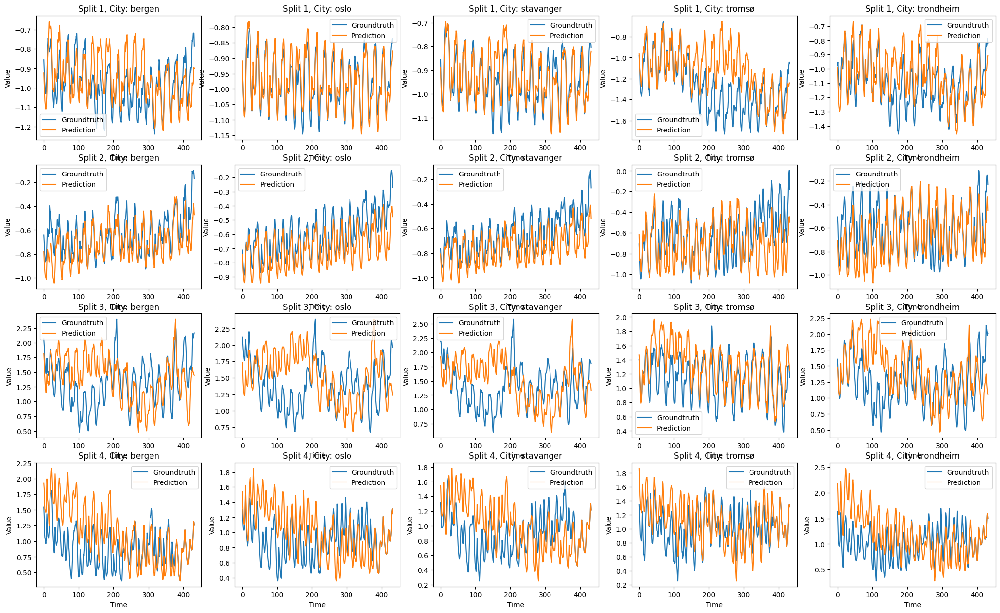

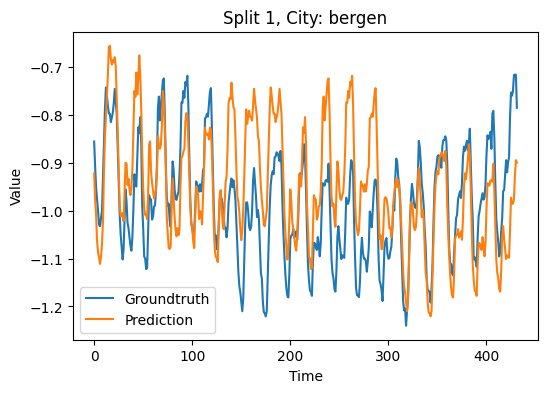

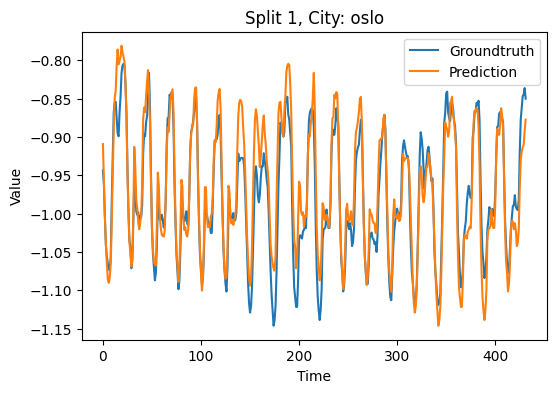

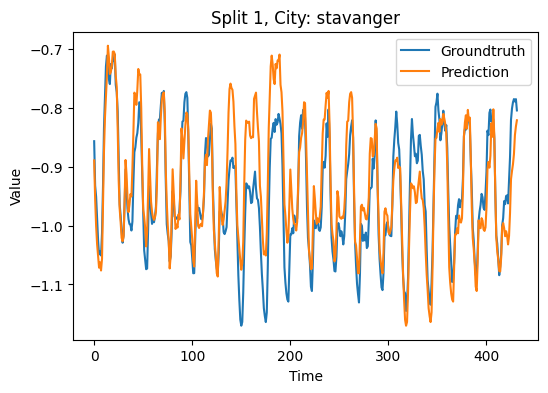

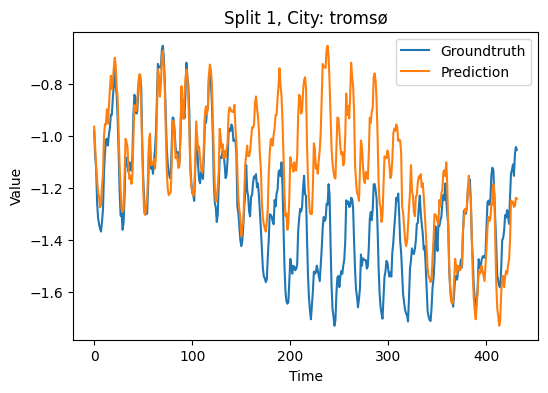

...

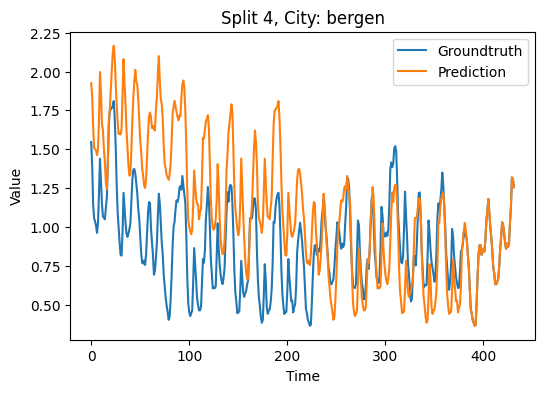

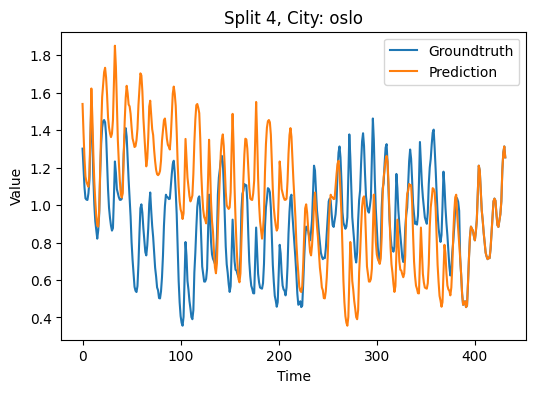

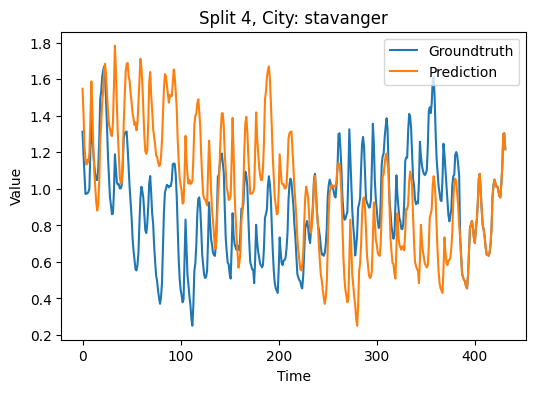

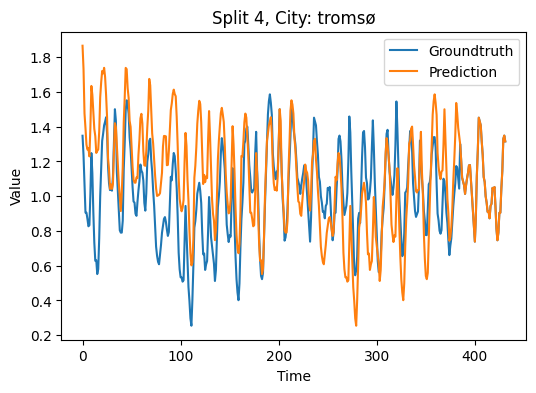

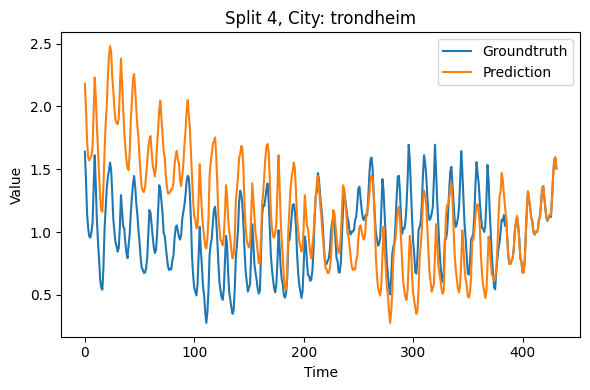

Metrics per City and Split:


,Split,City,MAE,MSE,RMSE,MAPE
0,1,1,0.092682,0.012242,0.110642,9.541292
1,1,2,0.024829,0.001086,0.032951,2.559050
2,1,3,0.043895,0.003151,0.056136,4.700671
3,1,4,0.189708,0.063890,0.252764,13.971787
4,1,5,0.101818,0.015730,0.125421,9.178977
5,2,1,0.097524,0.016194,0.127258,21.185774
6,2,2,0.101553,0.014793,0.121625,20.626119
7,2,3,0.110457,0.017303,0.131540,21.223917
8,2,4,0.156683,0.038831,0.197057,61.433205
9,2,5,0.108527,0.019760,0.140571,21.967358



Average Metrics per City Across Splits:


,City,Split,MAE,MSE,RMSE,MAPE
0,1,2.5,0.226197,0.103286,0.278582,27.209364
1,2,2.5,0.207189,0.097336,0.251261,23.415703
2,3,2.5,0.223200,0.107009,0.270330,25.572601
3,4,2.5,0.193022,0.061360,0.246018,30.142708
4,5,2.5,0.230106,0.107612,0.288690,26.041008



Overall Mean Metrics:
Mean MAE: 0.2159427775063814
Mean MSE: 0.09532063399577066
Mean RMSE: 0.2669763209093873
Mean MAPE: 26.47627679017616


In [19]:
# NB: here we use some of the features in the training data for the test data
# get all dates 1 week before test_dates
train_val_dates = np.concatenate(test_times) - pd.Timedelta(days=7)
truth = df.loc[np.concatenate(test_times), df.columns[:5]].to_numpy()
prediction = df.loc[train_val_dates, df.columns[:5]].to_numpy()
# reshape per split
truth = truth.reshape(4, -1, 5)
prediction = prediction.reshape(4, -1, 5)
# visualize the data
visualize_and_get_metrics(4, prediction, truth)

Potential for more here

Interesting note: When using 3 way split the test data for series 1 SUPER similar, but split 2 and 3 is really different. Maybe something to note for the text.

In [20]:
truth.shape, prediction.shape

((4, 432, 5), (4, 432, 5))

# Model 1: Statistical

# Model 2: XGBoost / Tabular

## Setup Tabular

Here we set up the data in a tabular format with lags.

There are so many choices to make here... I have no idea what is good and what is not. The best would be to try all, but there are WAY too many.
Can list some here:
- Should we have all cities data in the same dataset and predict or should we split per city.
- If we split per city should we train one model or all cities or different per city.
- What features should we include, just the relevant hour of prediction with lags or all hours previously (for a period).

If we just include everything we can test for which columns are good, but I give up on trying that...

I tried to include every feature, but it should be fixed now.

### Simple Tabulizer

In [21]:
# Create a dataset with features:
# - time, week_before and week_before2 (only used to validate that the data is correct)
# - split
# - the same hour consumption the two previous weeks
# - the temperature of the two previous weeks
# - the temperature forecast of the hour
# - the hour of the day
# - the day of the week
# - city
# NB: tabulize is probably the wrong word for this exact operation.
def create_feature_dict(df, times, cities, is_train):
    splits = len(times)
    feature_dict = {
        'time_pred' : [],
        'time_week_before' : [],
        'time_week_before2' : [],
        'split': [], 
        'two_week_consumption': [], 
        'one_week_consumption': [], 
        'two_week_temp': [], 
        'one_week_temp': [], 
        'temp_forecast': [],
        'hour': [],
        'weekday': [],
        'city': [],
        'y': []
    }
    # loop through the splits
    for i in range(splits):
        # first for train_val
        for j in range(times[i, 24*15:].shape[0]):
            for k, city in enumerate(cities):
                # for train
                if is_train:
                    time_pred = times[i, j + 14*24]
                else:
                    # for test
                    time_pred = test_times[i, j]
                week_before = time_pred - pd.Timedelta(days=7)
                week_before2 = time_pred - pd.Timedelta(days=14)
                # add split
                feature_dict['split'].append(i)
                # add hour and day of the week
                feature_dict['hour'].append(df.loc[time_pred, 'hour'])
                feature_dict['weekday'].append(df.loc[time_pred, 'weekday'])
                # get the consumption data of the two previous weeks
                feature_dict['two_week_consumption'].append(df.loc[week_before2, f'{city}_consumption'])
                feature_dict['one_week_consumption'].append(df.loc[week_before, f'{city}_consumption'])
                # get target
                feature_dict['y'].append(df.loc[time_pred, f'{city}_consumption'])
                # get the temperature data of the two previous weeks
                feature_dict['two_week_temp'].append(df.loc[week_before2, f'{city}_temp'])
                feature_dict['one_week_temp'].append(df.loc[week_before, f'{city}_temp'])
                # get the temperature forecast of the hour
                feature_dict['temp_forecast'].append(df.loc[time_pred, f'{city}_temp'])
                # add city
                feature_dict['city'].append(k)
                # add time
                feature_dict['time_pred'].append(time_pred)
                feature_dict['time_week_before'].append(week_before)
                feature_dict['time_week_before2'].append(week_before2)

    return feature_dict

def tabulize_data_simple(df, train_val_times, test_times):
    # df: df to tabulize (train_val or test)
    # return: dfs:  train_val, (columns for features, last column is y value)
    #               test, (columns for features, last column is y value)

    # get the train_val data
    train_val_dict = create_feature_dict(df, train_val_times, cities, True)
    # get the test data
    test_dict = create_feature_dict(df, test_times, cities, False)

    # return the dataframes
    return pd.DataFrame(train_val_dict), pd.DataFrame(test_dict)
train_val_tabulized_df, test_tabulized_df = tabulize_data_simple(df, train_val_times, test_times)
train_val_tabulized_df.head()

,time_pred,time_week_before,time_week_before2,split,two_week_consumption,one_week_consumption,two_week_temp,one_week_temp,temp_forecast,hour,weekday,city,y
0,2022-04-21 21:00:00,2022-04-14 21:00:00,2022-04-07 21:00:00,0,-0.660391,-0.852927,-1.227807,-0.068669,0.327878,21.0,3.0,0,-0.994897
1,2022-04-21 21:00:00,2022-04-14 21:00:00,2022-04-07 21:00:00,0,-0.595758,-0.775448,-0.728916,-0.512278,0.365675,21.0,3.0,1,-0.943791
2,2022-04-21 21:00:00,2022-04-14 21:00:00,2022-04-07 21:00:00,0,-0.590128,-0.774852,-1.241145,-0.693162,-0.110931,21.0,3.0,2,-0.936759
3,2022-04-21 21:00:00,2022-04-14 21:00:00,2022-04-07 21:00:00,0,-0.168468,-0.520292,-0.930639,-0.252817,0.048437,21.0,3.0,3,-0.602854
4,2022-04-21 21:00:00,2022-04-14 21:00:00,2022-04-07 21:00:00,0,-0.271248,-0.645900,-1.183463,-0.632015,0.011341,21.0,3.0,4,-0.733354


In [22]:
df.head()

,bergen_consumption,oslo_consumption,stavanger_consumption,tromsø_consumption,trondheim_consumption,bergen_temp,oslo_temp,stavanger_temp,tromsø_temp,trondheim_temp,hour,weekday
time,,,,,,,,,,,,
2022-04-07 21:00:00,-0.660391,-0.595758,-0.590128,-0.168468,-0.271248,-1.227807,-0.728916,-1.241145,-0.930639,-1.183463,21.0,3.0
2022-04-07 22:00:00,-0.714890,-0.654558,-0.655851,-0.286978,-0.386136,-1.182052,-0.797328,-1.326767,-0.980848,-1.249112,22.0,3.0
2022-04-07 23:00:00,-0.750819,-0.688184,-0.701877,-0.360968,-0.466829,-1.258311,-0.808730,-1.275394,-1.081266,-1.314761,23.0,3.0
2022-04-08 00:00:00,-0.772093,-0.704646,-0.720685,-0.357688,-0.505958,-1.349822,-0.820132,-1.275394,-1.156579,-1.367279,0.0,4.0
2022-04-08 01:00:00,-0.801390,-0.712036,-0.738556,-0.358079,-0.513762,-1.288814,-0.797328,-1.292518,-0.930639,-1.354150,1.0,4.0


In [23]:
df.to_numpy().shape

(8641, 12)

In [24]:
train_val_times

array([['2022-04-07T21:00:00.000000000', '2022-04-07T22:00:00.000000000',
        '2022-04-07T23:00:00.000000000', ...,
        '2022-06-18T18:00:00.000000000', '2022-06-18T19:00:00.000000000',
        '2022-06-18T20:00:00.000000000'],
       ['2022-07-06T21:00:00.000000000', '2022-07-06T22:00:00.000000000',
        '2022-07-06T23:00:00.000000000', ...,
        '2022-09-16T18:00:00.000000000', '2022-09-16T19:00:00.000000000',
        '2022-09-16T20:00:00.000000000'],
       ['2022-10-04T21:00:00.000000000', '2022-10-04T22:00:00.000000000',
        '2022-10-04T23:00:00.000000000', ...,
        '2022-12-15T18:00:00.000000000', '2022-12-15T19:00:00.000000000',
        '2022-12-15T20:00:00.000000000'],
       ['2023-01-02T21:00:00.000000000', '2023-01-02T22:00:00.000000000',
        '2023-01-02T23:00:00.000000000', ...,
        '2023-03-15T18:00:00.000000000', '2023-03-15T19:00:00.000000000',
        '2023-03-15T20:00:00.000000000']], dtype='datetime64[ns]')

In [25]:
train_val_times.shape

(4, 1728)

In [26]:
df.index.get_loc(train_val_times[1, 2])

2162

### All including Tabulizer

In [27]:
import numpy as np
import pandas as pd

# - time, week_before and week_before2 (only used to validate that the data is correct)
# - split
# - the consumption from 2 weeks to 5 days before
# - the temperature of the two previous weeks
# - the temperature forecast of the hour
# - the hour of the day
# - the day of the week
# - city
# - city_number
# - the target value (consumption of the hour)

def create_feature_matrix(df, times, cities, is_train):
    time_index = df.index
    np_df = df.to_numpy()
    num_cities = len(cities)
    num_times = times.shape[1]
    num_splits = times.shape[0]
    offset = 24*14 if is_train else 0
    split_length = num_times - offset

    num_manual_features = 9
    
    # Pre-calculate indexes for consumption and temperature features
    consumption_idxs = np.arange(-2*24*7, -1*24*5) # consumption from 2 weeks to 5 days before
    temp_idxs = np.arange(-2*24*7, 0) # temperature from 2 weeks to 1 hour before
    
    # Pre-allocate feature arrays with the correct size
    num_features = num_manual_features + consumption_idxs.shape[0] + temp_idxs.shape[0] # basic features + consumption and temp for each hour
    features = np.zeros(((split_length) * num_splits * num_cities, num_features), dtype=object)
    # Fill in the feature values
    for split in range(num_splits):
        for i in range(offset, num_times):
            for city_idx, city in enumerate(cities):
                time_pred = times[split, i]
                features[(split * split_length * num_cities) + (i - offset + city_idx * split_length), 0] = times[split, i]
                features[(split * split_length * num_cities) + (i - offset + city_idx * split_length), 1] = times[split, i] - pd.Timedelta(days=7) # alt1
                features[(split * split_length * num_cities) + (i - offset + city_idx * split_length), 2] = time_index[time_index.get_loc(times[split, i]) - 24*14] # alt2
                features[(split * split_length * num_cities) + (i - offset + city_idx * split_length), 3] = split
                features[(split * split_length * num_cities) + (i - offset + city_idx * split_length), 4] = df.loc[time_pred, 'hour']
                features[(split * split_length * num_cities) + (i - offset + city_idx * split_length), 5] = df.loc[time_pred, 'weekday']
                features[(split * split_length * num_cities) + (i - offset + city_idx * split_length), 6] = city
                features[(split * split_length * num_cities) + (i - offset + city_idx * split_length), 7] = city_idx
                features[(split * split_length * num_cities) + (i - offset + city_idx * split_length), 8] = df.loc[time_pred, f'{city}_consumption']
                features[(split * split_length * num_cities) + (i - offset + city_idx * split_length), num_manual_features:(num_manual_features+len(consumption_idxs))] = df.loc[time_pred + pd.to_timedelta(consumption_idxs, unit='H'), f'{city}_consumption'].values
                features[(split * split_length * num_cities) + (i - offset + city_idx * split_length), (num_manual_features+len(consumption_idxs)):] = df.loc[time_pred + pd.to_timedelta(temp_idxs, unit='H'), f'{city}_temp'].values
    
    # Reshape the features to a 2D array where each row is a single sample
    features = features.reshape(-1, num_features)
    
    # Create a feature dictionary from the NumPy array
    feature_dict = {
        'time_pred': features[:, 0],
        'time_week_before': features[:, 1],
        'time_week_before2': features[:, 2],
        'split': features[:, 3],
        'hour': features[:, 4],
        'weekday': features[:, 5],
        'city': features[:, 6],
        'city_number' : features[:, 7],
        'y': features[:, 8]
    }
    
    # Add consumption and temperature features
    for h, idx in enumerate(consumption_idxs, start=1):
        feature_dict[f'consumption_{-idx}_hours_before'] = features[:, num_manual_features+h]
    for h, idx in enumerate(temp_idxs, start=1):
        feature_dict[f'temp_{-idx}_hours_before'] = features[:, num_manual_features+h]
    
    return pd.DataFrame(feature_dict)

def tabulize_data(df, train_val_times, test_times, cities):
    train_val_df = create_feature_matrix(df, train_val_times, cities, True)
    test_df = create_feature_matrix(df, test_times, cities, False)
    return train_val_df, test_df

# Example usage
train_val_tabulized_df, test_tabulized_df = tabulize_data(df, train_val_times, test_times, cities)
train_val_tabulized_df

,time_pred,time_week_before,time_week_before2,split,hour,weekday,city,city_number,y,consumption_336_hours_before,...,temp_10_hours_before,temp_9_hours_before,temp_8_hours_before,temp_7_hours_before,temp_6_hours_before,temp_5_hours_before,temp_4_hours_before,temp_3_hours_before,temp_2_hours_before,temp_1_hours_before
0,2022-04-21 21:00:00,2022-04-14 21:00:00,2022-04-07 21:00:00,0,21.0,3.0,bergen,0,-0.994897,-0.71489,...,0.388885,0.404137,0.419389,0.251619,0.17536,0.053345,-0.053418,-0.190684,-0.282195,-0.49572
1,2022-04-21 22:00:00,2022-04-14 22:00:00,2022-04-07 22:00:00,0,22.0,3.0,bergen,0,-1.061516,-0.750819,...,0.404137,0.419389,0.251619,0.17536,0.053345,-0.053418,-0.190684,-0.282195,-0.49572,-0.541476
2,2022-04-21 23:00:00,2022-04-14 23:00:00,2022-04-07 23:00:00,0,23.0,3.0,bergen,0,-1.105746,-0.772093,...,0.419389,0.251619,0.17536,0.053345,-0.053418,-0.190684,-0.282195,-0.49572,-0.541476,-0.632986
3,2022-04-22 00:00:00,2022-04-15 00:00:00,2022-04-08 00:00:00,0,0.0,4.0,bergen,0,-1.145188,-0.80139,...,0.251619,0.17536,0.053345,-0.053418,-0.190684,-0.282195,-0.49572,-0.541476,-0.632986,-0.739749
4,2022-04-22 01:00:00,2022-04-15 01:00:00,2022-04-08 01:00:00,0,1.0,4.0,bergen,0,-1.131515,-0.777862,...,0.17536,0.053345,-0.053418,-0.190684,-0.282195,-0.49572,-0.541476,-0.632986,-0.739749,-0.739749
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27835,2023-03-15 16:00:00,2023-03-08 16:00:00,2023-03-01 16:00:00,3,16.0,2.0,trondheim,4,1.31588,1.267986,...,-1.80056,-1.682393,-1.485447,-1.34102,-1.288501,-1.117815,-0.999647,-0.999647,-1.039036,-1.222852
27836,2023-03-15 17:00:00,2023-03-08 17:00:00,2023-03-01 17:00:00,3,17.0,2.0,trondheim,4,1.458059,1.28532,...,-1.682393,-1.485447,-1.34102,-1.288501,-1.117815,-0.999647,-0.999647,-1.039036,-1.222852,-1.34102
27837,2023-03-15 18:00:00,2023-03-08 18:00:00,2023-03-01 18:00:00,3,18.0,2.0,trondheim,4,1.592863,1.379159,...,-1.485447,-1.34102,-1.288501,-1.117815,-0.999647,-0.999647,-1.039036,-1.222852,-1.34102,-1.380409
27838,2023-03-15 19:00:00,2023-03-08 19:00:00,2023-03-01 19:00:00,3,19.0,2.0,trondheim,4,1.683344,1.380717,...,-1.34102,-1.288501,-1.117815,-0.999647,-0.999647,-1.039036,-1.222852,-1.34102,-1.380409,-1.524836


## XGBoost all cities

### Get data

In [28]:
# get X_train, y_train, X_test, y_test
def get_X_y(df):
    # df: df to get X and y from
    # return: X, y
    X = df.drop(columns=['time_pred', 'time_week_before', 'time_week_before2', 'y', 'city'])
    y = df['y']
    return X, y

X_train, y_train = get_X_y(train_val_tabulized_df)
X_test, y_test = get_X_y(test_tabulized_df)

In [29]:
X_train

,split,hour,weekday,city_number,consumption_336_hours_before,consumption_335_hours_before,consumption_334_hours_before,consumption_333_hours_before,consumption_332_hours_before,consumption_331_hours_before,...,temp_10_hours_before,temp_9_hours_before,temp_8_hours_before,temp_7_hours_before,temp_6_hours_before,temp_5_hours_before,temp_4_hours_before,temp_3_hours_before,temp_2_hours_before,temp_1_hours_before
0,0,21.0,3.0,0,-0.71489,-0.750819,-0.772093,-0.80139,-0.777862,-0.788657,...,0.388885,0.404137,0.419389,0.251619,0.17536,0.053345,-0.053418,-0.190684,-0.282195,-0.49572
1,0,22.0,3.0,0,-0.750819,-0.772093,-0.80139,-0.777862,-0.788657,-0.737196,...,0.404137,0.419389,0.251619,0.17536,0.053345,-0.053418,-0.190684,-0.282195,-0.49572,-0.541476
2,0,23.0,3.0,0,-0.772093,-0.80139,-0.777862,-0.788657,-0.737196,-0.645011,...,0.419389,0.251619,0.17536,0.053345,-0.053418,-0.190684,-0.282195,-0.49572,-0.541476,-0.632986
3,0,0.0,4.0,0,-0.80139,-0.777862,-0.788657,-0.737196,-0.645011,-0.658767,...,0.251619,0.17536,0.053345,-0.053418,-0.190684,-0.282195,-0.49572,-0.541476,-0.632986,-0.739749
4,0,1.0,4.0,0,-0.777862,-0.788657,-0.737196,-0.645011,-0.658767,-0.701592,...,0.17536,0.053345,-0.053418,-0.190684,-0.282195,-0.49572,-0.541476,-0.632986,-0.739749,-0.739749
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27835,3,16.0,2.0,4,1.267986,1.28532,1.379159,1.380717,1.236667,1.091951,...,-1.80056,-1.682393,-1.485447,-1.34102,-1.288501,-1.117815,-0.999647,-0.999647,-1.039036,-1.222852
27836,3,17.0,2.0,4,1.28532,1.379159,1.380717,1.236667,1.091951,0.862112,...,-1.682393,-1.485447,-1.34102,-1.288501,-1.117815,-0.999647,-0.999647,-1.039036,-1.222852,-1.34102
27837,3,18.0,2.0,4,1.379159,1.380717,1.236667,1.091951,0.862112,0.737999,...,-1.485447,-1.34102,-1.288501,-1.117815,-0.999647,-0.999647,-1.039036,-1.222852,-1.34102,-1.380409
27838,3,19.0,2.0,4,1.380717,1.236667,1.091951,0.862112,0.737999,0.704306,...,-1.34102,-1.288501,-1.117815,-0.999647,-0.999647,-1.039036,-1.222852,-1.34102,-1.380409,-1.524836


<Axes: >

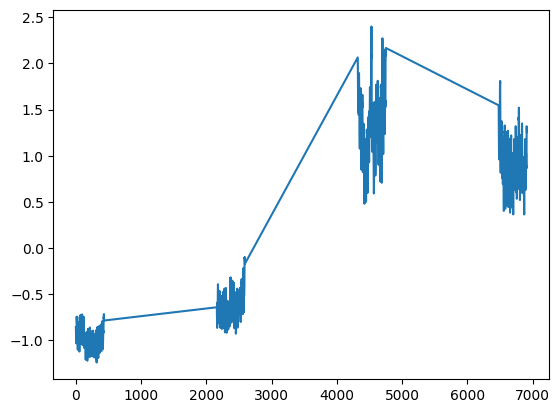

In [30]:
# plot consumption and temperature of bergen
y_test[X_test['city_number'] == 0].plot()

### Train model

In [31]:
import xgboost as xgb

In [32]:
# get dfs as numpy
X_train_np = X_train.to_numpy()
y_train_np = y_train.to_numpy()

print(X_train_np.shape)
print(y_train_np.shape)

# Create DMatrix for the current city
dtrain_city = xgb.DMatrix(X_train_np, label=y_train_np)

# Define XGBoost parameters for the current city's model
params = {
    'max_depth': 4,
    'eta': 0.5,
    'objective': 'reg:squarederror',
    'eval_metric': 'rmse'  # or 'mae' or another suitable metric for your task
}

# Train the model for the current city
xg_model = xgb.train(params, dtrain_city, num_boost_round=100)

(27840, 556)
(27840,)


In [33]:
X_test_np = X_test.to_numpy()
y_test_np = y_test.to_numpy()
print(X_test_np.shape, y_test_np.shape)

(8640, 556) (8640,)


### Get Predictions

In [34]:
# Create DMatrix for test set
dval_data = xgb.DMatrix(X_test_np)

# Predict using the trained model
xg_predictions = xg_model.predict(dval_data)

xg_truths = y_test_np
xg_truths.shape, xg_predictions.shape

((8640,), (8640,))

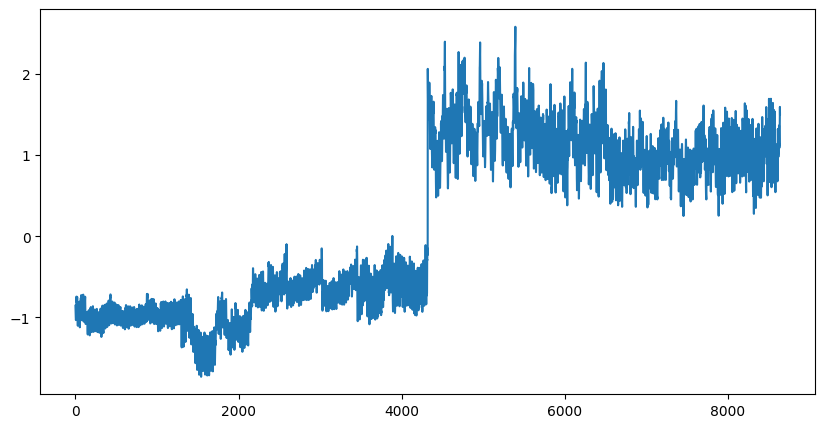

In [35]:
# check order of data (needed for reshaping below)
plt.figure(figsize=(10, 5))
plt.plot(xg_truths)

In [36]:
# NB: Quite tricky to get correct shapes!
# reshape the predictions
xg_predictions = np.transpose(xg_predictions.reshape(4, 5, -1), axes=(0, 2, 1))
# reshape the truths
xg_truths = np.transpose(xg_truths.reshape(4, 5, -1), axes=(0, 2, 1))

### Output Results

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\2449073212.py:40: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig_individual = plt.figure(figsize=(6, 4))


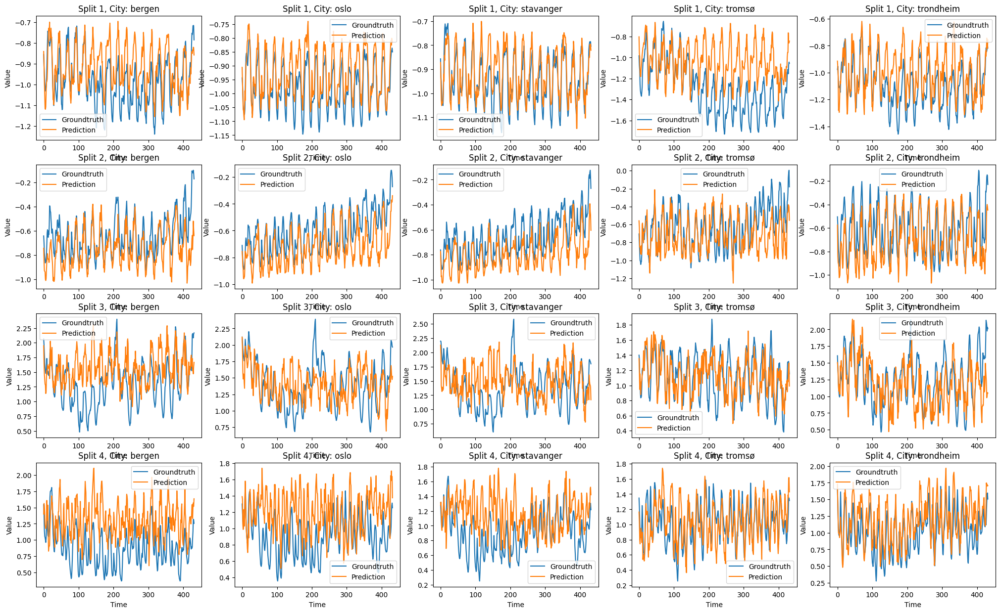

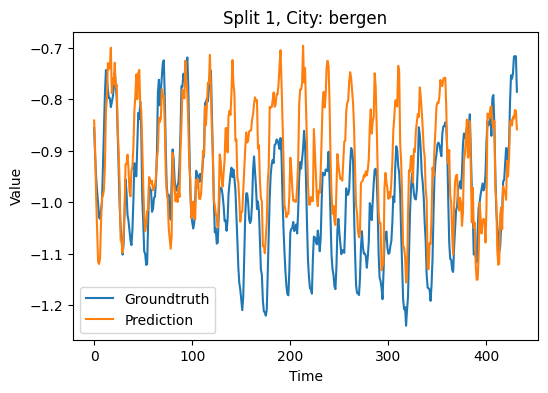

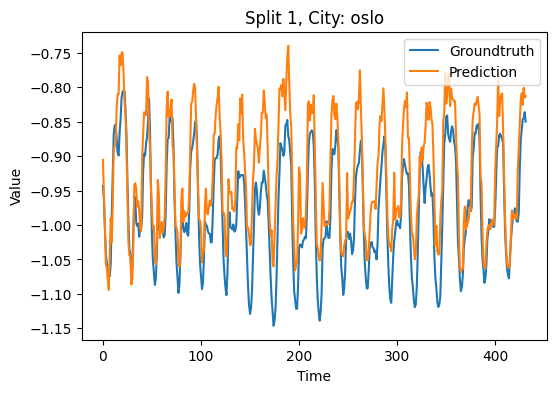

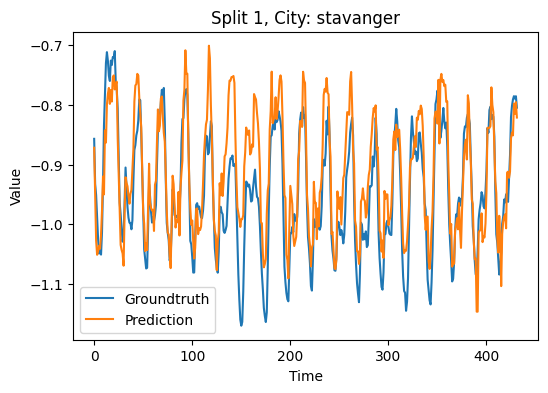

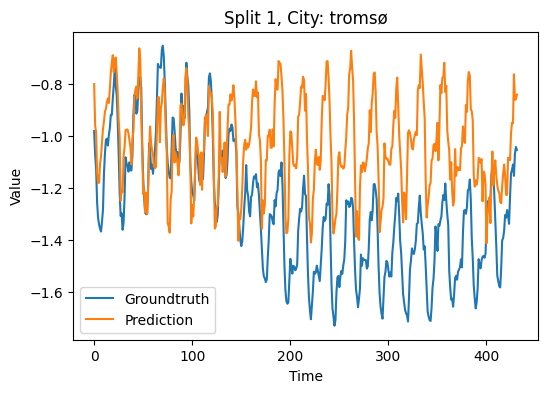

...

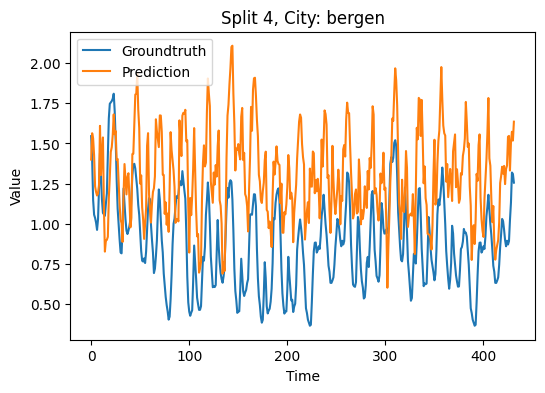

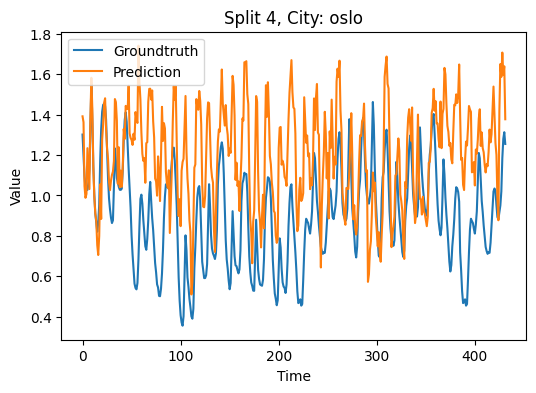

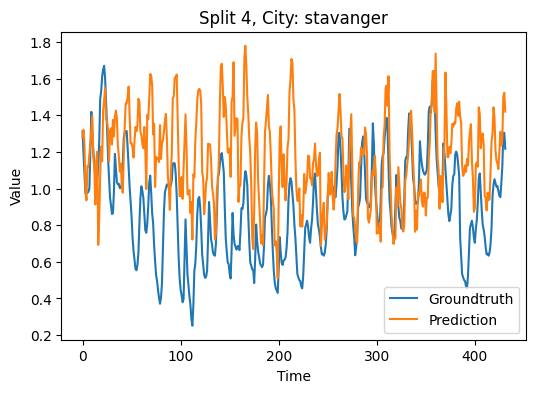

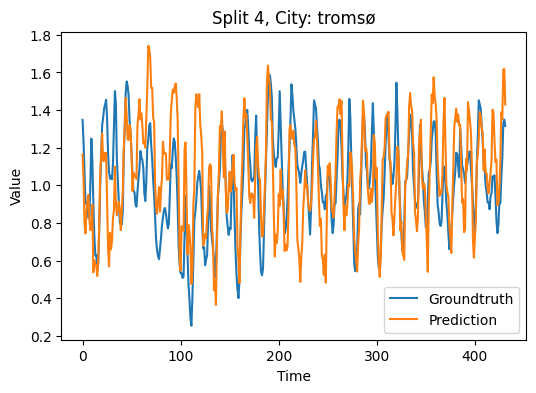

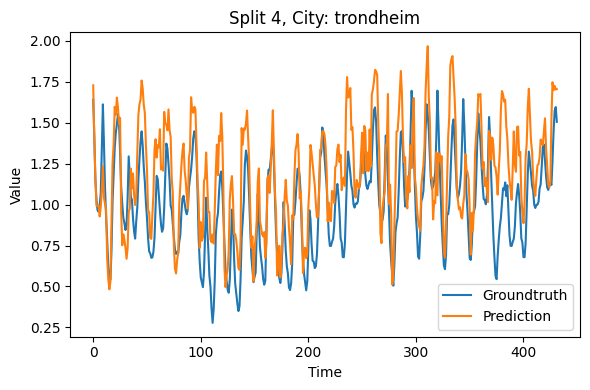

Metrics per City and Split:


,Split,City,MAE,MSE,RMSE,MAPE
0,1,1,0.090423,0.011265,0.106135,9.073141
1,1,2,0.051219,0.003679,0.060653,5.271281
2,1,3,0.049753,0.003836,0.061934,5.254755
3,1,4,0.272412,0.102057,0.319463,20.205669
4,1,5,0.122547,0.022714,0.150712,11.005018
5,2,1,0.125513,0.026311,0.162207,28.234715
6,2,2,0.125478,0.022765,0.150881,24.832029
7,2,3,0.134788,0.025288,0.159021,25.577462
8,2,4,0.149698,0.035739,0.189049,57.600914
9,2,5,0.128392,0.024743,0.157298,26.418256



Average Metrics per City Across Splits:


,City,Split,MAE,MSE,RMSE,MAPE
0,1,2.5,0.255143,0.121509,0.303422,33.438864
1,2,2.5,0.193720,0.072115,0.233001,23.903711
2,3,2.5,0.206069,0.083629,0.250541,25.355663
3,4,2.5,0.199969,0.061679,0.243695,29.212321
4,5,2.5,0.184868,0.058354,0.229061,21.518404



Overall Mean Metrics:
Mean MAE: 0.20795374240432216
Mean MSE: 0.07945736326804986
Mean RMSE: 0.251944040306397
Mean MAPE: 26.68579239659075


In [37]:
# Visualize and get metrics
visualize_and_get_metrics(splits=4, prediction=xg_predictions, truth=xg_truths)

## XGBoost per city

### Train Models

In [38]:
xg_models = []

for idx, city in enumerate(cities):
    print(f'Training model for {city}')
    # Get the data for the current city
    X_train_city = X_train[X_train["city_number"] == idx]
    y_train_city = y_train[X_train["city_number"] == idx]

    # Create DMatrix for the current city
    dtrain_city = xgb.DMatrix(X_train_city.to_numpy(), label=y_train_city)

    # Define XGBoost parameters for the current city's model
    params = {
        'max_depth': 4,
        'eta': 0.5,
        'objective': 'reg:squarederror',
        'eval_metric': 'rmse'  # or 'mae' or another suitable metric for your task
    }

    # Train the model for the current city
    xg_model = xgb.train(params, dtrain_city, num_boost_round=100)

    # Save the model
    xg_models.append(xg_model)

Training model for bergen
Training model for oslo
Training model for stavanger
Training model for tromsø
Training model for trondheim


### Get Predictions

In [39]:
xg_predictions = np.zeros((5, 1728))

for idx, city in enumerate(cities):
    # Get the data for the current city
    X_test_city = X_test[X_test["city_number"] == idx]

    # Create DMatrix for validation set of the current city
    dval_data = xgb.DMatrix(X_test_city.to_numpy())

    # Predict using the trained model
    xg_predictions[idx, :] = xg_models[idx].predict(dval_data)

### Output Results

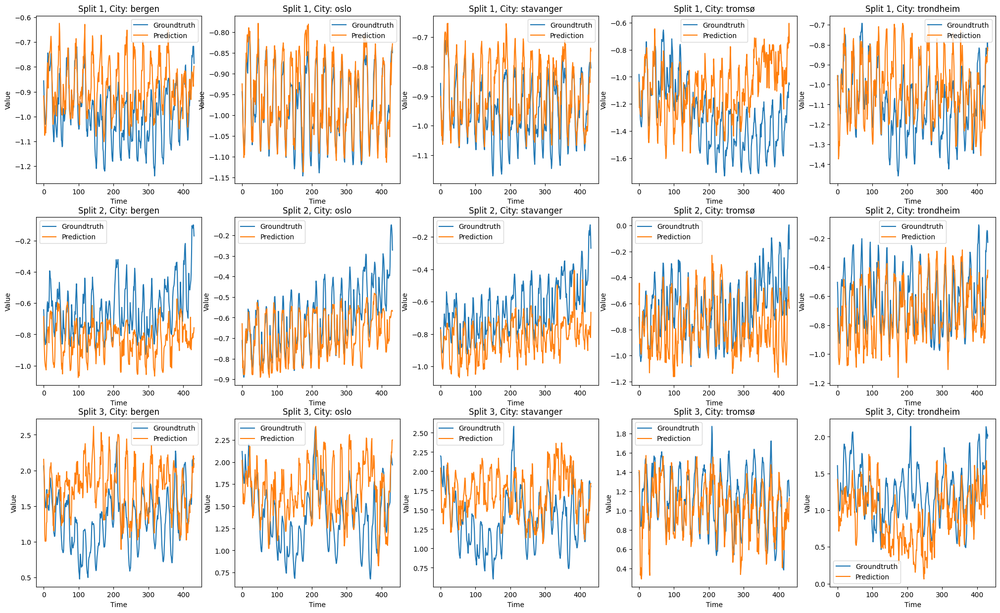

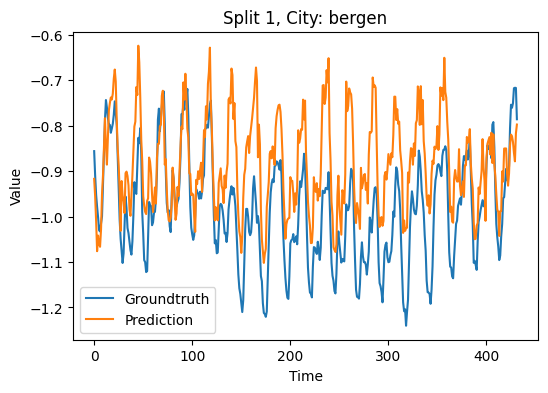

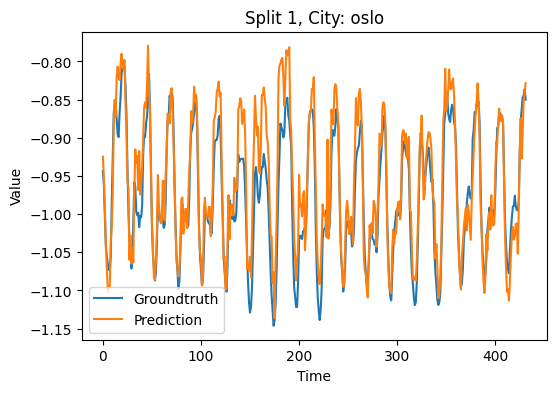

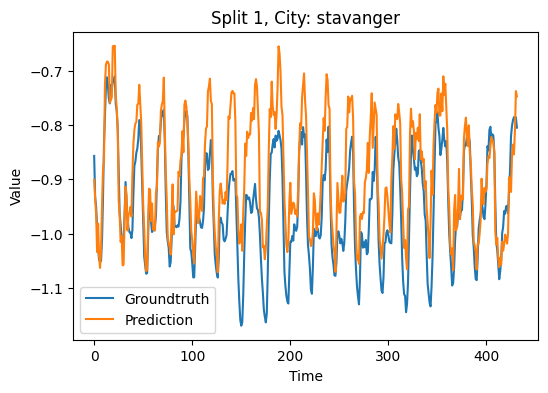

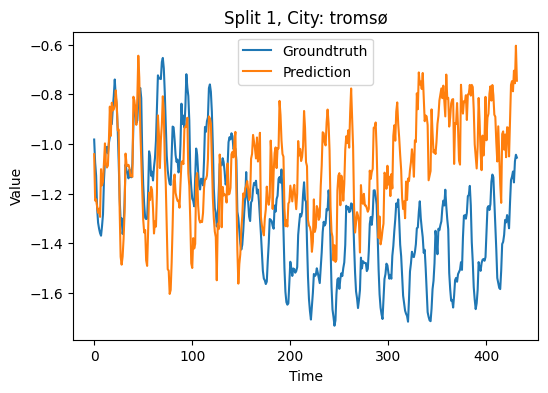

...

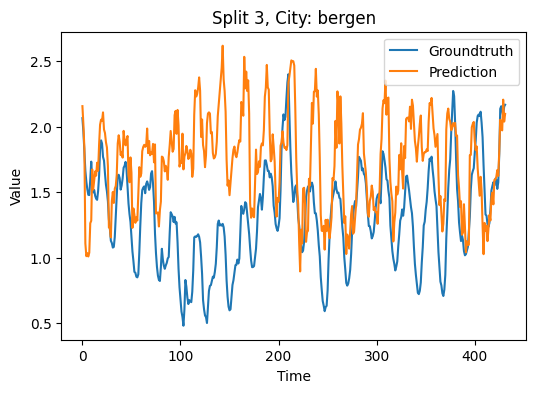

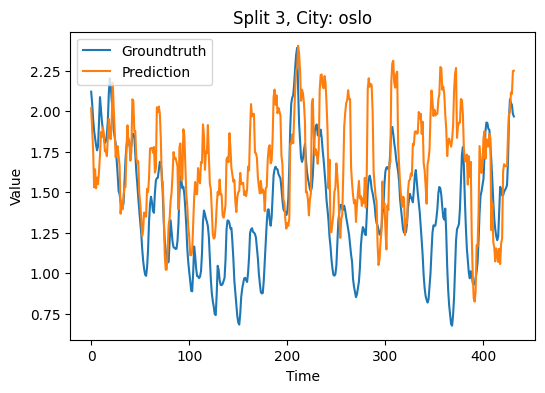

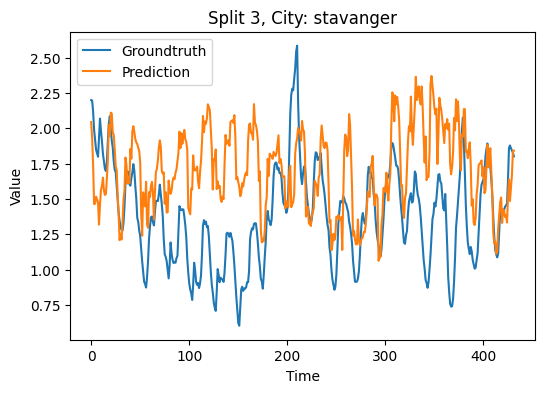

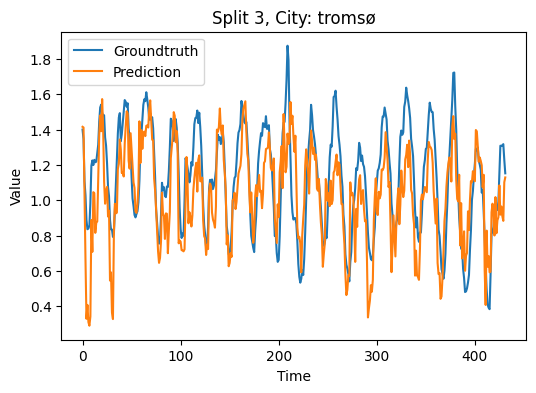

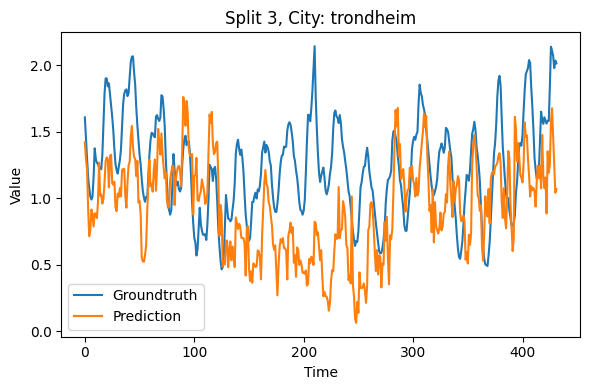

Metrics per City and Split:


,Split,City,MAE,MSE,RMSE,MAPE
0,1,1,0.111552,0.017128,0.130873,11.143939
1,1,2,0.029940,0.001509,0.038842,3.090999
2,1,3,0.063098,0.006044,0.077745,6.652158
3,1,4,0.281932,0.109824,0.331398,21.357340
4,1,5,0.124780,0.024371,0.156111,11.146799
5,2,1,0.192416,0.052835,0.229858,42.966096
6,2,2,0.086058,0.014052,0.118540,19.604407
7,2,3,0.165365,0.038426,0.196026,33.322854
8,2,4,0.196216,0.059626,0.244185,79.613138
9,2,5,0.135913,0.027386,0.165489,28.726457



Average Metrics per City Across Splits:


,City,Split,MAE,MSE,RMSE,MAPE
0,1,2.0,0.264297,0.143476,0.320373,33.694119
1,2,2.0,0.157492,0.068408,0.197628,17.684033
2,3,2.0,0.212838,0.099995,0.259752,25.073472
3,4,2.0,0.221776,0.073636,0.267475,39.632767
4,5,2.0,0.225327,0.098608,0.271877,24.731443



Overall Mean Metrics:
Mean MAE: 0.21634604619391826
Mean MSE: 0.09682446816985672
Mean RMSE: 0.26342091175991594
Mean MAPE: 28.163166772820766


In [40]:
xg_predictions_reshaped = np.transpose(xg_predictions.reshape(5, 4, -1), axes=(1, 2, 0))
# Visualize and get metrics
visualize_and_get_metrics(splits=3, prediction=xg_predictions_reshaped, truth=xg_truths)

## XGBoost all cities Kfold

### Setup

In [41]:
from sklearn.model_selection import TimeSeriesSplit, RandomizedSearchCV

In [42]:
X_train, y_train = get_X_y(train_val_tabulized_df)
X_test, y_test = get_X_y(test_tabulized_df)
X_test_np = X_test.to_numpy()
y_test_np = y_test.to_numpy()

### Do Random Search on TimeSeriesSplit

In [43]:
# get dfs as numpy
X_train_np = X_train.to_numpy()
y_train_np = y_train.to_numpy()

print(X_train_np.shape)
print(y_train_np.shape)

xg_model = xgb.XGBRegressor()

# Define XGBoost parameters for the current city's model
params = {
    'max_depth': [3, 4, 5, 6, 7],  # Maximum depth of a tree
    'learning_rate': [0.01, 0.05, 0.1, 0.2],  # Step size shrinkage
    'n_estimators': [50, 100, 200, 300],  # Number of boosting rounds
    'subsample': [0.5, 0.7, 0.9, 1],  # Subsample ratio of the training instances
    'colsample_bytree': [0.5, 0.7, 0.9, 1],  # Subsample ratio of columns when constructing each tree
    'gamma': [0, 0.1, 0.2, 0.3, 0.4],  # Minimum loss reduction required to make a further partition on a leaf node
    'reg_alpha': [0, 0.1, 0.5, 1],  # L1 regularization term on weights
    'reg_lambda': [1, 1.5, 2, 3]  # L2 regularization term on weights
}

# create a time series split
tscv = TimeSeriesSplit(n_splits=4)
# for scoring check: https://scikit-learn.org/stable/modules/model_evaluation.html#scoring-parameter
random_search = RandomizedSearchCV(xg_model, param_distributions=params, n_iter=20, scoring='neg_mean_absolute_error', n_jobs=-1, cv=tscv, verbose=3, random_state=42)

# Fit the random search model
random_search.fit(X_train_np, y_train_np)

# get the best model
best_xg_model = random_search.best_estimator_


(27840, 556)
(27840,)
Fitting 4 folds for each of 20 candidates, totalling 80 fits


In [44]:
# Get the parameters of the best model
best_xg_model.get_params()

{'objective': 'reg:squarederror',
 'base_score': None,
 'booster': None,
 'callbacks': None,
 'colsample_bylevel': None,
 'colsample_bynode': None,
 'colsample_bytree': 1,
 'device': None,
 'early_stopping_rounds': None,
 'enable_categorical': False,
 'eval_metric': None,
 'feature_types': None,
 'gamma': 0.2,
 'grow_policy': None,
 'importance_type': None,
 'interaction_constraints': None,
 'learning_rate': 0.01,
 'max_bin': None,
 'max_cat_threshold': None,
 'max_cat_to_onehot': None,
 'max_delta_step': None,
 'max_depth': 4,
 'max_leaves': None,
 'min_child_weight': None,
 'missing': nan,
 'monotone_constraints': None,
 'multi_strategy': None,
 'n_estimators': 300,
 'n_jobs': None,
 'num_parallel_tree': None,
 'random_state': None,
 'reg_alpha': 0,
 'reg_lambda': 2,
 'sampling_method': None,
 'scale_pos_weight': None,
 'subsample': 0.9,
 'tree_method': None,
 'validate_parameters': None,
 'verbosity': None}

### Get Predictions

In [45]:
# Predict using the trained model
xg_predictions = best_xg_model.predict(X_test_np)

xg_truths = y_test_np
xg_truths.shape, xg_predictions.shape

((8640,), (8640,))

In [46]:
# reshape the predictions
xg_predictions = np.transpose(xg_predictions.reshape(4, 5, -1), axes=(0, 2, 1))
# reshape the truths
xg_truths = np.transpose(xg_truths.reshape(4, 5, -1), axes=(0, 2, 1))

In [47]:
xg_predictions.shape, xg_truths.shape

((4, 432, 5), (4, 432, 5))

### Output Results

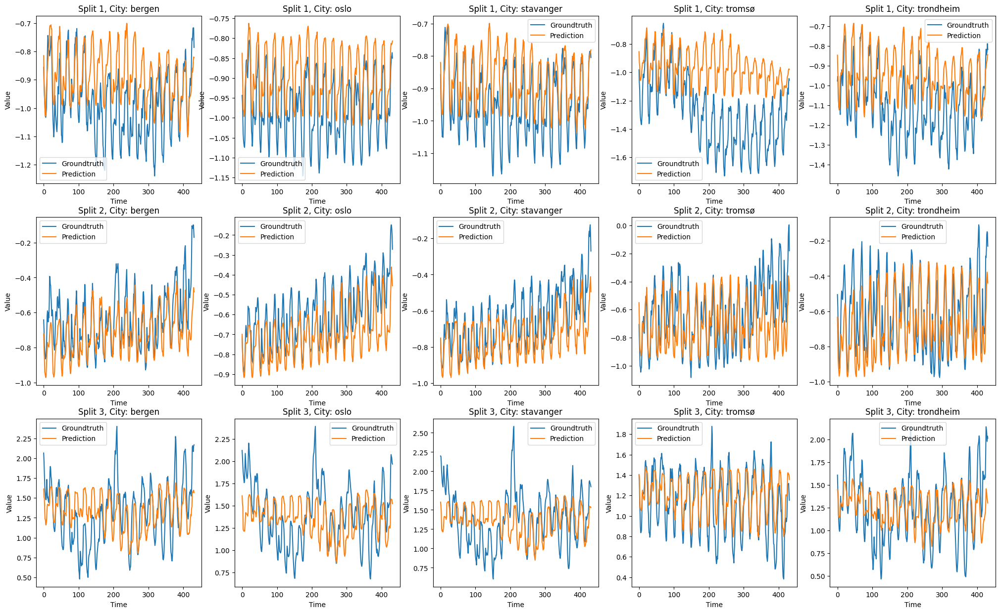

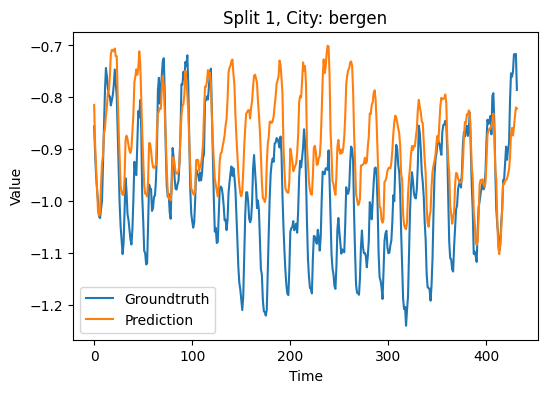

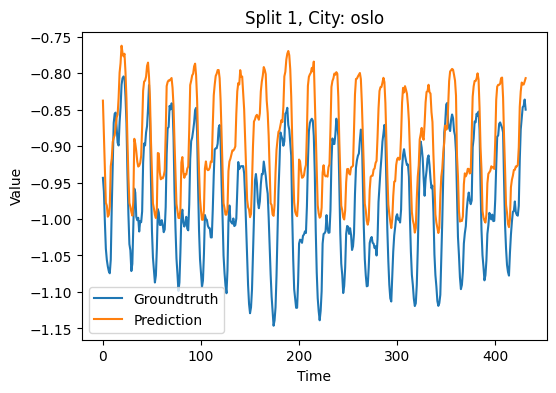

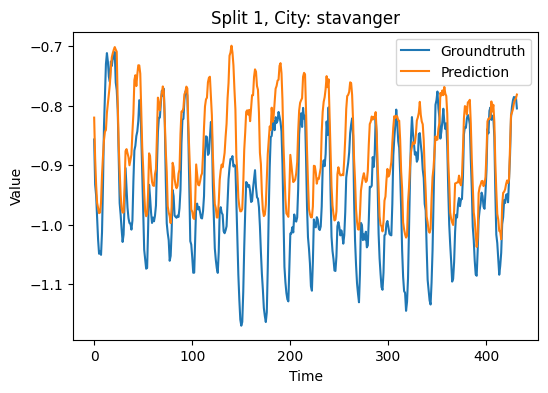

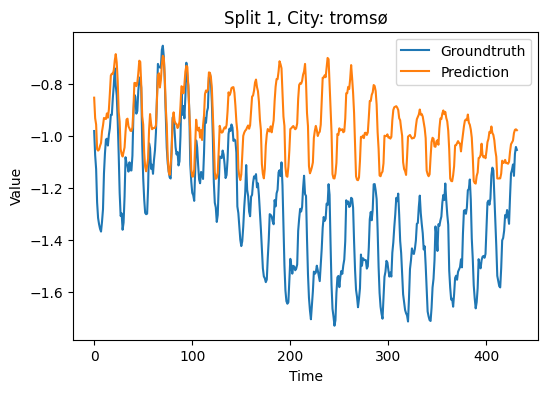

...

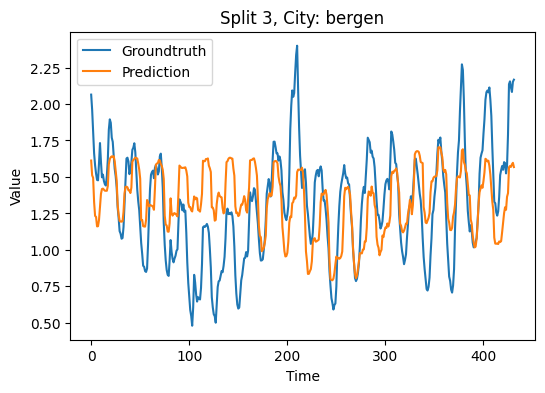

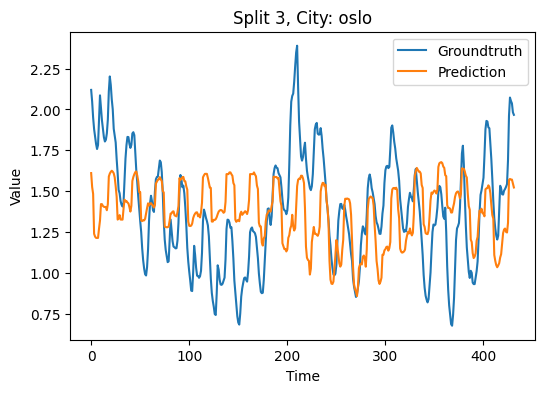

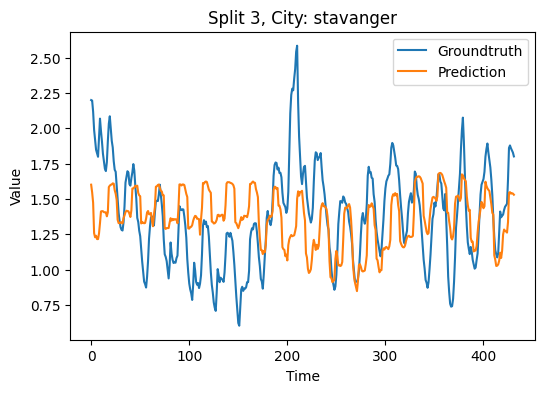

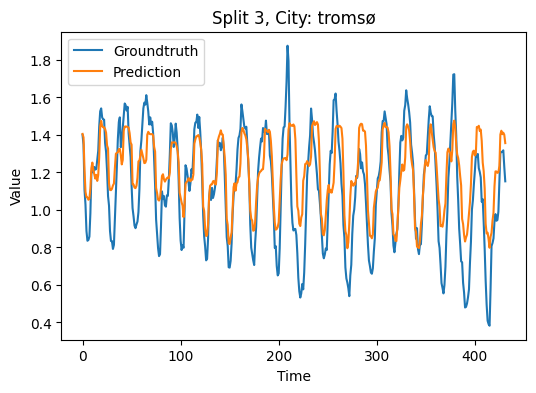

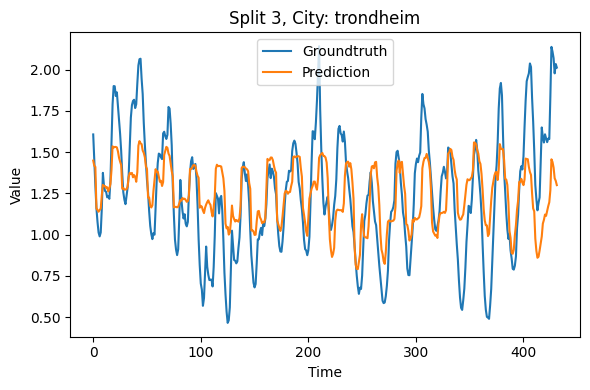

Metrics per City and Split:


,Split,City,MAE,MSE,RMSE,MAPE
0,1,1,0.106230,0.015993,0.126462,10.499625
1,1,2,0.081266,0.007438,0.086244,8.245021
2,1,3,0.073981,0.007503,0.086617,7.622318
3,1,4,0.320539,0.134267,0.366425,23.364527
4,1,5,0.159732,0.033992,0.184370,13.963471
5,2,1,0.097923,0.016997,0.130374,22.963762
6,2,2,0.101160,0.015907,0.126123,21.014179
7,2,3,0.097965,0.015961,0.126338,20.006244
8,2,4,0.143025,0.032146,0.179294,56.813522
9,2,5,0.110341,0.018777,0.137028,23.437322



Average Metrics per City Across Splits:


,City,Split,MAE,MSE,RMSE,MAPE
0,1,2.0,0.158982,0.048244,0.197039,19.357981
1,2,2.0,0.155301,0.045961,0.183601,17.101828
2,3,2.0,0.151294,0.047662,0.186225,16.559259
3,4,2.0,0.206308,0.068241,0.247149,32.421894
4,5,2.0,0.164426,0.043655,0.200345,19.381479



Overall Mean Metrics:
Mean MAE: 0.16726226379708295
Mean MSE: 0.050752793256055945
Mean RMSE: 0.2028717619287011
Mean MAPE: 20.96448831571407


In [48]:
# Visualize and get metrics
visualize_and_get_metrics(splits=3, prediction=xg_predictions, truth=xg_truths)

# Model 3: RNN-types: LSTM

## Setup Sequential

For RNNs (LSTM), and our modified Transformer model we need Sequence data.

We input sequences of 9 days at a time and inject the projected forecast.

In [52]:
df.head()

,bergen_consumption,oslo_consumption,stavanger_consumption,tromsø_consumption,trondheim_consumption,bergen_temp,oslo_temp,stavanger_temp,tromsø_temp,trondheim_temp,hour,weekday
time,,,,,,,,,,,,
2022-04-07 21:00:00,-0.660391,-0.595758,-0.590128,-0.168468,-0.271248,-1.227807,-0.728916,-1.241145,-0.930639,-1.183463,21.0,3.0
2022-04-07 22:00:00,-0.714890,-0.654558,-0.655851,-0.286978,-0.386136,-1.182052,-0.797328,-1.326767,-0.980848,-1.249112,22.0,3.0
2022-04-07 23:00:00,-0.750819,-0.688184,-0.701877,-0.360968,-0.466829,-1.258311,-0.808730,-1.275394,-1.081266,-1.314761,23.0,3.0
2022-04-08 00:00:00,-0.772093,-0.704646,-0.720685,-0.357688,-0.505958,-1.349822,-0.820132,-1.275394,-1.156579,-1.367279,0.0,4.0
2022-04-08 01:00:00,-0.801390,-0.712036,-0.738556,-0.358079,-0.513762,-1.288814,-0.797328,-1.292518,-0.930639,-1.354150,1.0,4.0


In [53]:
train_val_times.shape, test_times.shape

((4, 1728), (4, 432))

In [56]:
import datetime
def create_sequential_data_vectorized(df, times, sequence_length, is_train):
    start_offset = 0 if is_train else -24 * 14
    num_features = df.shape[1]
    split_length = times.shape[1]
    num_splits = times.shape[0]
    gap = 24 * 5

    # Compute the number of sequences
    num_sequences = (split_length - start_offset - gap - sequence_length) * num_splits
    print(f'Number of sequences: {num_sequences}')
    
    # Pre-allocate the arrays for efficiency
    sequences = np.zeros((num_sequences, sequence_length, num_features))
    next_parts = np.zeros((num_sequences, gap, num_features))
    print(f'Sequences shape: {sequences.shape}')
    print(f'Next parts shape: {next_parts.shape}')

    idx = 0
    for split in range(num_splits):
        time_step = times[split, 0]
        if not is_train:
            time_step = time_step - np.timedelta64(datetime.timedelta(hours=-start_offset), 's')
        time_series = time_step + np.arange(num_sequences / num_splits) * np.timedelta64(1, 'h')
        for time_ in time_series:
            # Get the time step
            time_step_plus_sequence = time_ + np.timedelta64(datetime.timedelta(hours=sequence_length), 's')
            time_step_plus_sequence_gap = time_step_plus_sequence + np.timedelta64(datetime.timedelta(hours=gap), 's')
            # Adjust the slicing to get the correct shape
            sequences[idx] = df.loc[time_:time_step_plus_sequence - 1].values
            next_parts[idx] = df.loc[time_step_plus_sequence:time_step_plus_sequence_gap - 1].values
            idx += 1

    return sequences, next_parts

def sequencize_data_vectorized(df, train_val_times, test_times):
    train_val_sequences, train_val_nexts = create_sequential_data_vectorized(df, train_val_times, 216, True)
    test_sequences, test_nexts = create_sequential_data_vectorized(df, test_times, 216, False)
    return train_val_sequences, train_val_nexts, test_sequences, test_nexts

# Example usage
# Assuming df, train_val_times, test_times are defined
train_val_sequencized, train_val_sequencized_nexts, test_sequencized, test_sequencized_nexts = sequencize_data_vectorized(df, train_val_times, test_times)

Number of sequences: 5568
Sequences shape: (5568, 216, 12)
Next parts shape: (5568, 120, 12)


Number of sequences: 1728
Sequences shape: (1728, 216, 12)
Next parts shape: (1728, 120, 12)


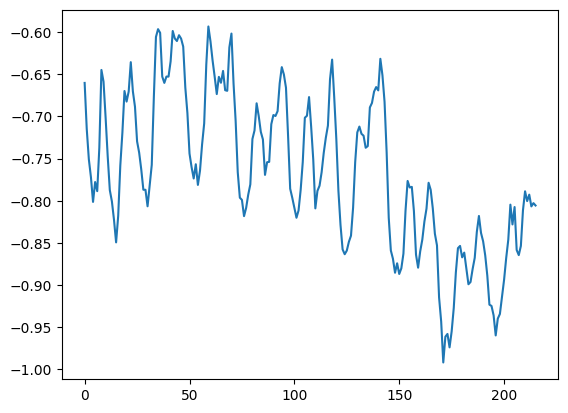

In [57]:
# plot bergen consumption
plt.plot(train_val_sequencized[0, :, 0])

Days seems to line up

Function to count parameters

In [58]:
def count_parameters(model):
    total_params = sum(p.numel() for p in model.parameters())
    trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    return total_params, trainable_params

## LSTM-1 Per city

### Setup Model

In [59]:
import torch
import torch.nn as nn
import torch.optim as optim

class TimeSeriesLSTM(nn.Module):
    def __init__(self, input_size=12, hidden_size=64, num_layers=1, output_size=1):
        super(TimeSeriesLSTM, self).__init__()
        self.num_layers = num_layers
        self.hidden_size = hidden_size
        
        self.lstm = nn.LSTM(input_size=input_size, 
                            hidden_size=hidden_size, 
                            num_layers=num_layers, 
                            batch_first=True)
        
        self.linear = nn.Linear(hidden_size, output_size)
        
    def forward(self, x, verbose=False): #hidden=None, 
        # Input x shape: (batch_size, sequence_length, input_size)
        
        # If no hidden state is provided, initialize to zero. 
        # This seemed to not make a difference in the results.
        # if hidden is None:
        #     batch_size = x.size(0)
        #     hidden = (torch.zeros(self.num_layers, batch_size, self.hidden_size).to(x.device),
        #             torch.zeros(self.num_layers, batch_size, self.hidden_size).to(x.device))
        
        # LSTM
        out, _ = self.lstm(x)  # out shape: (batch_size, sequence_length, hidden_size)

        if verbose:
            print('1:', out.shape)
        
        # Take the relevant steps from the LSTM output
        out = out[:, :, :]

        if verbose:
            print('2:', out.shape)
        
        # Linear layer to get the output
        out = self.linear(out)  # out shape: (batch_size, 4, output_size)

        # out = out[:, :, -1:]
        # out = out.view(-1, 1, 216)

        if verbose:
            print('3:',out.shape)
        
        return out
    
model = TimeSeriesLSTM()
total_params, trainable_params = count_parameters(model)
print(f"Total parameters: {total_params}")
print(f"Trainable parameters: {trainable_params}")

Total parameters: 20033
Trainable parameters: 20033


In [60]:
model = TimeSeriesLSTM().to('cuda')
model.train()
optimizer = optim.Adam(model.parameters(), lr=0.001)
input = torch.randn(100, 216, 12, device='cuda')
out = model(input, verbose=True)

1: torch.Size([100, 216, 64])
2: torch.Size([100, 216, 64])
3: torch.Size([100, 216, 1])


### Setup dataset

In [61]:
from torch.utils.data import Dataset, DataLoader

class TimeSeriesDataset(Dataset):
    def __init__(self, X, y):
        self.X = torch.tensor(X, dtype=torch.float32)
        self.y = torch.tensor(y, dtype=torch.float32)

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

# Set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Get data as tensors
train_X = torch.tensor(train_val_sequencized, dtype=torch.float32).to(device)
train_y = torch.tensor(train_val_sequencized_nexts, dtype=torch.float32).to(device)
test_X = torch.tensor(test_sequencized, dtype=torch.float32).to(device)
test_y = torch.tensor(test_sequencized_nexts, dtype=torch.float32).to(device)

### Train model

In [62]:
# Try to predict each city separately
criterion = nn.MSELoss()
lr = 0.0005
batch_size = 128
epochs = 20

# Training loop
def train_model_per_city(model, train_loader, criterion, optimizer, epochs, city_num):
    model.train()
    for epoch in range(epochs):
        for batch_X, batch_y in train_loader:
            batch_X, batch_y = batch_X.to(device), batch_y.to(device)
            optimizer.zero_grad()
            outputs = model(batch_X)[:, :120, 0]

            loss = criterion(outputs, batch_y)
            loss.backward()
            optimizer.step()
        
        if (epoch + 1) % 2 == 0:
            print(f'Epoch [{epoch+1}/{epochs}], Loss: {loss.item():.4f}')

# Train the models
models = []
print(train_X.shape)
print(train_y[:, :, 0].shape)
for i in range(5):
    # Instantiate dataset
    train_dataset = TimeSeriesDataset(train_X, train_y[:, :, i])
    # Instantiate data loader
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

    print(f"Training model for city {i+1}")
    model = TimeSeriesLSTM().to(device)
    optimizer = optim.Adam(model.parameters(), lr=lr)
    train_model_per_city(model, train_loader, criterion, optimizer, epochs=epochs, city_num=i)
    models.append(model)

torch.Size([5568, 216, 12])
torch.Size([5568, 120])
Training model for city 1


C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\3085534986.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X, dtype=torch.float32)
C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\3085534986.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y, dtype=torch.float32)


Epoch [2/20], Loss: 0.1119
Epoch [4/20], Loss: 0.0824
Epoch [6/20], Loss: 0.0489
Epoch [8/20], Loss: 0.0342
Epoch [10/20], Loss: 0.0285
Epoch [12/20], Loss: 0.0310
Epoch [14/20], Loss: 0.0276
Epoch [16/20], Loss: 0.0237
Epoch [18/20], Loss: 0.0178
Epoch [20/20], Loss: 0.0232
Training model for city 2
Epoch [2/20], Loss: 0.0698
Epoch [4/20], Loss: 0.0445
Epoch [6/20], Loss: 0.0468
Epoch [8/20], Loss: 0.0405
Epoch [10/20], Loss: 0.0305
Epoch [12/20], Loss: 0.0370
Epoch [14/20], Loss: 0.0307
Epoch [16/20], Loss: 0.0271
Epoch [18/20], Loss: 0.0186
Epoch [20/20], Loss: 0.0192
Training model for city 3
Epoch [2/20], Loss: 0.1071
Epoch [4/20], Loss: 0.0563
Epoch [6/20], Loss: 0.0596
Epoch [8/20], Loss: 0.0449
Epoch [10/20], Loss: 0.0218
Epoch [12/20], Loss: 0.0299
Epoch [14/20], Loss: 0.0250
Epoch [16/20], Loss: 0.0223
Epoch [18/20], Loss: 0.0228
Epoch [20/20], Loss: 0.0216
Training model for city 4
Epoch [2/20], Loss: 0.1072
Epoch [4/20], Loss: 0.0998
Epoch [6/20], Loss: 0.0829
Epoch [8/20],

### Get predictions on test-set

In [63]:
# Assuming test_X is your test data and has the same format as your training data
def get_predictions_per_city(models, test_X):
    predictions = []
    with torch.no_grad():  # No need to track gradients during prediction
        for model_idx, model in enumerate(models):
            model.eval()  # Set the model to evaluation mode
            city_predictions = []
            output = model(test_X)[:, -1:, 0]  # Adjust this line if needed
            city_predictions.append(output.cpu().numpy())
            city_predictions = np.concatenate(city_predictions, axis=0)
            predictions.append(city_predictions)
    return predictions

# Get predictions
all_city_predictions = get_predictions_per_city(models, test_X)

# Convert to NumPy array
all_city_predictions = np.array(all_city_predictions)
all_city_predictions.shape

(5, 1728, 1)

In [67]:
lstm1_preds = all_city_predictions[:, :, 0].reshape(5, 4, -1).transpose(1, 2, 0)
lstm1_preds.shape, xg_truths.shape

((4, 432, 5), (4, 432, 5))

### Output results

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\2449073212.py:40: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig_individual = plt.figure(figsize=(6, 4))


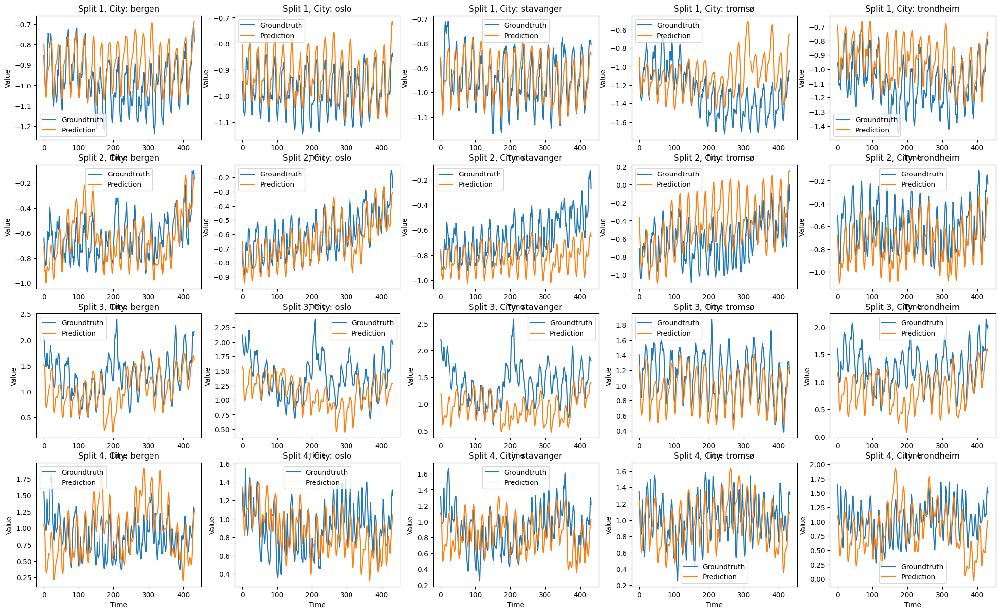

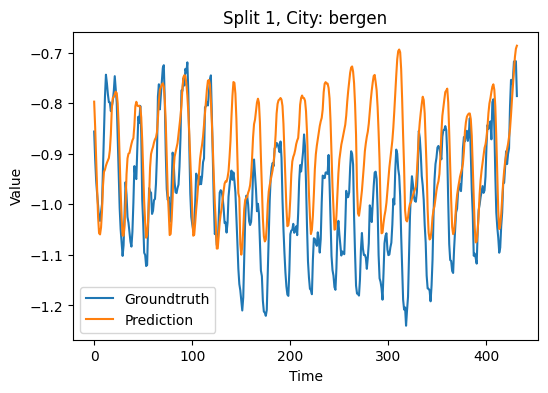

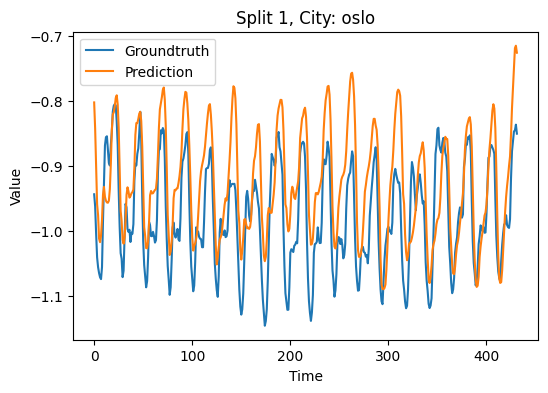

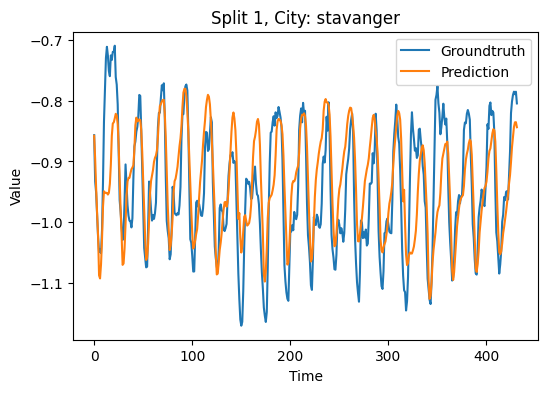

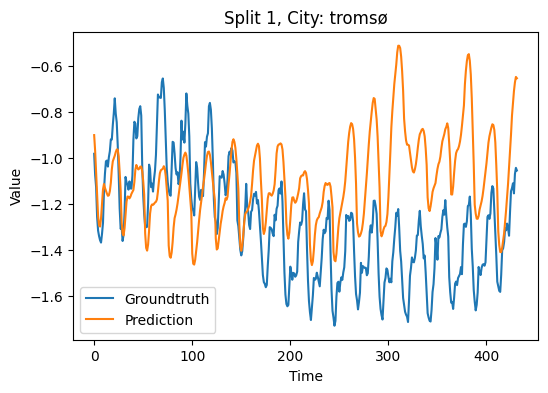

...

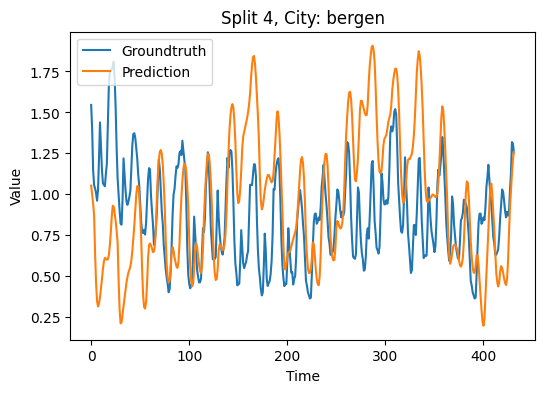

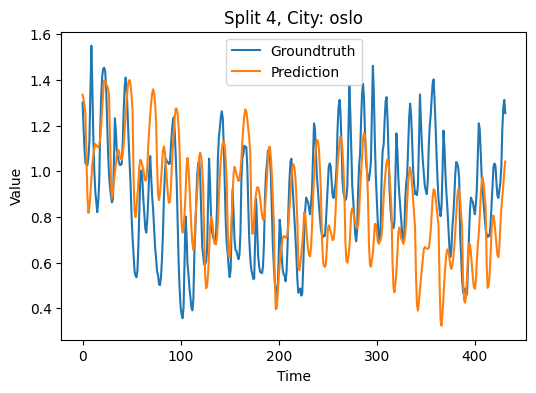

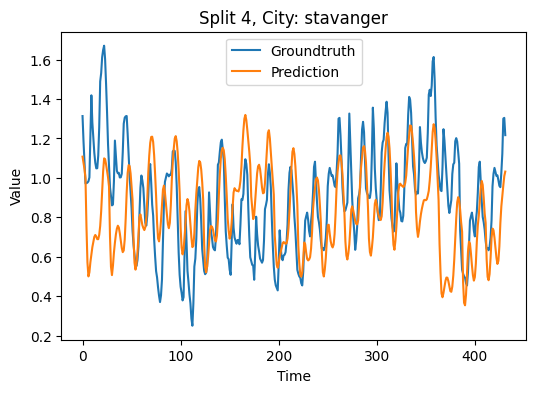

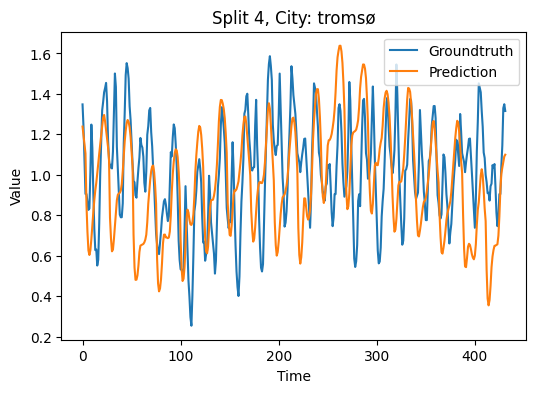

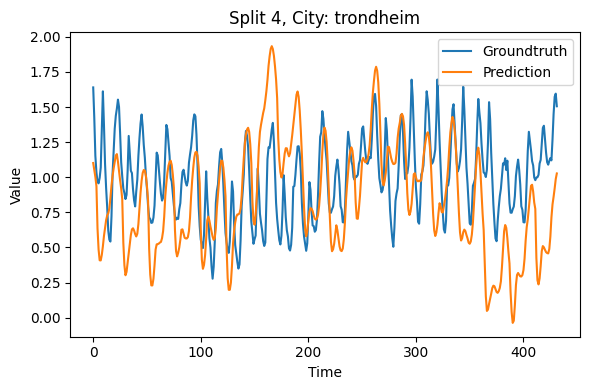

Metrics per City and Split:


,Split,City,MAE,MSE,RMSE,MAPE
0,1,1,0.099115,0.015307,0.123723,9.768419
1,1,2,0.065913,0.005900,0.076811,6.745973
2,1,3,0.058293,0.005451,0.073833,6.283261
3,1,4,0.280430,0.113138,0.336360,21.621493
4,1,5,0.159248,0.036720,0.191625,14.022685
5,2,1,0.142776,0.029358,0.171341,25.354461
6,2,2,0.086142,0.011515,0.107309,16.846395
7,2,3,0.173015,0.042514,0.206189,34.299680
8,2,4,0.247268,0.087525,0.295847,52.221491
9,2,5,0.155958,0.035596,0.188669,32.428410



Average Metrics per City Across Splits:


,City,Split,MAE,MSE,RMSE,MAPE
0,1,2.5,0.233770,0.112326,0.298590,25.930176
1,2,2.5,0.184483,0.074218,0.226805,18.769975
2,3,2.5,0.229650,0.115959,0.284613,24.424820
3,4,2.5,0.245682,0.091933,0.302516,29.646762
4,5,2.5,0.273471,0.134278,0.335049,29.358410



Overall Mean Metrics:
Mean MAE: 0.23341100660412312
Mean MSE: 0.10574272029935616
Mean RMSE: 0.28951453262415605
Mean MAPE: 25.626028511377438


In [68]:
visualize_and_get_metrics(splits=4, prediction=lstm1_preds, truth=xg_truths)

## LSTM-1 1 model 

### Reuse same LSTM model, but different output size

In [69]:
  
model = TimeSeriesLSTM(output_size=5)
total_params, trainable_params = count_parameters(model)
print(f"Total parameters: {total_params}")
print(f"Trainable parameters: {trainable_params}")

Total parameters: 20293
Trainable parameters: 20293


In [70]:
model = TimeSeriesLSTM(output_size=5).to('cuda')
model.train()
optimizer = optim.Adam(model.parameters(), lr=0.001)
input = torch.randn(100, 216, 12, device='cuda')
out = model(input, verbose=True)

1: torch.Size([100, 216, 64])
2: torch.Size([100, 216, 64])
3: torch.Size([100, 216, 5])


In [71]:
train_X.shape, train_y.shape

(torch.Size([5568, 216, 12]), torch.Size([5568, 120, 12]))

### Train model

In [72]:
# Try to predict each city separately

# NB This can either be trained to predict the whole next sequence (:120), or just for the hour in question (119).
# Did not see much difference in performance.

# Training loop
def train_model_sequential(model, criterion, optimizer, epochs, batch_size):
    train_dataset = TimeSeriesDataset(train_X, train_y[:, :120, :5])
    # Instantiate data loader
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    model.train()
    for epoch in range(epochs):
        for batch_X, batch_y in train_loader:
            batch_X, batch_y = batch_X.to(device), batch_y.to(device)
            optimizer.zero_grad()
            outputs = model(batch_X)[:, :120, :5]
            # print(outputs.shape)
            # print(batch_y.shape)
            loss = criterion(outputs, batch_y)
            loss.backward()
            optimizer.step()
        
        if (epoch + 1) % 5 == 0:
            print(f'Epoch [{epoch+1}/{epochs}], Loss: {loss.item():.4f}')

# Train the model
lstm_model1 = TimeSeriesLSTM(hidden_size=128, output_size=5).to(device)
lstm_optimizer1 = optim.Adam(lstm_model1.parameters(), lr=0.0003)
train_model_sequential(lstm_model1, nn.MSELoss(), lstm_optimizer1, epochs=50, batch_size=256)

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\3085534986.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X, dtype=torch.float32)
C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\3085534986.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y, dtype=torch.float32)


Epoch [5/50], Loss: 0.0954
Epoch [10/50], Loss: 0.0661
Epoch [15/50], Loss: 0.0707
Epoch [20/50], Loss: 0.0439
Epoch [25/50], Loss: 0.0400
Epoch [30/50], Loss: 0.0355
Epoch [35/50], Loss: 0.0338
Epoch [40/50], Loss: 0.0307
Epoch [45/50], Loss: 0.0273
Epoch [50/50], Loss: 0.0268


### Get predictions

In [73]:
# Assuming test_X is your test data and has the same format as your training data
def get_predictions_sequential(model, test_X):
    with torch.no_grad():  # No need to track gradients during prediction
        model.eval()  # Set the model to evaluation mode
        city_predictions = []
        print(test_X.shape)
        output = model(test_X)[:, 120, :]  # Adjust this line if needed
        print(output.shape)
        city_predictions.append(output.cpu().numpy())
        city_predictions = np.concatenate(city_predictions, axis=0)
    return np.array(city_predictions).reshape(4, -1, 5)

# Get predictions
all_city_predictions_lstm1 = get_predictions_sequential(lstm_model1, test_X)
all_city_predictions_lstm1.shape

torch.Size([1728, 216, 12])
torch.Size([1728, 5])


(4, 432, 5)

### Output results

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\2449073212.py:40: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig_individual = plt.figure(figsize=(6, 4))


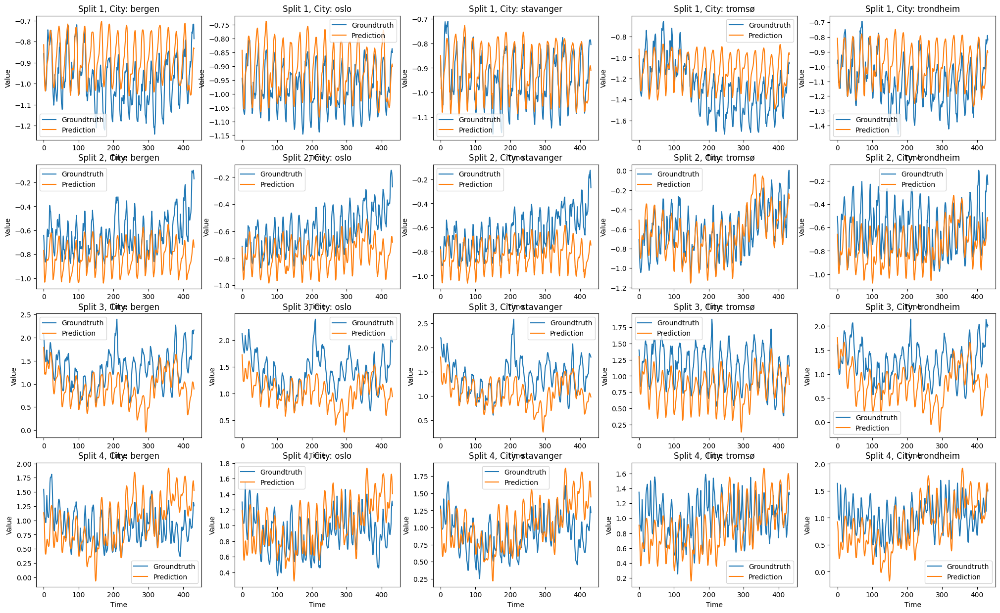

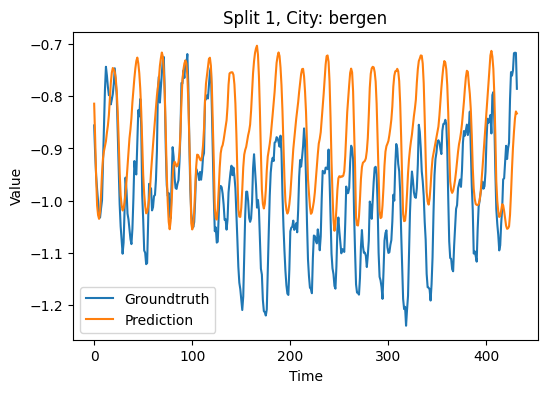

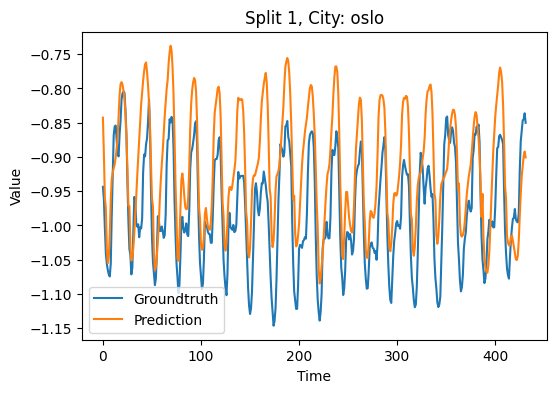

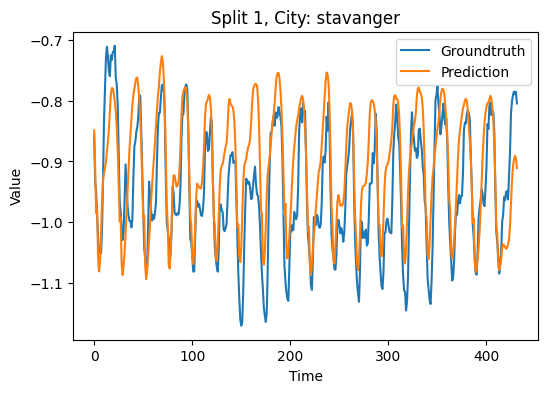

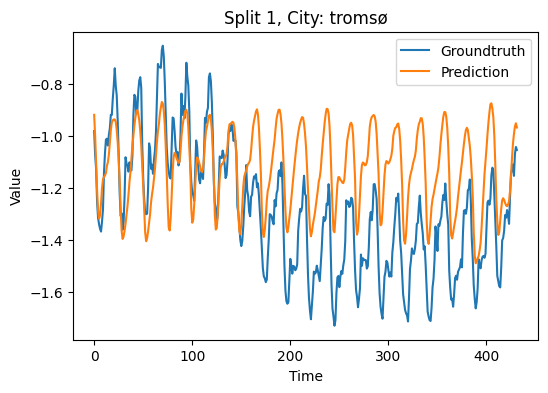

...

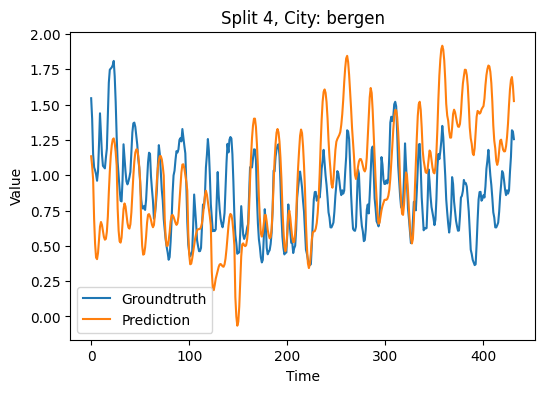

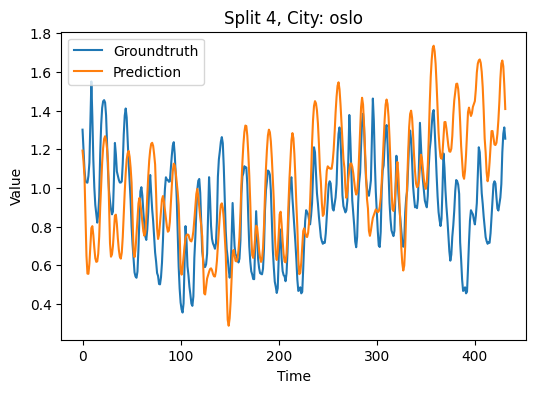

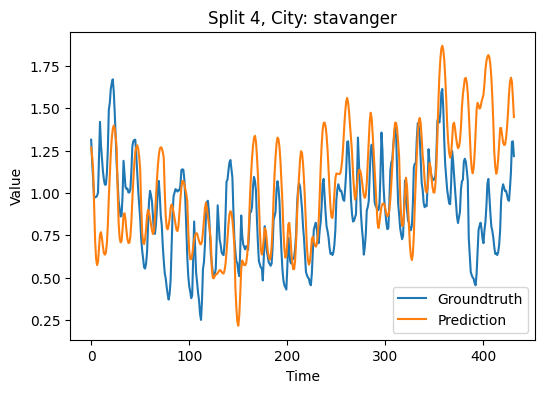

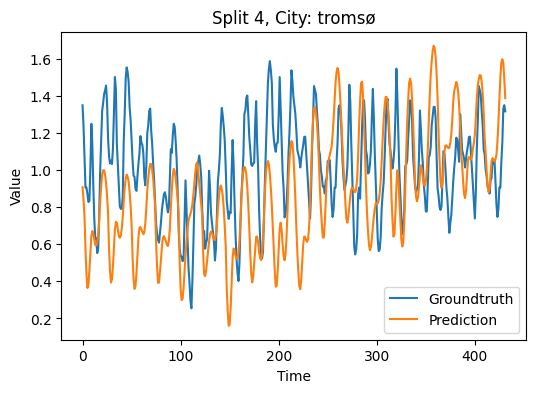

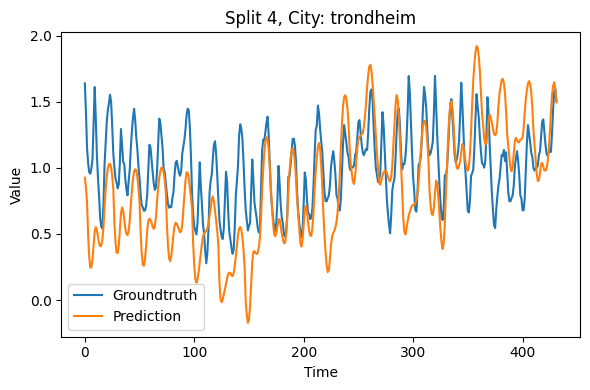

Metrics per City and Split:


,Split,City,MAE,MSE,RMSE,MAPE
0,1,1,0.116811,0.018528,0.136118,11.663285
1,1,2,0.068751,0.006219,0.078859,7.048109
2,1,3,0.060554,0.005552,0.074513,6.419674
3,1,4,0.212054,0.060935,0.246851,16.032035
4,1,5,0.135008,0.025674,0.160231,11.961210
5,2,1,0.175697,0.046115,0.214743,39.015510
6,2,2,0.166585,0.037926,0.194747,34.655008
7,2,3,0.170334,0.043417,0.208366,34.351348
8,2,4,0.121173,0.023936,0.154713,38.862344
9,2,5,0.168043,0.039474,0.198680,37.182779



Average Metrics per City Across Splits:


,City,Split,MAE,MSE,RMSE,MAPE
0,1,2.5,0.260656,0.125436,0.319499,30.444219
1,2,2.5,0.216493,0.088777,0.260206,24.395796
2,3,2.5,0.211272,0.090536,0.265877,24.421440
3,4,2.5,0.234480,0.083581,0.276895,28.095663
4,5,2.5,0.278776,0.135220,0.328765,31.122295



Overall Mean Metrics:
Mean MAE: 0.2403354341251606
Mean MSE: 0.10471028760592929
Mean RMSE: 0.29024840763918386
Mean MAPE: 27.695882702028012


In [74]:
visualize_and_get_metrics(splits=4, prediction=all_city_predictions_lstm1, truth=xg_truths)

## Dual-Input LSTM

### Setup Model

In [75]:
class DualInputLSTM(nn.Module):
    def __init__(self, consumption_size, temperature_size, hidden_layer_size, output_size):
        super(DualInputLSTM, self).__init__()
        
        # LSTM for consumption data
        self.lstm_consumption = nn.LSTM(consumption_size, hidden_layer_size, batch_first=True)
        
        # LSTM for temperature data
        self.lstm_temperature_plus = nn.LSTM(temperature_size, hidden_layer_size, batch_first=True)
        
        # Linear layer to combine the outputs of the two LSTMs
        self.linear = nn.Linear(hidden_layer_size * 2, output_size)
    
    def forward(self, consumption_seq, temperature_seq, verbose=False):
        # Process each sequence through its respective LSTM
        lstm_out_consumption, _ = self.lstm_consumption(consumption_seq)
        lstm_out_temperature, _ = self.lstm_temperature_plus(temperature_seq)

        if verbose:
            print('1:', lstm_out_consumption.shape)
            print('2:', lstm_out_temperature.shape)
        
        # Concatenate the final outputs of each LSTM
        combined = torch.cat((lstm_out_consumption[:, :, :], lstm_out_temperature[:, :216, :]), 2)

        if verbose:
            print('3:', combined.shape)
        
        # Make predictions based on the combined output
        predictions = self.linear(combined)

        if verbose:
            print('4:', predictions.shape)
        return predictions

model = DualInputLSTM(5, 7, 64, 5)
total_params, trainable_params = count_parameters(model)
print(f"Total parameters: {total_params}")
print(f"Trainable parameters: {trainable_params}")

Total parameters: 37509
Trainable parameters: 37509


In [76]:
model = DualInputLSTM(5, 7, 64, 5).to('cuda')
model.train()
optimizer = optim.Adam(model.parameters(), lr=0.001)
input_con = torch.randn(100, 216, 5, device='cuda')
input_rest = torch.randn(100, 336, 7, device='cuda')
out = model(input_con, input_rest, verbose=True)

1: torch.Size([100, 216, 64])
2: torch.Size([100, 336, 64])
3: torch.Size([100, 216, 128])
4: torch.Size([100, 216, 5])


### Train Model

In [77]:
# NB This can either be trained to predict the whole next sequence, or just for the hour in question.
# Did not see much difference in performance.

# Training loop for double input
def train_model_sequential_dual(model, train_loader, criterion, optimizer, epochs, batch_size):
    train_dataset = TimeSeriesDataset(train_X, train_y)
    # Instantiate data loader
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    model.train()
    for epoch in range(epochs):
        for batch_X, batch_y in train_loader:
            batch_X, batch_y = batch_X.to(device), batch_y.to(device)
            optimizer.zero_grad()
            # print('x',batch_X.shape)
            # print('y',batch_y.shape)
            consumption_inputs = batch_X[:, :, :5]
            # print(consumption_inputs.shape)
            rest_inputs = torch.cat((batch_X[:, :, 5:], batch_y[:, :, 5:]), 1)
            # print(rest_inputs.shape)
            outputs = model(consumption_inputs,rest_inputs)[:, :120, :]
            # print('o',outputs.shape)
            # print('by',batch_y.shape)
            loss = criterion(outputs, batch_y[:, :120, :5])
            loss.backward()
            optimizer.step()
        
        if (epoch + 1) % 5 == 0:
            print(f'Epoch [{epoch+1}/{epochs}], Loss: {loss.item():.4f}')

# Train the model
lstm_model_dual = DualInputLSTM(5, 7, 64, 5).to(device)
lstm_optimizer2 = optim.Adam(lstm_model_dual.parameters(), lr=0.0003)
train_model_sequential_dual(lstm_model_dual, train_loader, nn.MSELoss(), lstm_optimizer2, epochs=50, batch_size=256)

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\3085534986.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X, dtype=torch.float32)
C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\3085534986.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y, dtype=torch.float32)


Epoch [5/50], Loss: 0.1368
Epoch [10/50], Loss: 0.0991
Epoch [15/50], Loss: 0.0847
Epoch [20/50], Loss: 0.0764
Epoch [25/50], Loss: 0.0699
Epoch [30/50], Loss: 0.0564
Epoch [35/50], Loss: 0.0525
Epoch [40/50], Loss: 0.0442
Epoch [45/50], Loss: 0.0410
Epoch [50/50], Loss: 0.0420


### Get Predictions

In [78]:
def get_predictions_sequential_dual(model, test_X, test_y):
    with torch.no_grad():  # No need to track gradients during prediction
        model.eval()  # Set the model to evaluation mode
        city_predictions = []
        print(test_X.shape)
        consumption_inputs = test_X[:, :, :5]
        # print(consumption_inputs.shape)
        rest_inputs = torch.cat((test_X[:, :, 5:], test_y[:, :, 5:]), 1)
        output = model(consumption_inputs, rest_inputs)[:, 120, :] 
        print(output.shape)
        city_predictions.append(output.cpu().numpy())
        city_predictions = np.concatenate(city_predictions, axis=0)
    return np.array(city_predictions).reshape(4, -1, 5)

# Get predictions
all_city_predictions = get_predictions_sequential_dual(lstm_model_dual, test_X, test_y)
all_city_predictions.shape

torch.Size([1728, 216, 12])
torch.Size([1728, 5])


(4, 432, 5)

### Output Results

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\2449073212.py:40: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig_individual = plt.figure(figsize=(6, 4))


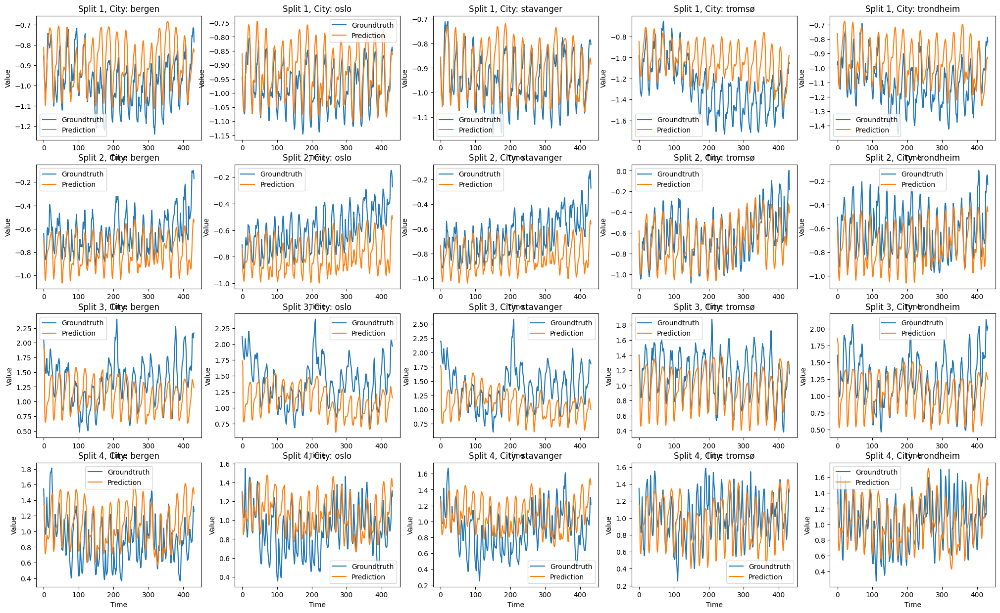

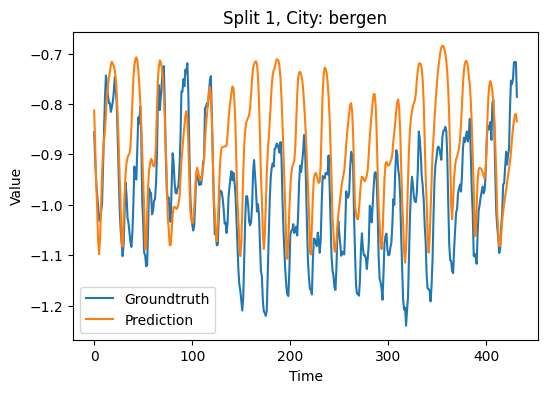

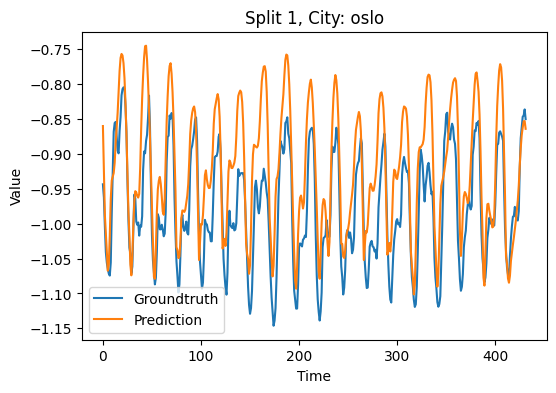

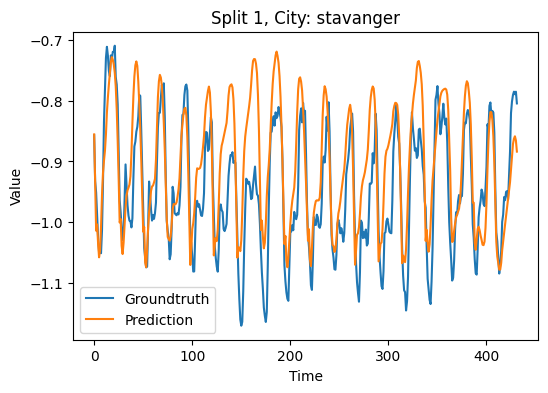

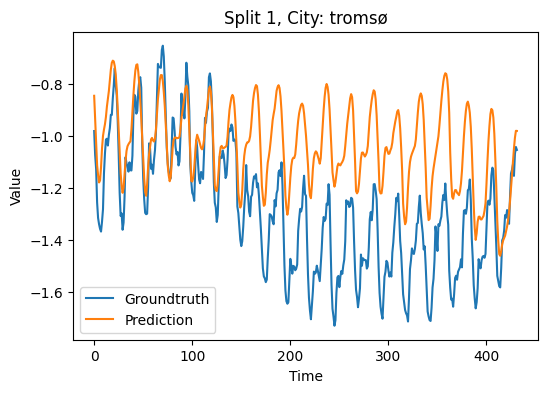

...

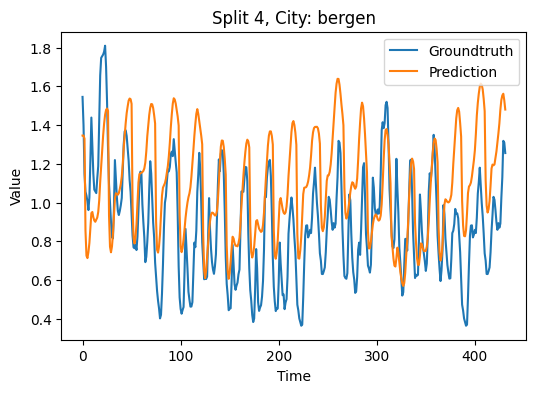

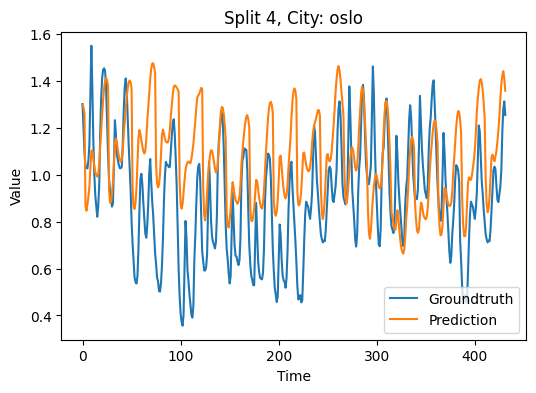

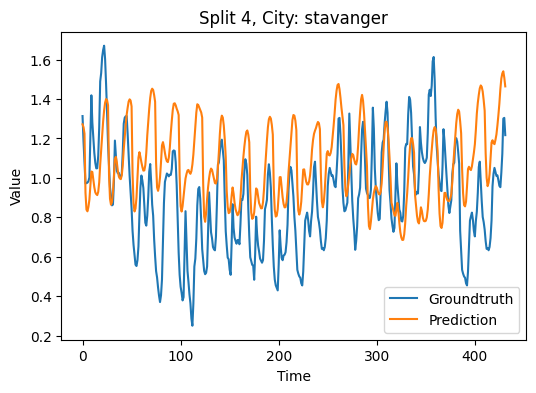

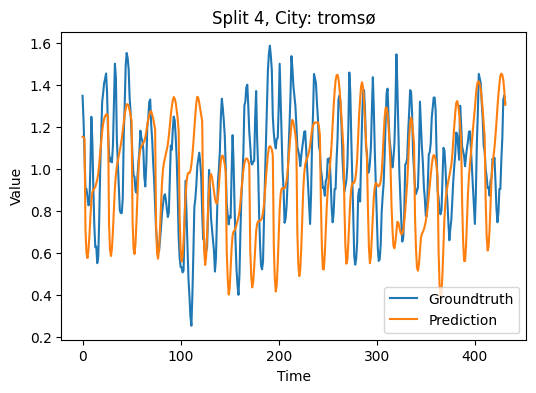

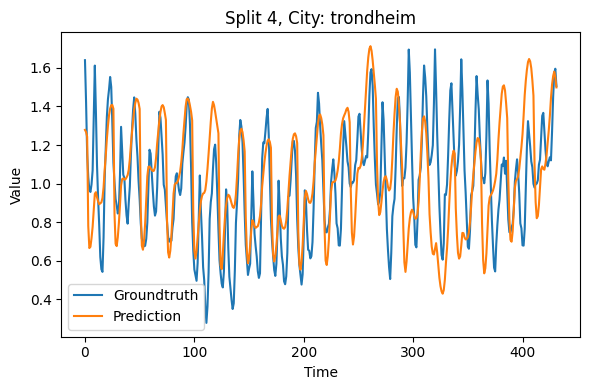

Metrics per City and Split:


,Split,City,MAE,MSE,RMSE,MAPE
0,1,1,0.112378,0.016953,0.130204,11.355749
1,1,2,0.060385,0.005123,0.071574,6.209561
2,1,3,0.063157,0.006098,0.078089,6.665200
3,1,4,0.256848,0.091513,0.302512,18.899448
4,1,5,0.162612,0.035480,0.188361,14.439477
5,2,1,0.154810,0.034776,0.186484,33.300653
6,2,2,0.187999,0.044501,0.210952,37.331016
7,2,3,0.160635,0.038254,0.195587,31.525003
8,2,4,0.115558,0.021732,0.147418,45.064673
9,2,5,0.130686,0.024883,0.157744,28.393202



Average Metrics per City Across Splits:


,City,Split,MAE,MSE,RMSE,MAPE
0,1,2.5,0.218248,0.080355,0.262117,26.816638
1,2,2.5,0.207626,0.077511,0.247729,24.790151
2,3,2.5,0.219835,0.090206,0.263845,25.501355
3,4,2.5,0.207727,0.066759,0.250707,27.627255
4,5,2.5,0.201038,0.067590,0.247797,22.662708



Overall Mean Metrics:
Mean MAE: 0.21089508834715084
Mean MSE: 0.07648429329899512
Mean RMSE: 0.2544390784267071
Mean MAPE: 25.479621484756176


In [80]:
visualize_and_get_metrics(splits=4, prediction=all_city_predictions, truth=xg_truths)

## Combine XG + LSTM Dual-input

In [81]:
combined_preds = (all_city_predictions + xg_predictions) / 2

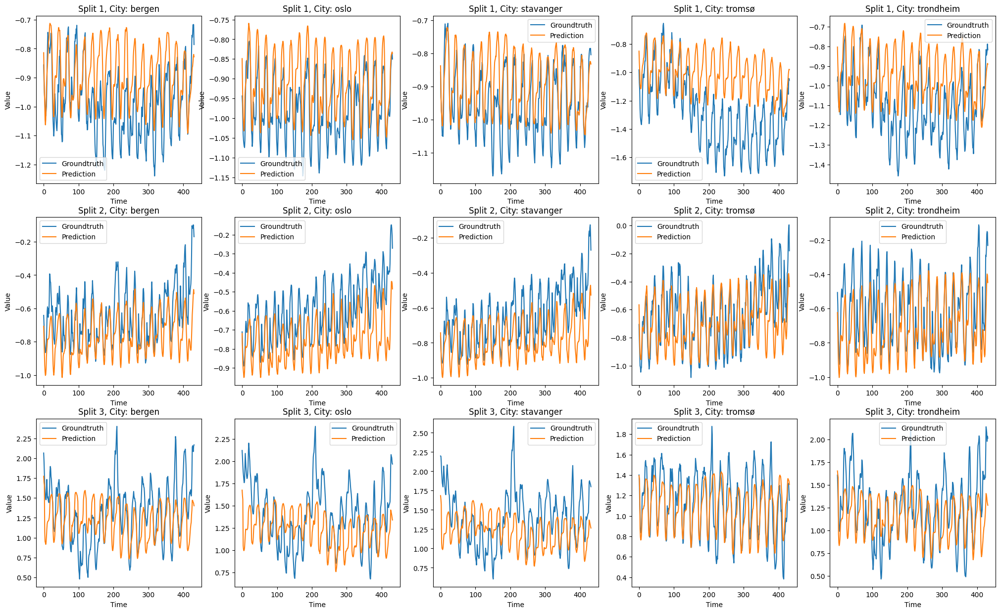

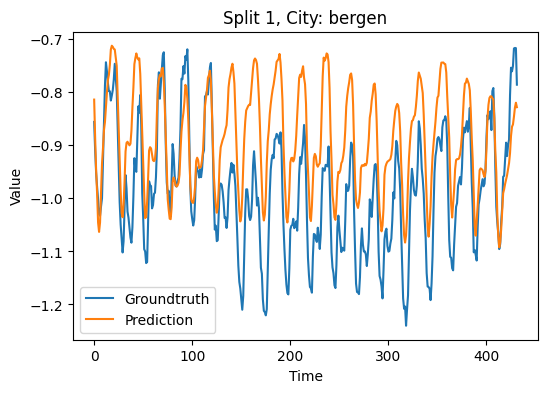

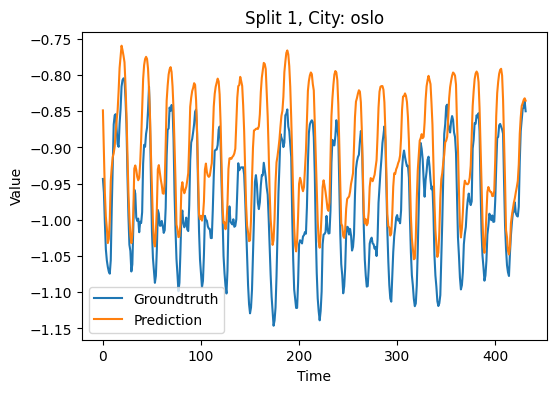

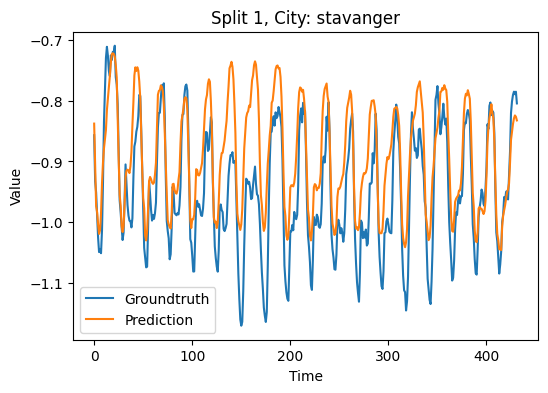

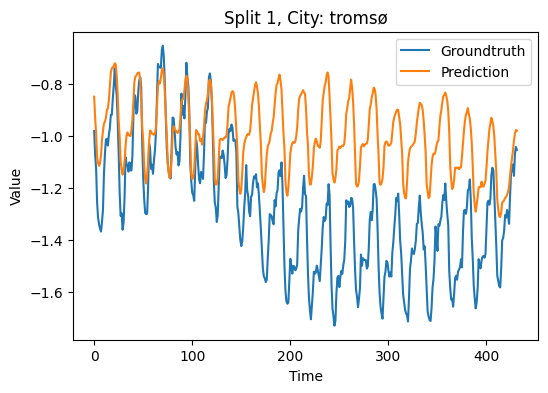

...

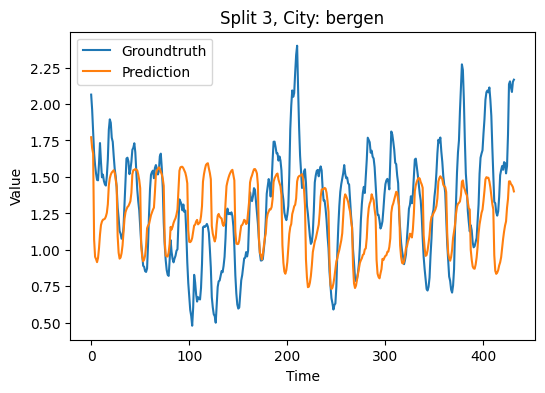

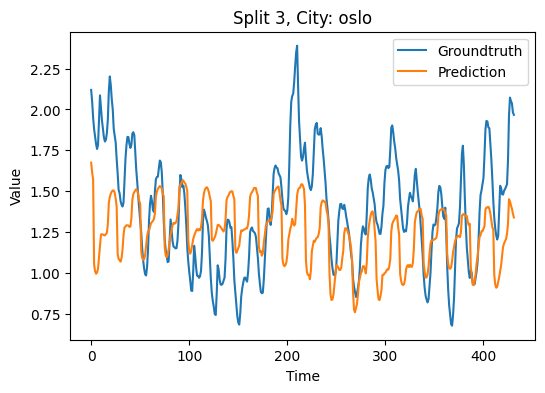

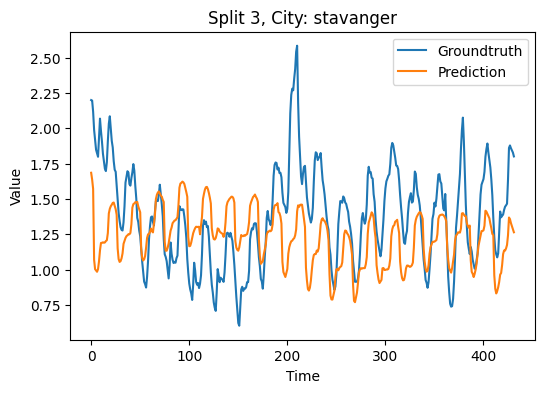

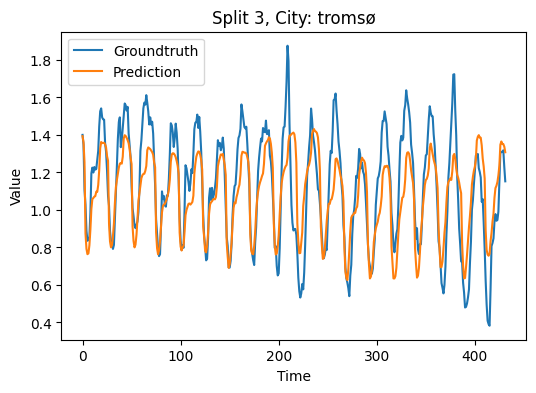

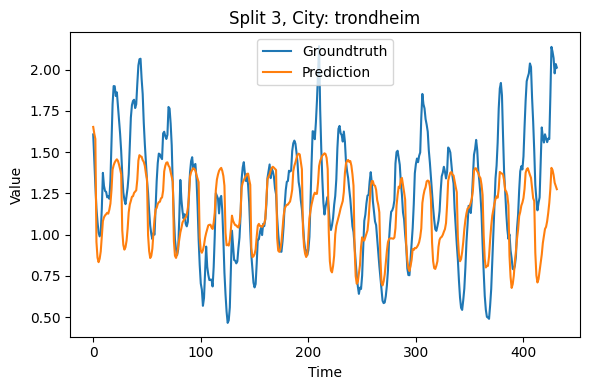

Metrics per City and Split:


,Split,City,MAE,MSE,RMSE,MAPE
0,1,1,0.107548,0.015526,0.124601,10.729859
1,1,2,0.068816,0.005795,0.076123,7.017845
2,1,3,0.063142,0.006027,0.077637,6.550804
3,1,4,0.286909,0.110053,0.331743,20.957057
4,1,5,0.159960,0.033839,0.183954,14.076374
5,2,1,0.116873,0.023069,0.151884,26.829593
6,2,2,0.144314,0.027541,0.165955,29.134296
7,2,3,0.127882,0.025104,0.158441,25.588067
8,2,4,0.120122,0.023594,0.153603,49.431576
9,2,5,0.110719,0.018869,0.137366,24.296133



Average Metrics per City Across Splits:


,City,Split,MAE,MSE,RMSE,MAPE
0,1,2.0,0.169051,0.051431,0.205543,20.227260
1,2,2.0,0.166761,0.052626,0.198328,18.861475
2,3,2.0,0.168080,0.058099,0.204816,18.222305
3,4,2.0,0.184324,0.055731,0.222833,28.126840
4,5,2.0,0.167212,0.045542,0.203669,19.190402



Overall Mean Metrics:
Mean MAE: 0.17108547564287016
Mean MSE: 0.052685782755588204
Mean RMSE: 0.20703798205295001
Mean MAPE: 20.925656590414988


In [82]:
visualize_and_get_metrics(splits=3, prediction=combined_preds, truth=xg_truths)

## Tuned Dual-LSTM

In [83]:
import optuna

c:\Users\Ferdinand\AppData\Local\Programs\Python\Python311\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Check sizes

In [84]:
train_X.shape, train_y.shape

(torch.Size([5568, 216, 12]), torch.Size([5568, 120, 12]))

In [85]:
# Split in training and validation set
tscv = TimeSeriesSplit(n_splits=3)
for train_index, val_index in tscv.split(train_X):
    print("TRAIN:", train_index.shape, "VAL:", val_index.shape)
    X_train, X_val = train_X[train_index], train_X[val_index]
    y_train, y_val = train_y[train_index], train_y[val_index]
    print(X_train.shape, X_val.shape, y_train.shape, y_val.shape)


TRAIN: (1392,) VAL: (1392,)
torch.Size([1392, 216, 12]) torch.Size([1392, 216, 12]) torch.Size([1392, 120, 12]) torch.Size([1392, 120, 12])
TRAIN: (2784,) VAL: (1392,)
torch.Size([2784, 216, 12]) torch.Size([1392, 216, 12]) torch.Size([2784, 120, 12]) torch.Size([1392, 120, 12])
TRAIN: (4176,) VAL: (1392,)
torch.Size([4176, 216, 12]) torch.Size([1392, 216, 12]) torch.Size([4176, 120, 12]) torch.Size([1392, 120, 12])


### Time series split trainer and loss

In [87]:
# Training loop
def train_model_sequential_split(model_type, arguments, criterion, splits, epochs, lr=0.0003, batch_size=256, dual=True):

    tscv = TimeSeriesSplit(n_splits=splits)
    split_losses = []
    for train_index, val_index in tscv.split(train_X):
        X_train, X_val = train_X[train_index], train_X[val_index]
        y_train, y_val = train_y[train_index], train_y[val_index]

        sequential_model = model_type(*arguments).to(device)
        train_dataset = TimeSeriesDataset(X_train, y_train)
        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
        seq_model_optimizer = optim.Adam(sequential_model.parameters(), lr=lr)

        model.train()
        for epoch in range(epochs):
            for batch_X, batch_y in train_loader:
                batch_X, batch_y = batch_X.to(device), batch_y.to(device)
                seq_model_optimizer.zero_grad()
                if dual:
                    consumption_inputs = batch_X[:, :, :5]
                    rest_inputs = torch.cat((batch_X[:, :, 5:], batch_y[:, :, 5:]), 1)
                    outputs = sequential_model(consumption_inputs,rest_inputs)[:, :120, :]
                else:
                    outputs = sequential_model(batch_X)[:, :120, :]
                loss = criterion(outputs, batch_y[:, :120, :5])
                loss.backward()
                seq_model_optimizer.step()
            
            if (epoch + 1) % 10 == 0:
                print(f'Epoch [{epoch+1}/{epochs}], Loss: {loss.item():.4f}')

        model.eval()  # Set the model to evaluation mode
        val_dataset = TimeSeriesDataset(X_val, y_val)
        val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

        # Batched Validation Loop
        total_val_loss = 0.0
        num_batches = 0
        with torch.no_grad():  # No need to track gradients during prediction
            for batch_X_val, batch_y_val in val_loader:
                batch_X_val, batch_y_val = batch_X_val.to(device), batch_y_val.to(device)
                if dual:
                    consumption_inputs = batch_X_val[:, :, :5]
                    rest_inputs = torch.cat((batch_X_val[:, :, 5:], batch_y_val[:, :, 5:]), 1)
                    output_on_val = sequential_model(consumption_inputs, rest_inputs)[:, :120, :]
                else:
                    output_on_val = sequential_model(batch_X_val)[:, :120, :5]
                val_loss = criterion(output_on_val, batch_y_val[:, :120, :5])
                total_val_loss += val_loss.item()
                num_batches += 1

        average_val_loss = total_val_loss / num_batches
        print(f'Average Validation Loss: {average_val_loss:.4f}')
        split_losses.append(average_val_loss)

    return np.mean(split_losses)
model_type = DualInputLSTM
arguments = (5, 7, 64, 5)
mean_loss = train_model_sequential_split(model_type, arguments, criterion, splits=4, epochs=40, lr=0.0003, batch_size=256)
print(f'Mean loss: {mean_loss}')

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\3085534986.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X, dtype=torch.float32)
C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\3085534986.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y, dtype=torch.float32)


Epoch [10/40], Loss: 0.0654
Epoch [20/40], Loss: 0.0438
Epoch [30/40], Loss: 0.0367
Epoch [40/40], Loss: 0.0371
Average Validation Loss: 0.0395
Epoch [10/40], Loss: 0.0460
Epoch [20/40], Loss: 0.0296
Epoch [30/40], Loss: 0.0241
Epoch [40/40], Loss: 0.0223
Average Validation Loss: 0.3828
Epoch [10/40], Loss: 0.0514
Epoch [20/40], Loss: 0.0329
Epoch [30/40], Loss: 0.0214
Epoch [40/40], Loss: 0.0287
Average Validation Loss: 1.0803
Epoch [10/40], Loss: 0.0955
Epoch [20/40], Loss: 0.0623
Epoch [30/40], Loss: 0.0602
Epoch [40/40], Loss: 0.0420
Average Validation Loss: 0.1451
Mean loss: 0.41193127492442727


### Optuna Run

In [88]:
# Optuna
def objective(trial):
    # Suggest hyperparameters
    lr = trial.suggest_float("lr", 1e-6, 1e-2, log=True)
    batch_size = trial.suggest_categorical("batch_size", [64, 128, 256, 512])
    hidden_size = trial.suggest_int("hidden_size", 32, 256)
    epochs = trial.suggest_int("epochs", 5, 100)

    # Model type and arguments
    model_type = DualInputLSTM
    arguments = (5, 7, hidden_size, 5)

    # Model evaluation
    val_loss = train_model_sequential_split(model_type, arguments, nn.MSELoss(), splits=4, epochs=epochs, lr=lr, batch_size=batch_size)

    # Return the metric to be optimized
    return val_loss

train_dataset = TimeSeriesDataset(train_X, train_y)

study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=20)

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\3085534986.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X, dtype=torch.float32)
C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\3085534986.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y, dtype=torch.float32)
[I 2023-11-13 21:38:40,394] A new study created in memory with name: no-name-b07e0969-0cd6-4e5a-95f7-334e6baeed5d


Epoch [10/42], Loss: 0.8162
Epoch [20/42], Loss: 0.6854
Epoch [30/42], Loss: 0.5918
Epoch [40/42], Loss: 0.4721
Average Validation Loss: 0.4704
Epoch [10/42], Loss: 0.7440
Epoch [20/42], Loss: 0.5115
Epoch [30/42], Loss: 0.2529
Epoch [40/42], Loss: 0.0764
Average Validation Loss: 0.2732
Epoch [10/42], Loss: 0.4345
Epoch [20/42], Loss: 0.2448
Epoch [30/42], Loss: 0.1362
Epoch [40/42], Loss: 0.1046
Average Validation Loss: 2.0958
Epoch [10/42], Loss: 0.7788
Epoch [20/42], Loss: 0.5499
Epoch [30/42], Loss: 0.2997
Epoch [40/42], Loss: 0.1665


[I 2023-11-13 21:38:58,230] Trial 0 finished with value: 0.7886268443738421 and parameters: {'lr': 9.035358825035329e-05, 'batch_size': 512, 'hidden_size': 36, 'epochs': 42}. Best is trial 0 with value: 0.7886268443738421.


Average Validation Loss: 0.3151
Epoch [10/82], Loss: 0.6909
Epoch [20/82], Loss: 0.6135
Epoch [30/82], Loss: 0.4928
Epoch [40/82], Loss: 0.3890
Epoch [50/82], Loss: 0.2975
Epoch [60/82], Loss: 0.1892
Epoch [70/82], Loss: 0.1165
Epoch [80/82], Loss: 0.0698
Average Validation Loss: 0.0805
Epoch [10/82], Loss: 0.6720
Epoch [20/82], Loss: 0.4496
Epoch [30/82], Loss: 0.2242
Epoch [40/82], Loss: 0.0760
Epoch [50/82], Loss: 0.0680
Epoch [60/82], Loss: 0.0607
Epoch [70/82], Loss: 0.0534
Epoch [80/82], Loss: 0.0535
Average Validation Loss: 0.3491
Epoch [10/82], Loss: 0.4971
Epoch [20/82], Loss: 0.2479
Epoch [30/82], Loss: 0.1490
Epoch [40/82], Loss: 0.1039
Epoch [50/82], Loss: 0.0798
Epoch [60/82], Loss: 0.0822
Epoch [70/82], Loss: 0.0891
Epoch [80/82], Loss: 0.0672
Average Validation Loss: 1.2775
Epoch [10/82], Loss: 0.7409
Epoch [20/82], Loss: 0.5520
Epoch [30/82], Loss: 0.2040
Epoch [40/82], Loss: 0.1719
Epoch [50/82], Loss: 0.1037
Epoch [60/82], Loss: 0.1119
Epoch [70/82], Loss: 0.0982
Epoc

[I 2023-11-13 21:45:06,272] Trial 1 finished with value: 0.46717518650823164 and parameters: {'lr': 5.970277299477954e-06, 'batch_size': 128, 'hidden_size': 199, 'epochs': 82}. Best is trial 1 with value: 0.46717518650823164.


Average Validation Loss: 0.1616
Average Validation Loss: 0.3051
Average Validation Loss: 0.3832
Average Validation Loss: 1.6849


[I 2023-11-13 21:46:15,545] Trial 2 finished with value: 0.6385078416205943 and parameters: {'lr': 1.79890369873682e-05, 'batch_size': 64, 'hidden_size': 233, 'epochs': 8}. Best is trial 1 with value: 0.46717518650823164.


Average Validation Loss: 0.1808
Epoch [10/17], Loss: 0.4485
Average Validation Loss: 0.2605
Epoch [10/17], Loss: 0.2936
Average Validation Loss: 0.4397
Epoch [10/17], Loss: 0.2056
Average Validation Loss: 2.1560
Epoch [10/17], Loss: 0.3473


[I 2023-11-13 21:48:10,697] Trial 3 finished with value: 0.7951475530862808 and parameters: {'lr': 9.007436000528373e-05, 'batch_size': 512, 'hidden_size': 133, 'epochs': 17}. Best is trial 1 with value: 0.46717518650823164.


Average Validation Loss: 0.3244
Epoch [10/31], Loss: 0.0295
Epoch [20/31], Loss: 0.0198
Epoch [30/31], Loss: 0.0126
Average Validation Loss: 0.0276
Epoch [10/31], Loss: 0.0183
Epoch [20/31], Loss: 0.0134
Epoch [30/31], Loss: 0.0090
Average Validation Loss: 0.4453
Epoch [10/31], Loss: 0.0198
Epoch [20/31], Loss: 0.0147
Epoch [30/31], Loss: 0.0068
Average Validation Loss: 0.8129
Epoch [10/31], Loss: 0.0337
Epoch [20/31], Loss: 0.0169
Epoch [30/31], Loss: 0.0505


[I 2023-11-13 21:50:01,001] Trial 4 finished with value: 0.3514937529340386 and parameters: {'lr': 0.0041771054636764665, 'batch_size': 256, 'hidden_size': 219, 'epochs': 31}. Best is trial 4 with value: 0.3514937529340386.


Average Validation Loss: 0.1202
Epoch [10/57], Loss: 0.3114
Epoch [20/57], Loss: 0.0603
Epoch [30/57], Loss: 0.0436
Epoch [40/57], Loss: 0.0409
Epoch [50/57], Loss: 0.0402
Average Validation Loss: 0.0426
Epoch [10/57], Loss: 0.0723
Epoch [20/57], Loss: 0.0411
Epoch [30/57], Loss: 0.0343
Epoch [40/57], Loss: 0.0302
Epoch [50/57], Loss: 0.0268
Average Validation Loss: 0.5056
Epoch [10/57], Loss: 0.1039
Epoch [20/57], Loss: 0.0557
Epoch [30/57], Loss: 0.0376
Epoch [40/57], Loss: 0.0308
Epoch [50/57], Loss: 0.0278
Average Validation Loss: 1.1469
Epoch [10/57], Loss: 0.1305
Epoch [20/57], Loss: 0.0874
Epoch [30/57], Loss: 0.0852
Epoch [40/57], Loss: 0.0686
Epoch [50/57], Loss: 0.0635


[I 2023-11-13 21:56:14,196] Trial 5 finished with value: 0.4591511695956191 and parameters: {'lr': 0.00017603802734229165, 'batch_size': 512, 'hidden_size': 130, 'epochs': 57}. Best is trial 4 with value: 0.3514937529340386.


Average Validation Loss: 0.1415
Epoch [10/69], Loss: 0.5953
Epoch [20/69], Loss: 0.3872
Epoch [30/69], Loss: 0.1965
Epoch [40/69], Loss: 0.0651
Epoch [50/69], Loss: 0.0470
Epoch [60/69], Loss: 0.0480
Average Validation Loss: 0.0603
Epoch [10/69], Loss: 0.5684
Epoch [20/69], Loss: 0.1828
Epoch [30/69], Loss: 0.0550
Epoch [40/69], Loss: 0.0503
Epoch [50/69], Loss: 0.0430
Epoch [60/69], Loss: 0.0423
Average Validation Loss: 0.3714
Epoch [10/69], Loss: 0.3620
Epoch [20/69], Loss: 0.0942
Epoch [30/69], Loss: 0.0871
Epoch [40/69], Loss: 0.0749
Epoch [50/69], Loss: 0.0597
Epoch [60/69], Loss: 0.0541
Average Validation Loss: 1.2896
Epoch [10/69], Loss: 0.5399
Epoch [20/69], Loss: 0.2064
Epoch [30/69], Loss: 0.1170
Epoch [40/69], Loss: 0.1026
Epoch [50/69], Loss: 0.0905
Epoch [60/69], Loss: 0.0879


[I 2023-11-13 21:57:06,524] Trial 6 finished with value: 0.47296829428523773 and parameters: {'lr': 9.195631521662968e-05, 'batch_size': 512, 'hidden_size': 72, 'epochs': 69}. Best is trial 4 with value: 0.3514937529340386.


Average Validation Loss: 0.1706
Average Validation Loss: 0.9173
Average Validation Loss: 0.3645
Average Validation Loss: 1.3097


[I 2023-11-13 21:57:13,258] Trial 7 finished with value: 1.053270255525907 and parameters: {'lr': 4.9192642265397956e-06, 'batch_size': 512, 'hidden_size': 95, 'epochs': 8}. Best is trial 4 with value: 0.3514937529340386.


Average Validation Loss: 1.6217
Epoch [10/27], Loss: 0.0084
Epoch [20/27], Loss: 0.0061
Average Validation Loss: 0.0194
Epoch [10/27], Loss: 0.0073
Epoch [20/27], Loss: 0.0034
Average Validation Loss: 0.2969
Epoch [10/27], Loss: 0.0060
Epoch [20/27], Loss: 0.0023
Average Validation Loss: 0.7596
Epoch [10/27], Loss: 0.0107
Epoch [20/27], Loss: 0.0029


[I 2023-11-13 22:02:04,206] Trial 8 finished with value: 0.3335237986822095 and parameters: {'lr': 0.009884528937286056, 'batch_size': 64, 'hidden_size': 152, 'epochs': 27}. Best is trial 8 with value: 0.3335237986822095.


Average Validation Loss: 0.2582
Epoch [10/92], Loss: 0.0539
Epoch [20/92], Loss: 0.0386
Epoch [30/92], Loss: 0.0353
Epoch [40/92], Loss: 0.0330
Epoch [50/92], Loss: 0.0277
Epoch [60/92], Loss: 0.0213
Epoch [70/92], Loss: 0.0204
Epoch [80/92], Loss: 0.0178
Epoch [90/92], Loss: 0.0157
Average Validation Loss: 0.0231
Epoch [10/92], Loss: 0.0381
Epoch [20/92], Loss: 0.0285
Epoch [30/92], Loss: 0.0251
Epoch [40/92], Loss: 0.0217
Epoch [50/92], Loss: 0.0185
Epoch [60/92], Loss: 0.0152
Epoch [70/92], Loss: 0.0130
Epoch [80/92], Loss: 0.0117
Epoch [90/92], Loss: 0.0110
Average Validation Loss: 0.4511
Epoch [10/92], Loss: 0.0467
Epoch [20/92], Loss: 0.0252
Epoch [30/92], Loss: 0.0236
Epoch [40/92], Loss: 0.0216
Epoch [50/92], Loss: 0.0152
Epoch [60/92], Loss: 0.0167
Epoch [70/92], Loss: 0.0149
Epoch [80/92], Loss: 0.0110
Epoch [90/92], Loss: 0.0145
Average Validation Loss: 0.8312
Epoch [10/92], Loss: 0.0830
Epoch [20/92], Loss: 0.0563
Epoch [30/92], Loss: 0.0335
Epoch [40/92], Loss: 0.0285
Epoc

[I 2023-11-13 22:19:42,465] Trial 9 finished with value: 0.387988546770066 and parameters: {'lr': 0.00022509730131238157, 'batch_size': 256, 'hidden_size': 182, 'epochs': 92}. Best is trial 8 with value: 0.3335237986822095.


Average Validation Loss: 0.2465
Epoch [10/29], Loss: 0.0162
Epoch [20/29], Loss: 0.0072
Average Validation Loss: 0.0216
Epoch [10/29], Loss: 0.0071
Epoch [20/29], Loss: 0.0028
Average Validation Loss: 0.4778
Epoch [10/29], Loss: 0.0068
Epoch [20/29], Loss: 0.0031
Average Validation Loss: 0.6396
Epoch [10/29], Loss: 0.0105
Epoch [20/29], Loss: 0.0027


[I 2023-11-13 22:26:26,318] Trial 10 finished with value: 0.35667026696804294 and parameters: {'lr': 0.009628143797534143, 'batch_size': 64, 'hidden_size': 169, 'epochs': 29}. Best is trial 8 with value: 0.3335237986822095.


Average Validation Loss: 0.2878
Epoch [10/38], Loss: 0.0264
Epoch [20/38], Loss: 0.0171
Epoch [30/38], Loss: 0.0140
Average Validation Loss: 0.0217
Epoch [10/38], Loss: 0.0168
Epoch [20/38], Loss: 0.0123
Epoch [30/38], Loss: 0.0100
Average Validation Loss: 0.4177
Epoch [10/38], Loss: 0.0276
Epoch [20/38], Loss: 0.0244
Epoch [30/38], Loss: 0.0257
Average Validation Loss: 0.8795
Epoch [10/38], Loss: 0.0339
Epoch [20/38], Loss: 0.0136
Epoch [30/38], Loss: 0.0072


[I 2023-11-13 22:28:40,491] Trial 11 finished with value: 0.39441926404833794 and parameters: {'lr': 0.009462670516369686, 'batch_size': 256, 'hidden_size': 254, 'epochs': 38}. Best is trial 8 with value: 0.3335237986822095.


Average Validation Loss: 0.2588
Epoch [10/26], Loss: 0.0277
Epoch [20/26], Loss: 0.0225
Average Validation Loss: 0.0195
Epoch [10/26], Loss: 0.0182
Epoch [20/26], Loss: 0.0117
Average Validation Loss: 0.4813
Epoch [10/26], Loss: 0.0197
Epoch [20/26], Loss: 0.0155
Average Validation Loss: 0.6328
Epoch [10/26], Loss: 0.0374
Epoch [20/26], Loss: 0.0317


[I 2023-11-13 22:29:56,664] Trial 12 finished with value: 0.3160120743792504 and parameters: {'lr': 0.00203176126766047, 'batch_size': 256, 'hidden_size': 212, 'epochs': 26}. Best is trial 12 with value: 0.3160120743792504.


Average Validation Loss: 0.1304
Epoch [10/53], Loss: 0.0132
Epoch [20/53], Loss: 0.0063
Epoch [30/53], Loss: 0.0042
Epoch [40/53], Loss: 0.0027
Epoch [50/53], Loss: 0.0022
Average Validation Loss: 0.0185
Epoch [10/53], Loss: 0.0094
Epoch [20/53], Loss: 0.0056
Epoch [30/53], Loss: 0.0033
Epoch [40/53], Loss: 0.0020
Epoch [50/53], Loss: 0.0015
Average Validation Loss: 0.3112
Epoch [10/53], Loss: 0.0086
Epoch [20/53], Loss: 0.0036
Epoch [30/53], Loss: 0.0026
Epoch [40/53], Loss: 0.0022
Epoch [50/53], Loss: 0.0015
Average Validation Loss: 0.5865
Epoch [10/53], Loss: 0.0157
Epoch [20/53], Loss: 0.0073
Epoch [30/53], Loss: 0.0036
Epoch [40/53], Loss: 0.0026
Epoch [50/53], Loss: 0.0032


[I 2023-11-13 22:41:54,787] Trial 13 finished with value: 0.31055099896103555 and parameters: {'lr': 0.0018504797968508391, 'batch_size': 64, 'hidden_size': 170, 'epochs': 53}. Best is trial 13 with value: 0.31055099896103555.


Average Validation Loss: 0.3260
Epoch [10/56], Loss: 0.0241
Epoch [20/56], Loss: 0.0160
Epoch [30/56], Loss: 0.0114
Epoch [40/56], Loss: 0.0076
Epoch [50/56], Loss: 0.0054
Average Validation Loss: 0.0245
Epoch [10/56], Loss: 0.0164
Epoch [20/56], Loss: 0.0096
Epoch [30/56], Loss: 0.0072
Epoch [40/56], Loss: 0.0051
Epoch [50/56], Loss: 0.0039
Average Validation Loss: 0.3023
Epoch [10/56], Loss: 0.0146
Epoch [20/56], Loss: 0.0090
Epoch [30/56], Loss: 0.0047
Epoch [40/56], Loss: 0.0043
Epoch [50/56], Loss: 0.0025
Average Validation Loss: 0.6748
Epoch [10/56], Loss: 0.0368
Epoch [20/56], Loss: 0.0165
Epoch [30/56], Loss: 0.0072
Epoch [40/56], Loss: 0.0060
Epoch [50/56], Loss: 0.0047


[I 2023-11-13 22:46:21,763] Trial 14 finished with value: 0.3138215041253716 and parameters: {'lr': 0.0012161502912607083, 'batch_size': 128, 'hidden_size': 203, 'epochs': 56}. Best is trial 13 with value: 0.31055099896103555.


Average Validation Loss: 0.2537
Epoch [10/59], Loss: 0.0317
Epoch [20/59], Loss: 0.0213
Epoch [30/59], Loss: 0.0253
Epoch [40/59], Loss: 0.0113
Epoch [50/59], Loss: 0.0080
Average Validation Loss: 0.0184
Epoch [10/59], Loss: 0.0172
Epoch [20/59], Loss: 0.0132
Epoch [30/59], Loss: 0.0092
Epoch [40/59], Loss: 0.0064
Epoch [50/59], Loss: 0.0053
Average Validation Loss: 0.3206
Epoch [10/59], Loss: 0.0141
Epoch [20/59], Loss: 0.0114
Epoch [30/59], Loss: 0.0060
Epoch [40/59], Loss: 0.0041
Epoch [50/59], Loss: 0.0035
Average Validation Loss: 0.6835
Epoch [10/59], Loss: 0.0247
Epoch [20/59], Loss: 0.0144
Epoch [30/59], Loss: 0.0097
Epoch [40/59], Loss: 0.0066
Epoch [50/59], Loss: 0.0052


[I 2023-11-13 22:58:43,611] Trial 15 finished with value: 0.3154353248214142 and parameters: {'lr': 0.0009495690547021785, 'batch_size': 128, 'hidden_size': 185, 'epochs': 59}. Best is trial 13 with value: 0.31055099896103555.


Average Validation Loss: 0.2392
Epoch [10/69], Loss: 0.0304
Epoch [20/69], Loss: 0.0171
Epoch [30/69], Loss: 0.0113
Epoch [40/69], Loss: 0.0082
Epoch [50/69], Loss: 0.0073
Epoch [60/69], Loss: 0.0054
Average Validation Loss: 0.0182
Epoch [10/69], Loss: 0.0195
Epoch [20/69], Loss: 0.0122
Epoch [30/69], Loss: 0.0087
Epoch [40/69], Loss: 0.0067
Epoch [50/69], Loss: 0.0051
Epoch [60/69], Loss: 0.0040
Average Validation Loss: 0.3575
Epoch [10/69], Loss: 0.0169
Epoch [20/69], Loss: 0.0099
Epoch [30/69], Loss: 0.0084
Epoch [40/69], Loss: 0.0062
Epoch [50/69], Loss: 0.0049
Epoch [60/69], Loss: 0.0042
Average Validation Loss: 0.8949
Epoch [10/69], Loss: 0.0362
Epoch [20/69], Loss: 0.0176
Epoch [30/69], Loss: 0.0128
Epoch [40/69], Loss: 0.0101
Epoch [50/69], Loss: 0.0078
Epoch [60/69], Loss: 0.0070


[I 2023-11-13 23:00:41,573] Trial 16 finished with value: 0.37252887998086714 and parameters: {'lr': 0.00120717958963452, 'batch_size': 128, 'hidden_size': 109, 'epochs': 69}. Best is trial 13 with value: 0.31055099896103555.


Average Validation Loss: 0.2196
Epoch [10/48], Loss: 0.0235
Epoch [20/48], Loss: 0.0152
Epoch [30/48], Loss: 0.0079
Epoch [40/48], Loss: 0.0059
Average Validation Loss: 0.0237
Epoch [10/48], Loss: 0.0138
Epoch [20/48], Loss: 0.0070
Epoch [30/48], Loss: 0.0047
Epoch [40/48], Loss: 0.0031
Average Validation Loss: 0.2710
Epoch [10/48], Loss: 0.0137
Epoch [20/48], Loss: 0.0069
Epoch [30/48], Loss: 0.0034
Epoch [40/48], Loss: 0.0030
Average Validation Loss: 0.6869
Epoch [10/48], Loss: 0.0255
Epoch [20/48], Loss: 0.0109
Epoch [30/48], Loss: 0.0070
Epoch [40/48], Loss: 0.0047


[I 2023-11-13 23:07:13,109] Trial 17 finished with value: 0.3310143419787184 and parameters: {'lr': 0.0005512124083441718, 'batch_size': 64, 'hidden_size': 256, 'epochs': 48}. Best is trial 13 with value: 0.31055099896103555.


Average Validation Loss: 0.3424
Epoch [10/70], Loss: 0.0242
Epoch [20/70], Loss: 0.0175
Epoch [30/70], Loss: 0.0136
Epoch [40/70], Loss: 0.0088
Epoch [50/70], Loss: 0.0065
Epoch [60/70], Loss: 0.0045
Epoch [70/70], Loss: 0.0032
Average Validation Loss: 0.0244
Epoch [10/70], Loss: 0.0148
Epoch [20/70], Loss: 0.0090
Epoch [30/70], Loss: 0.0061
Epoch [40/70], Loss: 0.0042
Epoch [50/70], Loss: 0.0028
Epoch [60/70], Loss: 0.0023
Epoch [70/70], Loss: 0.0019
Average Validation Loss: 0.3501
Epoch [10/70], Loss: 0.0128
Epoch [20/70], Loss: 0.0051
Epoch [30/70], Loss: 0.0032
Epoch [40/70], Loss: 0.0019
Epoch [50/70], Loss: 0.0019
Epoch [60/70], Loss: 0.0012
Epoch [70/70], Loss: 0.0013
Average Validation Loss: 0.6448
Epoch [10/70], Loss: 0.0247
Epoch [20/70], Loss: 0.0082
Epoch [30/70], Loss: 0.0063
Epoch [40/70], Loss: 0.0041
Epoch [50/70], Loss: 0.0027
Epoch [60/70], Loss: 0.0083
Epoch [70/70], Loss: 0.0034


[I 2023-11-13 23:17:35,332] Trial 18 finished with value: 0.31803219369612634 and parameters: {'lr': 0.00276508119654402, 'batch_size': 128, 'hidden_size': 151, 'epochs': 70}. Best is trial 13 with value: 0.31055099896103555.


Average Validation Loss: 0.2529
Epoch [10/79], Loss: 0.0310
Epoch [20/79], Loss: 0.0262
Epoch [30/79], Loss: 0.0172
Epoch [40/79], Loss: 0.0126
Epoch [50/79], Loss: 0.0098
Epoch [60/79], Loss: 0.0085
Epoch [70/79], Loss: 0.0072
Average Validation Loss: 0.0186
Epoch [10/79], Loss: 0.0240
Epoch [20/79], Loss: 0.0170
Epoch [30/79], Loss: 0.0128
Epoch [40/79], Loss: 0.0095
Epoch [50/79], Loss: 0.0074
Epoch [60/79], Loss: 0.0056
Epoch [70/79], Loss: 0.0054
Average Validation Loss: 0.3152
Epoch [10/79], Loss: 0.0179
Epoch [20/79], Loss: 0.0135
Epoch [30/79], Loss: 0.0119
Epoch [40/79], Loss: 0.0061
Epoch [50/79], Loss: 0.0062
Epoch [60/79], Loss: 0.0041
Epoch [70/79], Loss: 0.0039
Average Validation Loss: 0.7030
Epoch [10/79], Loss: 0.0372
Epoch [20/79], Loss: 0.0226
Epoch [30/79], Loss: 0.0198
Epoch [40/79], Loss: 0.0116
Epoch [50/79], Loss: 0.0100
Epoch [60/79], Loss: 0.0076
Epoch [70/79], Loss: 0.0081


[I 2023-11-13 23:33:09,271] Trial 19 finished with value: 0.33158740615989596 and parameters: {'lr': 0.0004763234602281924, 'batch_size': 128, 'hidden_size': 173, 'epochs': 79}. Best is trial 13 with value: 0.31055099896103555.


Average Validation Loss: 0.2895


In [89]:
print("Best trial:")
trial = study.best_trial
print(" Value: ", trial.value)
print(" Params: ")
for key, value in trial.params.items():
    print(f"    {key}: {value}")

Best trial:
 Value:  0.31055099896103555
 Params: 
    lr: 0.0018504797968508391
    batch_size: 64
    hidden_size: 170
    epochs: 53


### Train with tuned parameters

In [90]:
# Get the best model parameters
lr = trial.params["lr"]
batch_size = trial.params["batch_size"]
epochs = trial.params["epochs"]
hidden_size = trial.params["hidden_size"]

# Train the model
lstm_model_tuned = DualInputLSTM(5, 7, hidden_size, 5).to(device)
train_dataset = TimeSeriesDataset(train_X, train_y)
# Instantiate data loader
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

lstm_optimizer_tuned = optim.Adam(lstm_model_tuned.parameters(), lr=lr)
# Use function from above
train_model_sequential_dual(lstm_model_tuned, train_loader, nn.MSELoss(), lstm_optimizer_tuned, epochs, batch_size)

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\3085534986.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X, dtype=torch.float32)
C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\3085534986.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y, dtype=torch.float32)


Epoch [5/53], Loss: 0.0326
Epoch [10/53], Loss: 0.0121
Epoch [15/53], Loss: 0.0072
Epoch [20/53], Loss: 0.0048
Epoch [25/53], Loss: 0.0061
Epoch [30/53], Loss: 0.0048
Epoch [35/53], Loss: 0.0055
Epoch [40/53], Loss: 0.0040
Epoch [45/53], Loss: 0.0030
Epoch [50/53], Loss: 0.0038


### Get predictions

In [91]:
# Get predictions
dual_lstm_tuned_predictions = get_predictions_sequential_dual(lstm_model_tuned, test_X, test_y)
dual_lstm_tuned_predictions.shape

torch.Size([1728, 216, 12])


torch.Size([1728, 5])


(4, 432, 5)

### Output results

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\2449073212.py:40: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig_individual = plt.figure(figsize=(6, 4))


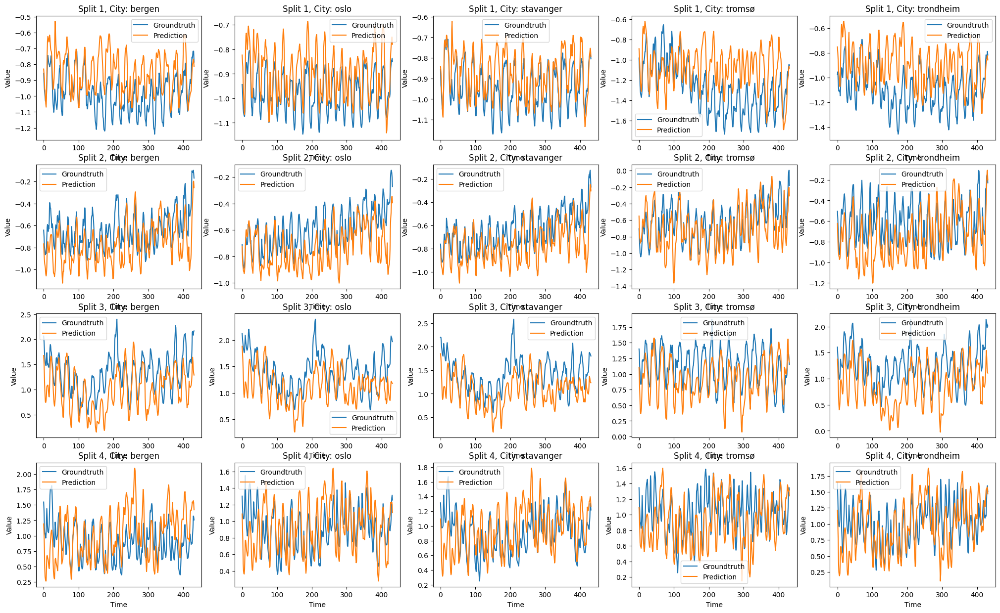

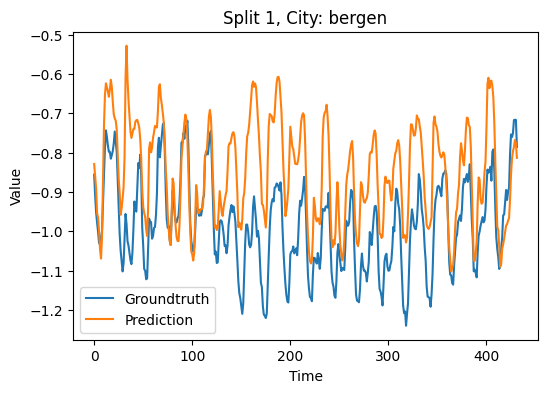

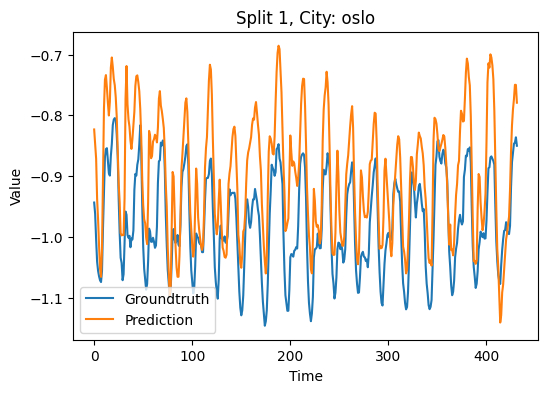

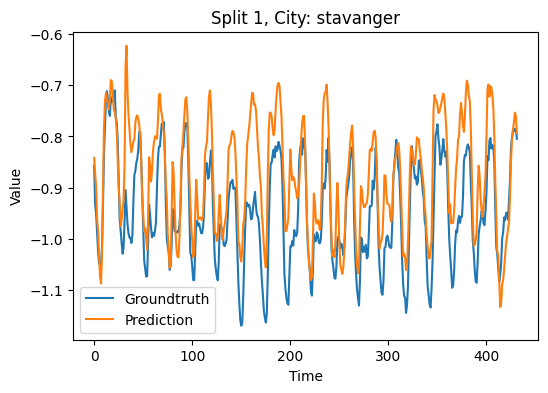

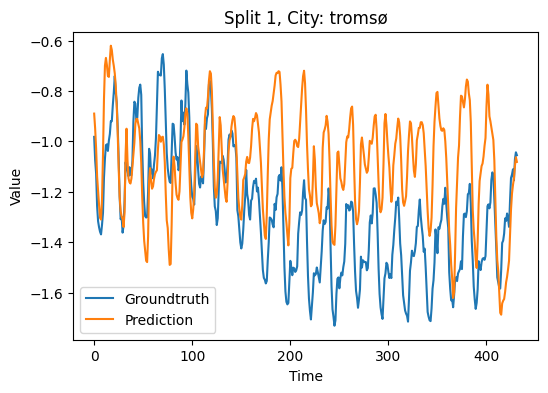

...

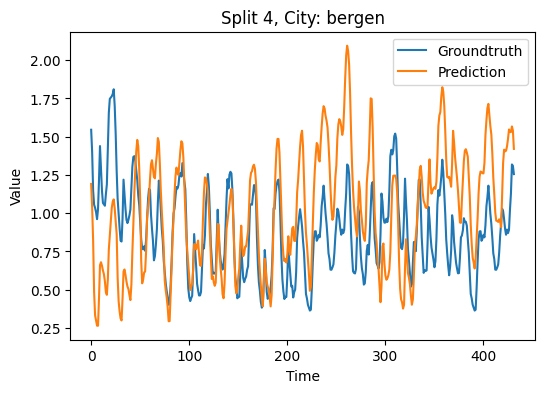

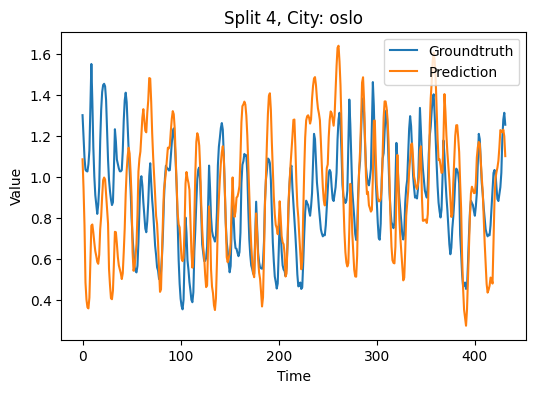

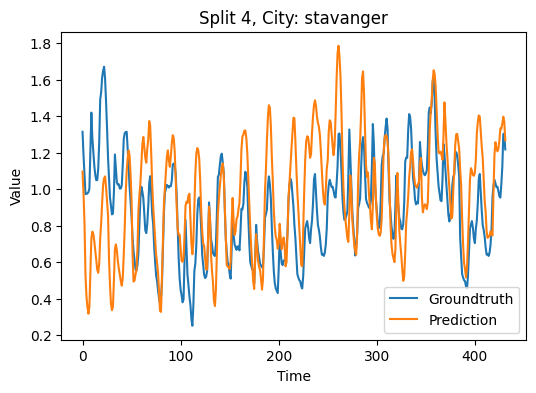

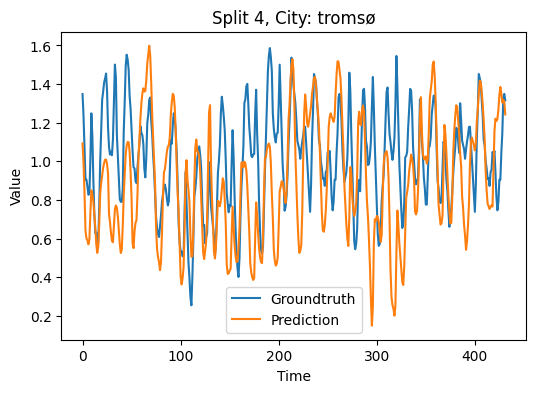

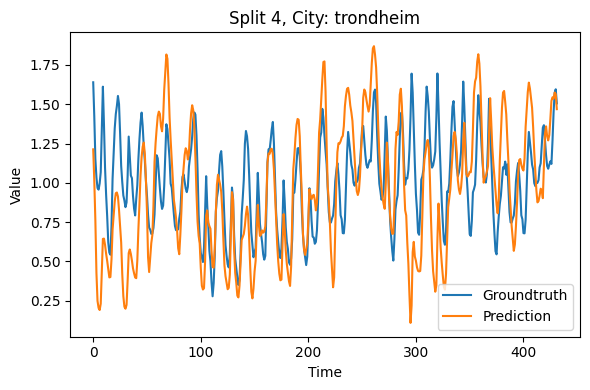

Metrics per City and Split:


,Split,City,MAE,MSE,RMSE,MAPE
0,1,1,0.141176,0.027664,0.166324,14.211243
1,1,2,0.082094,0.009020,0.094976,8.471436
2,1,3,0.074820,0.008523,0.092319,7.838766
3,1,4,0.259415,0.092542,0.304207,19.726260
4,1,5,0.204001,0.057866,0.240554,18.231166
5,2,1,0.161973,0.034631,0.186093,30.291606
6,2,2,0.136180,0.027763,0.166622,26.655871
7,2,3,0.127044,0.023890,0.154564,22.912308
8,2,4,0.145214,0.035277,0.187821,42.102123
9,2,5,0.189052,0.046919,0.216609,36.346244



Average Metrics per City Across Splits:


,City,Split,MAE,MSE,RMSE,MAPE
0,1,2.5,0.253122,0.105096,0.299115,28.327294
1,2,2.5,0.194973,0.070574,0.236518,21.183096
2,3,2.5,0.199314,0.075447,0.241829,21.147444
3,4,2.5,0.232048,0.083801,0.284010,28.071959
4,5,2.5,0.270913,0.118886,0.326132,29.332037



Overall Mean Metrics:
Mean MAE: 0.23007401840276573
Mean MSE: 0.090760765568105
Mean RMSE: 0.2775207007675204
Mean MAPE: 25.612365954155063


In [93]:
visualize_and_get_metrics(splits=4, prediction=dual_lstm_tuned_predictions, truth=xg_truths)

## Combine XG + Tuned Dual-LSTM

In [94]:
combined_preds = (dual_lstm_tuned_predictions + xg_predictions) / 2

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_14324\2449073212.py:40: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig_individual = plt.figure(figsize=(6, 4))


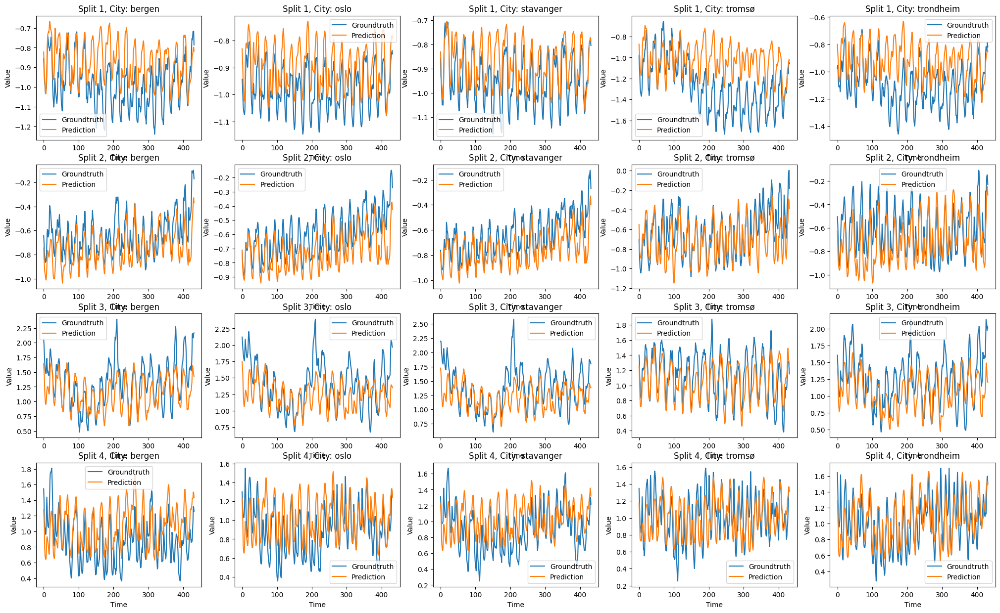

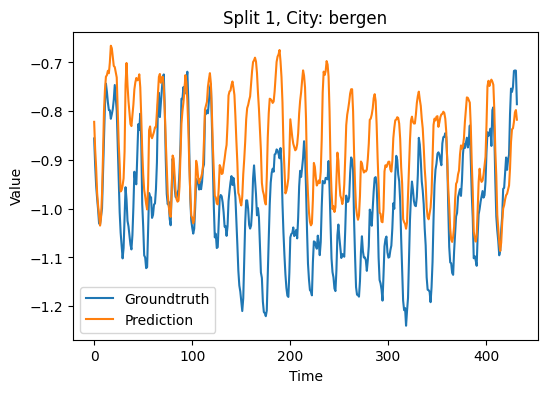

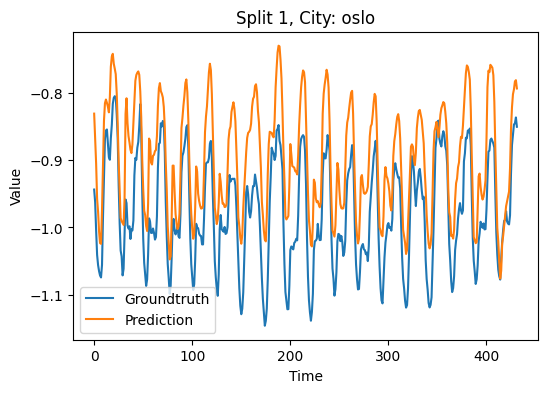

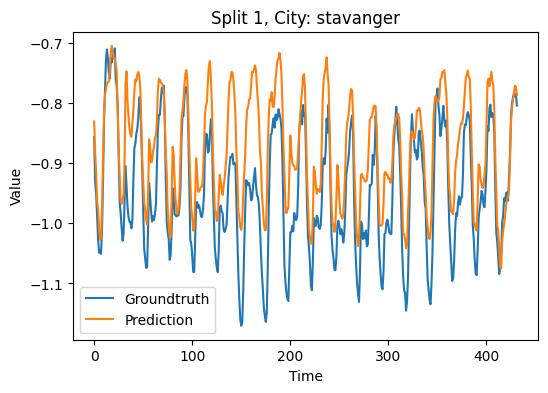

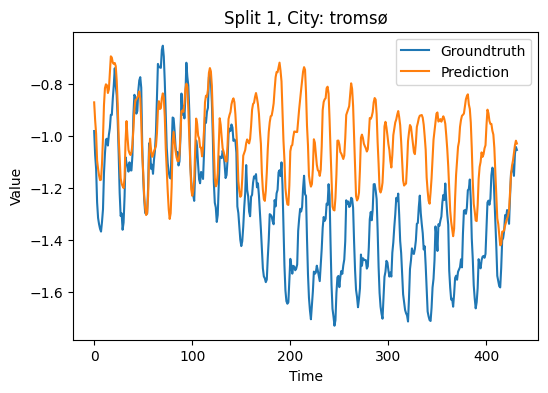

...

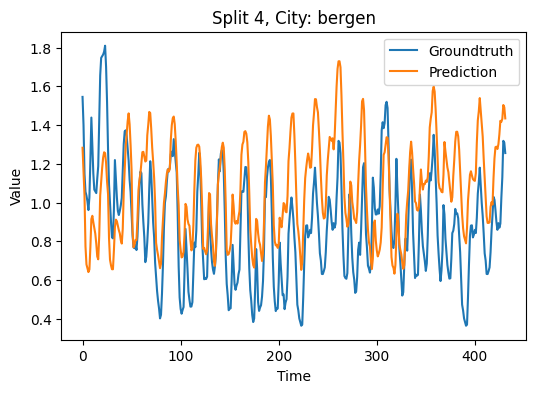

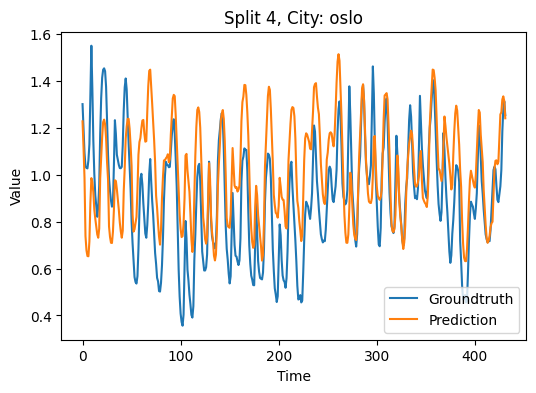

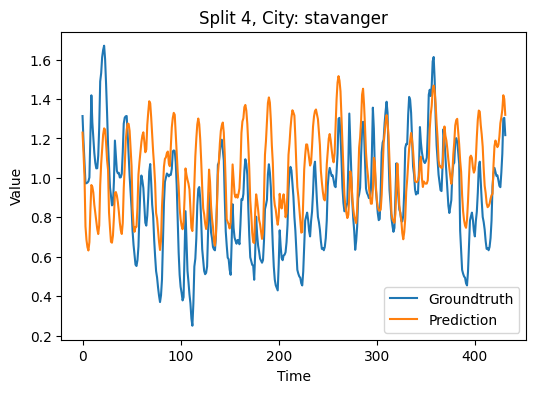

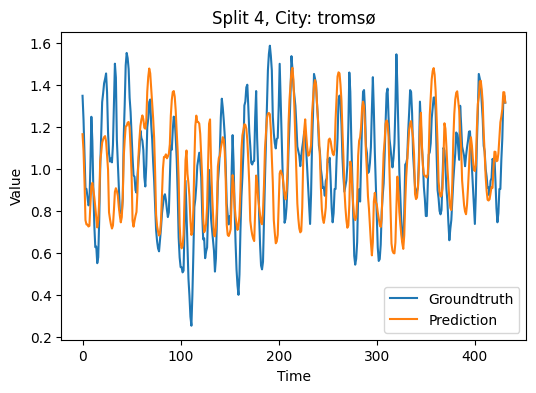

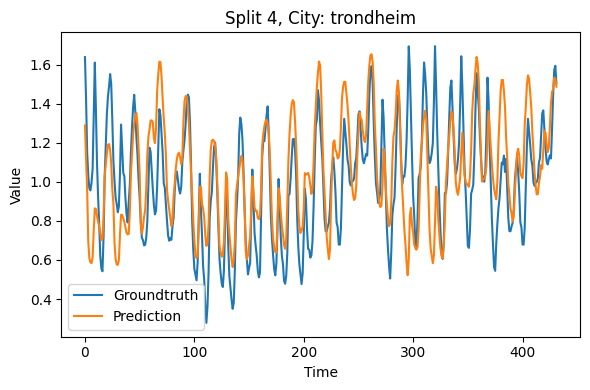

Metrics per City and Split:


,Split,City,MAE,MSE,RMSE,MAPE
0,1,1,0.120559,0.019786,0.140663,11.984778
1,1,2,0.079668,0.007398,0.086013,8.154663
2,1,3,0.071394,0.007053,0.083979,7.397233
3,1,4,0.275252,0.104645,0.323489,20.265611
4,1,5,0.179762,0.042969,0.207291,15.886395
5,2,1,0.118729,0.021436,0.146412,25.070677
6,2,2,0.115728,0.019297,0.138912,23.362528
7,2,3,0.106753,0.017420,0.131983,20.617344
8,2,4,0.120297,0.025141,0.158558,45.287513
9,2,5,0.134639,0.025193,0.158723,27.487418



Average Metrics per City Across Splits:


,City,Split,MAE,MSE,RMSE,MAPE
0,1,2.5,0.191933,0.059023,0.227841,23.203155
1,2,2.5,0.159941,0.046013,0.194311,18.403377
2,3,2.5,0.161719,0.048566,0.198632,18.560749
3,4,2.5,0.184263,0.054399,0.225212,25.086407
4,5,2.5,0.193620,0.058914,0.234678,21.645311



Overall Mean Metrics:
Mean MAE: 0.17829508680232548
Mean MSE: 0.053382820556847135
Mean RMSE: 0.2161346695445873
Mean MAPE: 21.379799779968945


In [95]:
visualize_and_get_metrics(splits=4, prediction=combined_preds, truth=xg_truths)

# Model 4: Transformer

## Transformer 1

### Create Model

In [84]:
class TimeSeriesTransformer(nn.Module):
    def __init__(self, 
                 feature_size=12, 
                 num_layers=1, 
                 num_heads=6, 
                 feedforward_dim=64, 
                 dropout=0.1, 
                 output_size=5,
                 pos_enc_size=216):
        super(TimeSeriesTransformer, self).__init__()
        
        self.feature_size = feature_size
        
        self.positional_encoding = nn.Parameter(torch.randn(1, pos_enc_size, feature_size))
        
        self.transformer = nn.Transformer(d_model=feature_size, 
                                          nhead=num_heads, 
                                          num_encoder_layers=num_layers,
                                          num_decoder_layers=num_layers, 
                                          dim_feedforward=feedforward_dim, 
                                          dropout=dropout)
        
        self.linear = nn.Linear(feature_size, output_size)
        
    def forward(self, x, verbose=False):
        # Add positional encoding
        x = x + self.positional_encoding

        if verbose:
            print('1:', x.shape)
        
        # Transformer expects tgt (target tensor) for supervised tasks, but for our forecasting task
        # We'll use shifted input as target (this is a common trick for time series forecasting)
        tgt = torch.roll(x, shifts=-1, dims=1)

        if verbose:
            print('2:', tgt.shape)
        
        # Apply transformer
        out = self.transformer(x, tgt)

        if verbose:
            print('3:', out.shape)
        
        # Use relevant steps from the transformer output
        out = out[:, :, :]

        if verbose:
            print('4:', out.shape)
        
        # Pass through linear layer
        out = self.linear(out)

        if verbose:
            print('5:', out.shape)
        
        return out
    
model = TimeSeriesTransformer()
total_params, trainable_params = count_parameters(model)
print(f"Total parameters: {total_params}")
print(f"Trainable parameters: {trainable_params}")

Total parameters: 7921
Trainable parameters: 7921


In [85]:
model = TimeSeriesTransformer()
model.train()
optimizer = optim.Adam(model.parameters(), lr=0.001)
input = torch.randn(25, 216, 12)
out = model(input, verbose=True)

1: torch.Size([25, 216, 12])
2: torch.Size([25, 216, 12])
3: torch.Size([25, 216, 12])
4: torch.Size([25, 216, 12])
5: torch.Size([25, 216, 5])


### Train Model

In [86]:
# Train the model
tst_model = TimeSeriesTransformer().to(device)
tst_optimizer = optim.Adam(tst_model.parameters(), lr=0.0003)
train_model_sequential(tst_model, nn.MSELoss(), tst_optimizer, epochs=50, batch_size=256)

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_20244\3085534986.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X, dtype=torch.float32)
C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_20244\3085534986.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y, dtype=torch.float32)


Epoch [5/50], Loss: 0.7560
Epoch [10/50], Loss: 0.1999
Epoch [15/50], Loss: 0.2682
Epoch [20/50], Loss: 0.1591
Epoch [25/50], Loss: 0.1665
Epoch [30/50], Loss: 0.1537
Epoch [35/50], Loss: 0.1493
Epoch [40/50], Loss: 0.1171
Epoch [45/50], Loss: 0.1144
Epoch [50/50], Loss: 0.1062


### Time series split trainer and loss

In [ ]:
# Test a time series split

model_type = TimeSeriesTransformer
arguments = []
mean_loss = train_model_sequential_split(model_type=model_type, arguments=arguments, criterion=nn.MSELoss(), splits=3, epochs=30, lr=0.0003, batch_size=64, dual=False)
print(f'Mean loss: {mean_loss}')

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_7932\3085534986.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X, dtype=torch.float32)
C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_7932\3085534986.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y, dtype=torch.float32)


Epoch [10/30], Loss: 0.0578


KeyboardInterrupt: 

### Optuna Run

In [ ]:
# Try to predict each city separately
criterion = nn.MSELoss()

# NB This can either be trained to predict the whole next sequence, or just for the hour in question.
# Did not see much difference in performance.

def objective(trial):
    # Suggest hyperparameters
    lr = trial.suggest_float("lr", 1e-6, 1e-2, log=True)
    batch_size = trial.suggest_categorical("batch_size", [32, 64, 128, 256])
    hidden_size = trial.suggest_int("hidden_size", 32, 256)
    num_heads = trial.suggest_categorical("num_heads", [1, 2, 3, 4, 6, 12])
    dropout = trial.suggest_float("dropout", 0.0, 0.4)
    epochs = trial.suggest_int("epochs", 5, 50)

    model_type = TimeSeriesTransformer
    arguments = [12, 1, num_heads, hidden_size, dropout, 5, 216]
    # Model setup
    val_loss = train_model_sequential_split(model_type=model_type, arguments=arguments, criterion=nn.MSELoss(), splits=3, epochs=epochs, lr=lr, batch_size=batch_size, dual=False)

    # Return the metric to be optimized
    return val_loss

train_dataset = TimeSeriesDataset(train_X, train_y)

study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=10)

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_7932\3085534986.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X, dtype=torch.float32)
C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_7932\3085534986.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y, dtype=torch.float32)
[I 2023-11-13 17:12:36,916] A new study created in memory with name: no-name-e8ce5444-5dea-48b0-a890-32499351d2ad


Epoch [10/46], Loss: 0.5400


[W 2023-11-13 17:13:54,496] Trial 0 failed with parameters: {'lr': 0.00013562599677913488, 'batch_size': 256, 'hidden_size': 33, 'num_heads': 3, 'dropout': 0.3499327467164307, 'epochs': 46} because of the following error: KeyboardInterrupt().
Traceback (most recent call last):
  File "c:\Users\Ferdinand\AppData\Local\Programs\Python\Python311\Lib\site-packages\optuna\study\_optimize.py", line 200, in _run_trial
    value_or_values = func(trial)
                      ^^^^^^^^^^^
  File "C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_7932\3348450070.py", line 19, in objective
    val_loss = train_model_sequential_split(model_type=model_type, arguments=arguments, criterion=nn.MSELoss(), splits=3, epochs=epochs, lr=lr, batch_size=batch_size, dual=False)
               ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_7932

KeyboardInterrupt: 

In [ ]:
print("Best trial:")
trial = study.best_trial
print(" Value: ", trial.value)
print(" Params: ")
for key, value in trial.params.items():
    print(f"    {key}: {value}")

Best trial:


NameError: name 'study' is not defined

### Train with tuned parameters

In [88]:
# Get the best model parameters
# lr = trial.params["lr"]
# batch_size = trial.params["batch_size"]
# epochs = trial.params["epochs"]
# hidden_size = trial.params["hidden_size"]
# num_heads = trial.params["num_heads"]
# dropout = trial.params["dropout"]
lr = 0.001
batch_size = 128
epochs = 50
hidden_size = 128
num_heads = 6
dropout = 0.1

# Train the model
tst_model1 = TimeSeriesTransformer(feedforward_dim=hidden_size, num_heads=num_heads, dropout=dropout).to(device)
tst_optimizer1 = optim.Adam(tst_model1.parameters(), lr=lr)
train_model_sequential(tst_model1, nn.MSELoss(), tst_optimizer1, epochs=epochs, batch_size=batch_size)

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_20244\3085534986.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X, dtype=torch.float32)
C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_20244\3085534986.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y, dtype=torch.float32)


Epoch [5/50], Loss: 0.1081
Epoch [10/50], Loss: 0.1753
Epoch [15/50], Loss: 0.1009
Epoch [20/50], Loss: 0.1475
Epoch [25/50], Loss: 0.1464
Epoch [30/50], Loss: 0.0673
Epoch [35/50], Loss: 0.1012
Epoch [40/50], Loss: 0.1042
Epoch [45/50], Loss: 0.0713
Epoch [50/50], Loss: 0.0710


### Get Predictions

In [89]:
# Batched Validation Loop
def get_predictions_sequential_batched(model, test_X, test_y, dual=False):
    test_dataset = TimeSeriesDataset(test_X, test_y)
    test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)
    with torch.no_grad():  # No need to track gradients during prediction
        model.eval()  # Set the model to evaluation mode
        city_predictions = []
        for batch_X_test, batch_y_test in test_loader:
            if dual:
                consumption_inputs = batch_X_test[:, :, :5]
                rest_inputs = torch.cat((batch_X_test[:, :, 5:], batch_y_test[:, :, 5:]), 1)
                output = model(consumption_inputs, rest_inputs)[:, 120, :]
            else:
                # print(batch_X_test.shape)
                output = model(batch_X_test)[:, 120, :5]
            # print('out', output.shape)
            city_predictions.append(output.cpu().numpy())
        city_predictions = np.concatenate(city_predictions, axis=0)
    return np.array(city_predictions)

all_city_predictions_tst1 = get_predictions_sequential_batched(tst_model1, test_X, test_y, dual=False)
all_city_predictions_tst1.shape

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_20244\3085534986.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X, dtype=torch.float32)
C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_20244\3085534986.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y, dtype=torch.float32)


(1728, 5)

### Output results

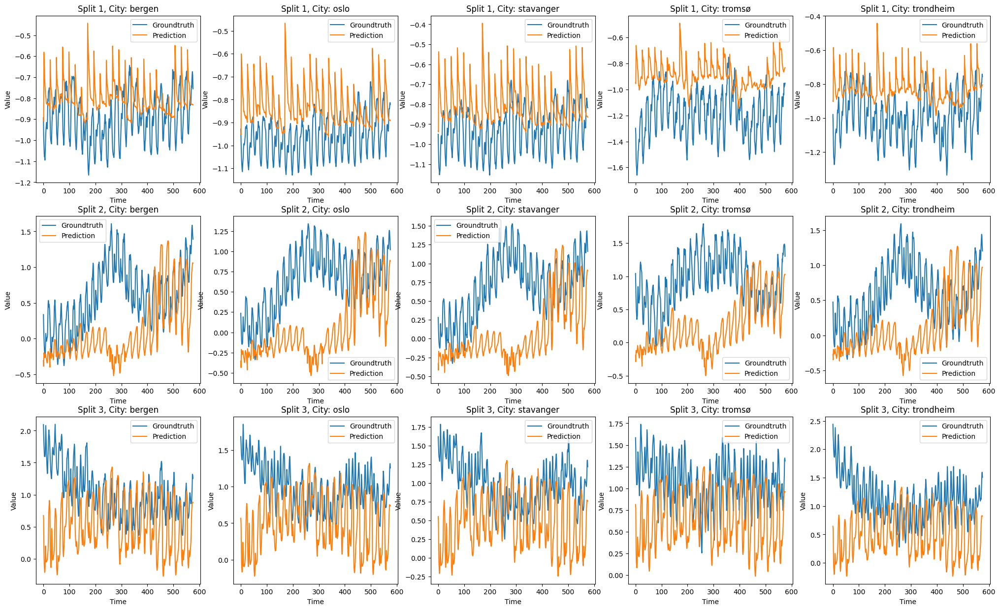

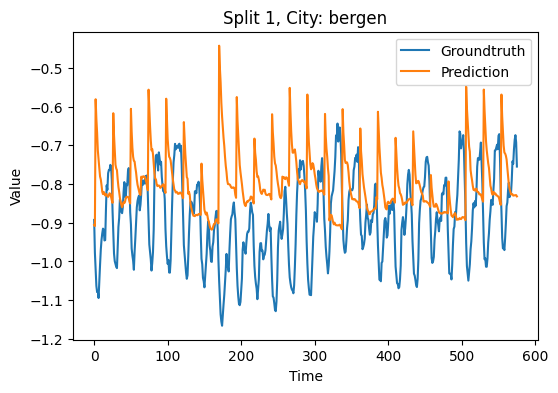

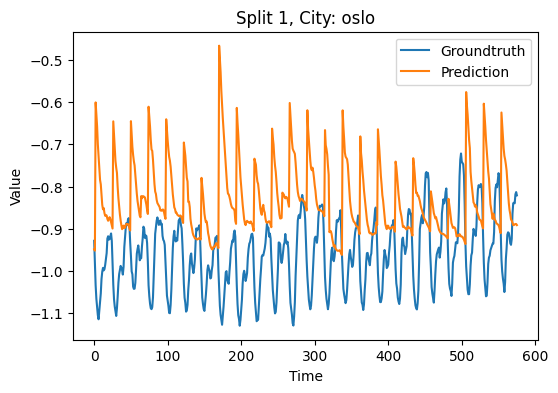

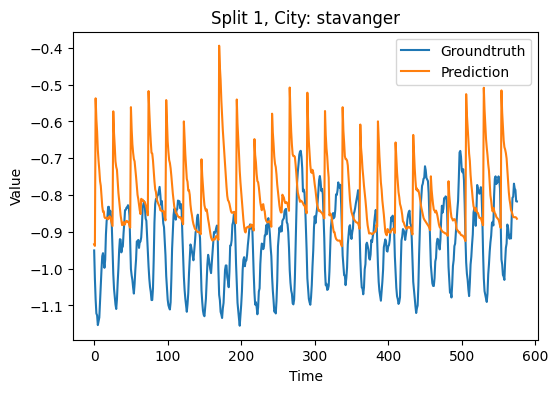

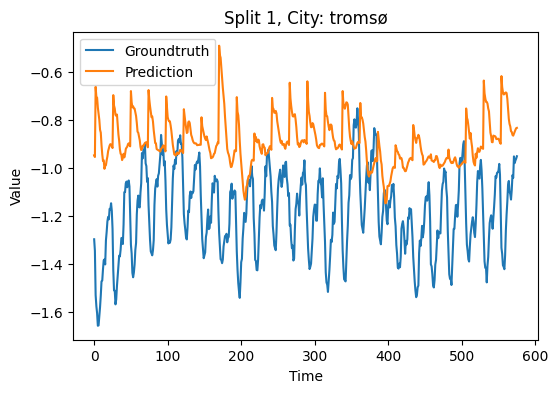

...

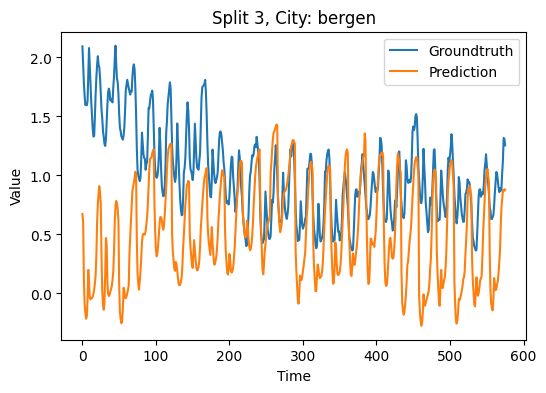

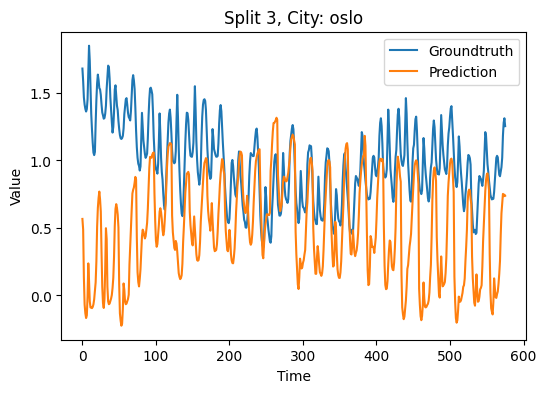

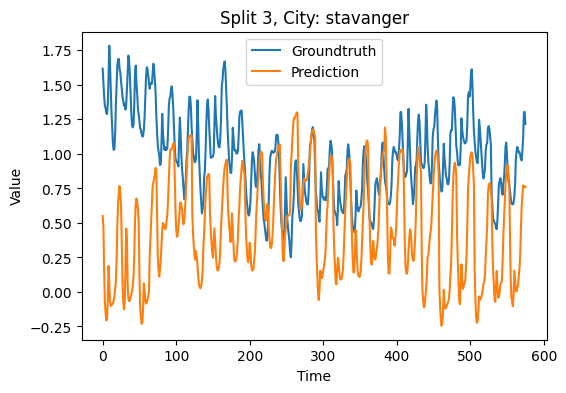

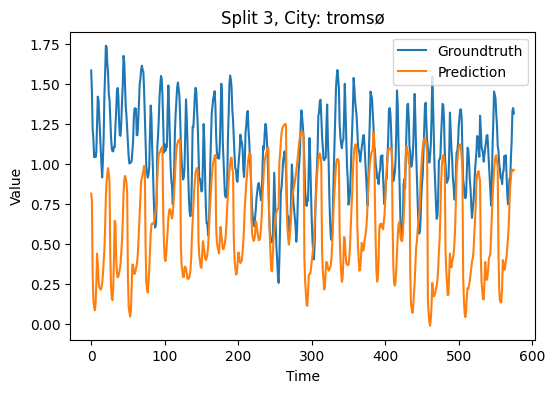

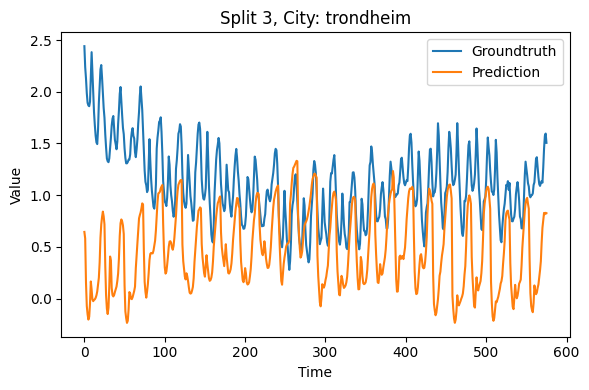

Metrics per City and Split:


,Split,City,MAE,MSE,RMSE,MAPE
0,1,1,0.140936,0.035321,0.187938,14.990044
1,1,2,0.151885,0.040489,0.201218,15.007462
2,1,3,0.162399,0.049554,0.222608,16.275379
3,1,4,0.305886,0.140200,0.374433,23.940036
4,1,5,0.186753,0.057304,0.239383,17.550558
5,2,1,0.564524,0.487006,0.697858,439.187089
6,2,2,0.606496,0.517003,0.719030,328.862823
7,2,3,0.655817,0.602018,0.775898,160.292036
8,2,4,0.709974,0.683597,0.826799,88.679491
9,2,5,0.562126,0.477557,0.691055,175.735493



Average Metrics per City Across Splits:


,City,Split,MAE,MSE,RMSE,MAPE
0,1,2.0,0.420789,0.340678,0.530899,169.586809
1,2,2.0,0.433024,0.333560,0.528657,132.603750
2,3,2.0,0.461344,0.374796,0.562041,77.933699
3,4,2.0,0.496330,0.378131,0.586181,52.342818
4,5,2.0,0.473231,0.396839,0.580054,84.187543



Overall Mean Metrics:
Mean MAE: 0.45694379348944897
Mean MSE: 0.3648008937566953
Mean RMSE: 0.5575665080407118
Mean MAPE: 103.33092381468609


In [90]:
all_city_predictions_tst1_reshaped = all_city_predictions_tst1.reshape(3, -1, 5)
visualize_and_get_metrics(splits=3, prediction=all_city_predictions_tst1_reshaped, truth=xg_truths)

## Transformer 2

### Create Model

In [98]:
class TimeSeriesTransformer2(nn.Module):
    def __init__(self, input_dim, d_model, nhead, num_encoder_layers, output_dim, n_future):
        super(TimeSeriesTransformer2, self).__init__()

        # Embedding layer: This layer converts the input features into embeddings of dimension d_model
        self.embedding = nn.Linear(input_dim, d_model)

        # Transformer encoder
        self.transformer = nn.TransformerEncoder(
            encoder_layer=nn.TransformerEncoderLayer(d_model=d_model, nhead=nhead),
            num_layers=num_encoder_layers
        )

        # Output layer: Produces a vector for future time steps
        self.output_layer = nn.Linear(d_model, output_dim * n_future)

    def forward(self, x, verbose=False):
        x = self.embedding(x)
        if verbose:
            print('1:', x.shape)
        x = self.transformer(x)
        if verbose:
            print('2:', x.shape)
        x = self.output_layer(x[:, :, :])
        if verbose:
            print('3:', x.shape)
        x = x.view(x.size(0), -1)
        if verbose:
            print('4:', x.shape)
        return x
    
    
model = TimeSeriesTransformer2(12, 1, 1, 1, 5, 120)
total_params, trainable_params = count_parameters(model)
print(f"Total parameters: {total_params}")
print(f"Trainable parameters: {trainable_params}")

Total parameters: 7370
Trainable parameters: 7370


In [99]:
model = TimeSeriesTransformer2(12, 1, 1, 1, 5, 120)
model.train()
optimizer = optim.Adam(model.parameters(), lr=0.001)
input = torch.randn(25, 216, 12)
out = model(input, verbose=True)

1: torch.Size([25, 216, 1])
2: torch.Size([25, 216, 1])
3: torch.Size([25, 216, 600])
4: torch.Size([25, 129600])


### Train Model

In [92]:
lr = 0.0003
batch_size = 64
epochs = 25
hidden_size = 128
num_heads = 6
dropout = 0.1

# Train the model
tst_model1 = TimeSeriesTransformer2(12, 1, 1, 1, 5, 120).to(device)
tst_optimizer1 = optim.Adam(tst_model1.parameters(), lr=lr)
train_model_sequential(tst_model1, nn.MSELoss(), tst_optimizer1, epochs=epochs, batch_size=batch_size)

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_20244\3085534986.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X, dtype=torch.float32)
C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_20244\3085534986.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y, dtype=torch.float32)


Epoch [5/25], Loss: 0.1929
Epoch [10/25], Loss: 0.1653
Epoch [15/25], Loss: 0.1255
Epoch [20/25], Loss: 0.1182
Epoch [25/25], Loss: 0.0956


### Get Predictions

In [ ]:
all_city_predictions_tst1 = get_predictions_sequential_batched(tst_model1, test_X, test_y, dual=False)
all_city_predictions_tst1.shape

### Output Results

In [ ]:
all_city_predictions_tst1_reshaped = all_city_predictions_tst1.reshape(3, -1, 5)
visualize_and_get_metrics(splits=3, prediction=all_city_predictions_tst1_reshaped, truth=xg_truths)

## Dual-Transformer

### Create Model

In [112]:
class DualTimeSeriesTransformer(nn.Module):
    def __init__(self, 
                 consumption_size=5,
                 rest_size=7, 
                 num_layers=1, 
                 num_heads=1, 
                 feedforward_dim=64, 
                 dropout=0.1, 
                 output_size=5,
                 pos_enc_con_size=216,
                 pos_enc_rest_size=336):
        super(DualTimeSeriesTransformer, self).__init__()
        
        self.feature_size = consumption_size + rest_size
        
        self.positional_encoding_con = nn.Parameter(torch.randn(1, pos_enc_con_size, consumption_size))
        self.positional_encoding_rest = nn.Parameter(torch.randn(1, pos_enc_rest_size, rest_size))
        
        self.transformer_consumptions = nn.Transformer(d_model=consumption_size, 
                                          nhead=num_heads, 
                                          num_encoder_layers=num_layers,
                                          num_decoder_layers=num_layers, 
                                          dim_feedforward=feedforward_dim, 
                                          dropout=dropout)
        
        self.transformer_rest = nn.Transformer(d_model=rest_size, 
                                          nhead=num_heads, 
                                          num_encoder_layers=num_layers,
                                          num_decoder_layers=num_layers, 
                                          dim_feedforward=feedforward_dim, 
                                          dropout=dropout)
        
        self.linear = nn.Linear(self.feature_size, output_size)
        
    def forward(self, consumptions, rests, verbose=False):
        # Add positional encoding
        consumptions = consumptions + self.positional_encoding_con
        rests = rests + self.positional_encoding_rest

        if verbose:
            print('1:', consumptions.shape)
            print('1:', rests.shape)
        
        # Transformer expects tgt (target tensor) for supervised tasks, but for our forecasting task
        # We'll use shifted input as target (this is a common trick for time series forecasting)
        tgt_con = torch.roll(consumptions, shifts=-1, dims=1)
        tgt_rest = torch.roll(rests, shifts=-1, dims=1)

        if verbose:
            print('2:', tgt_con.shape)
            print('2:', tgt_rest.shape)
        
        # Apply transformers
        out_con = self.transformer_consumptions(consumptions, tgt_con)
        out_rest = self.transformer_rest(rests, tgt_rest)[:, :216, :]

        if verbose:
            print('3:', out_con.shape)
            print('3:', out_rest.shape)
        
        # Pass concat through linear layer
        out = self.linear(torch.cat((out_con, out_rest), 2))

        if verbose:
            print('5:', out.shape)
        
        return out
    
model = DualTimeSeriesTransformer()
total_params, trainable_params = count_parameters(model)
print(f"Total parameters: {total_params}")
print(f"Trainable parameters: {trainable_params}")

Total parameters: 8049
Trainable parameters: 8049


In [113]:
model = DualTimeSeriesTransformer()
model.train()
optimizer = optim.Adam(model.parameters(), lr=0.001)
input_con = torch.randn(25, 216, 5)
input_rest = torch.randn(25, 336, 7)
out = model(input_con, input_rest, verbose=True)

1: torch.Size([25, 216, 5])
1: torch.Size([25, 336, 7])
2: torch.Size([25, 216, 5])
2: torch.Size([25, 336, 7])
3: torch.Size([25, 216, 5])
3: torch.Size([25, 216, 7])
5: torch.Size([25, 216, 5])


### Train Model

In [115]:
lr = 0.0003
batch_size = 64
epochs = 50

# Train the model
tst_model_dual = DualTimeSeriesTransformer().to(device)
tst_optimizer_dual = optim.Adam(tst_model_dual.parameters(), lr=lr)
# Train dataset
train_dataset = TimeSeriesDataset(train_X, train_y)
# Instantiate data loader
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
train_model_sequential_dual(tst_model_dual, train_loader, nn.MSELoss(), tst_optimizer_dual, epochs=epochs, batch_size=batch_size)

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_20244\3085534986.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X, dtype=torch.float32)
C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_20244\3085534986.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y, dtype=torch.float32)


Epoch [5/50], Loss: 0.4378
Epoch [10/50], Loss: 0.2171
Epoch [15/50], Loss: 0.1175
Epoch [20/50], Loss: 0.1482
Epoch [25/50], Loss: 0.1539
Epoch [30/50], Loss: 0.1247
Epoch [35/50], Loss: 0.1155
Epoch [40/50], Loss: 0.1406
Epoch [45/50], Loss: 0.0989
Epoch [50/50], Loss: 0.1334


In [117]:
all_city_predictions_tst_dual = get_predictions_sequential_batched(tst_model_dual, test_X, test_y, dual=True)
all_city_predictions_tst_dual.shape

C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_20244\3085534986.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X, dtype=torch.float32)
C:\Users\Ferdinand\AppData\Local\Temp\ipykernel_20244\3085534986.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y, dtype=torch.float32)


(1728, 5)

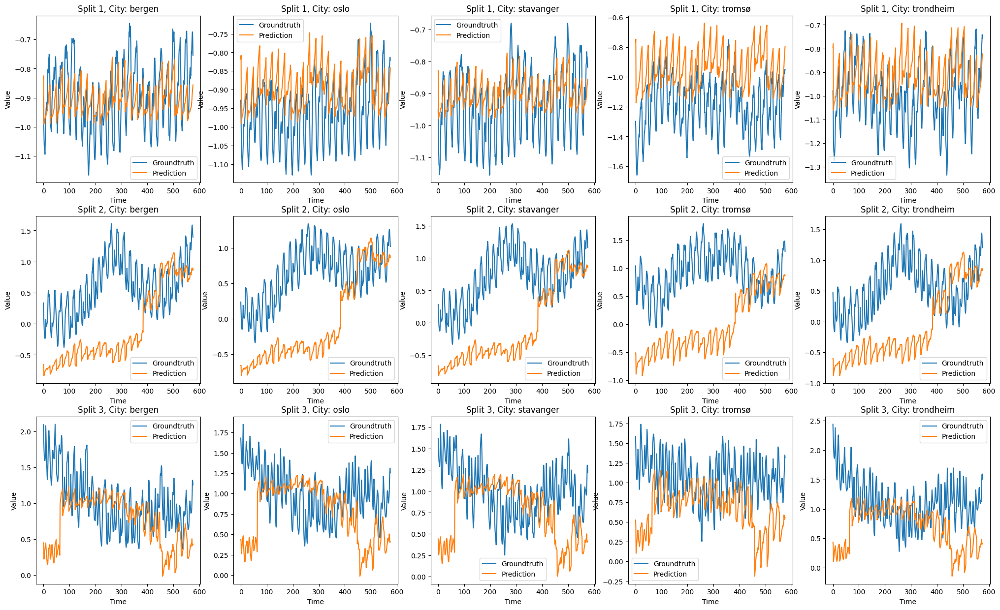

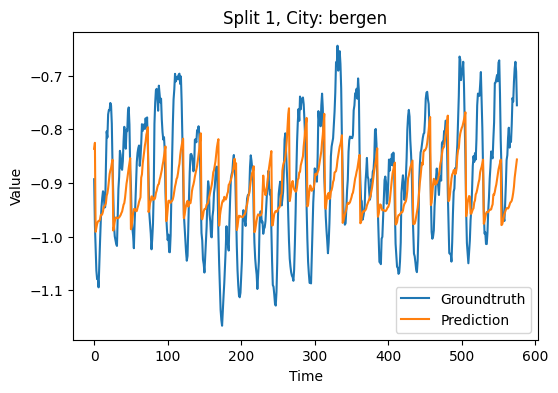

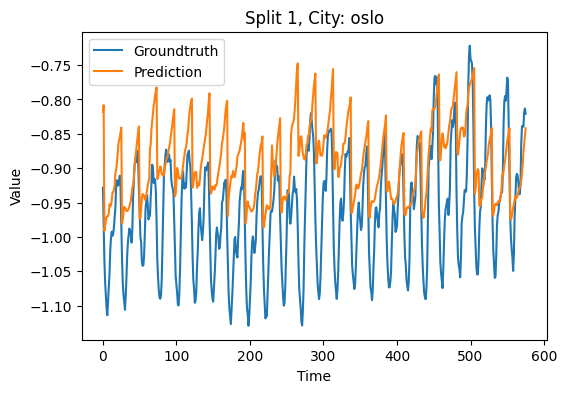

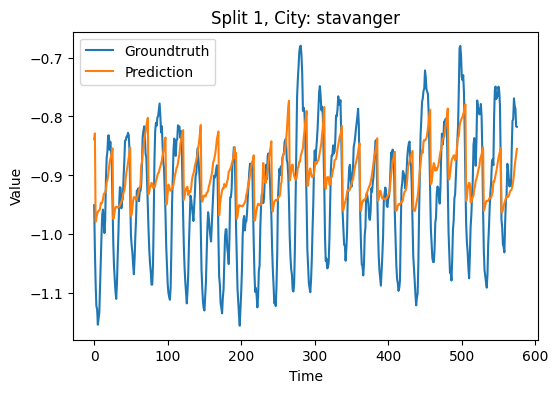

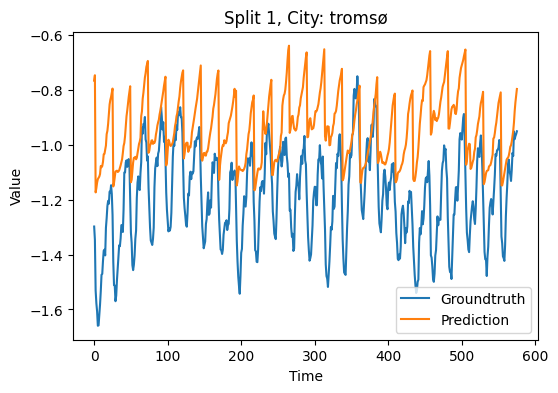

...

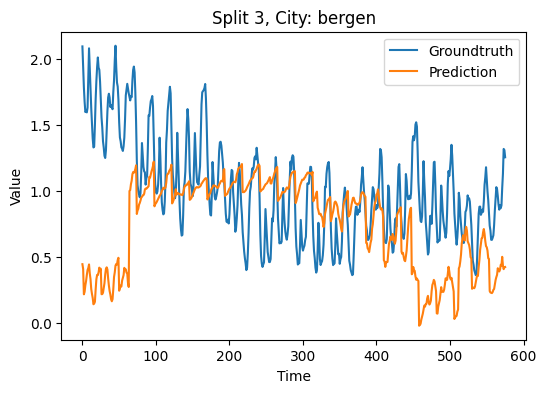

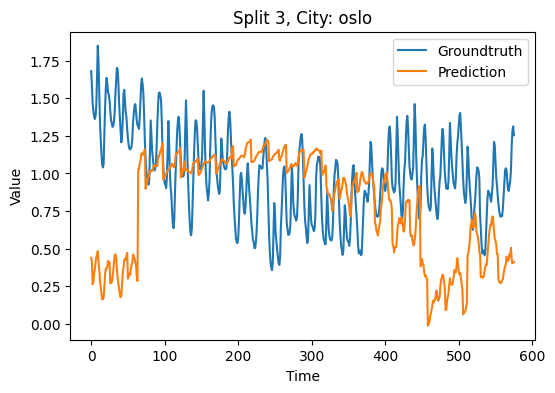

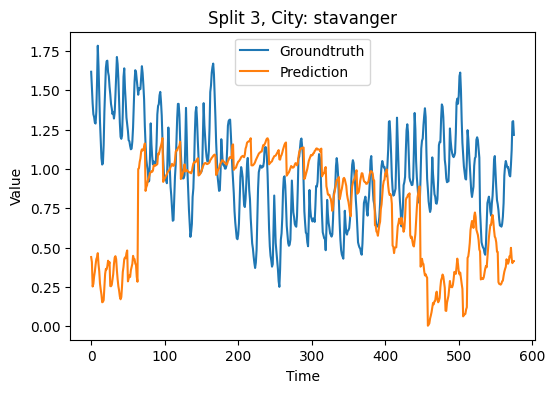

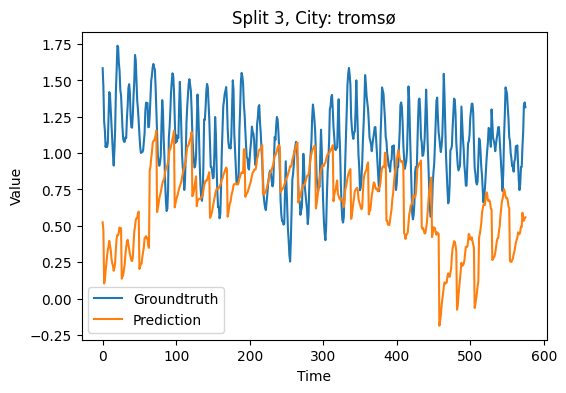

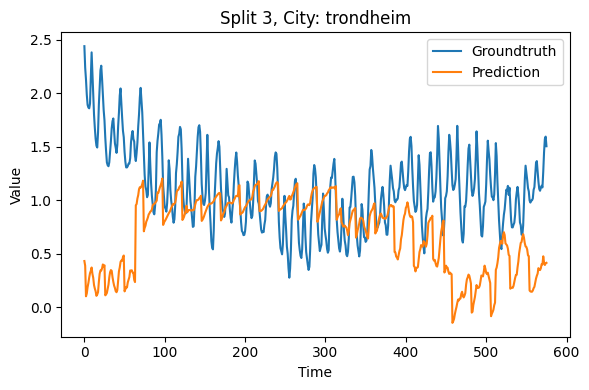

Metrics per City and Split:


,Split,City,MAE,MSE,RMSE,MAPE
0,1,1,0.075933,0.008762,0.093607,8.869439
1,1,2,0.080536,0.009696,0.098471,8.090581
2,1,3,0.074769,0.008635,0.092924,7.825813
3,1,4,0.249668,0.080540,0.283796,20.302658
4,1,5,0.106209,0.018063,0.134400,10.229503
5,2,1,0.760943,0.800057,0.894459,1202.988293
6,2,2,0.756369,0.780961,0.883720,803.626706
7,2,3,0.811190,0.917344,0.957781,328.246081
8,2,4,0.988090,1.272991,1.128269,170.331154
9,2,5,0.791453,0.843063,0.918185,464.833427



Average Metrics per City Across Splits:


,City,Split,MAE,MSE,RMSE,MAPE
0,1,2.0,0.423698,0.385763,0.526126,418.391678
1,2,2.0,0.417781,0.358543,0.505339,285.292399
2,3,2.0,0.436672,0.409443,0.533522,127.048311
3,4,2.0,0.563795,0.552226,0.654217,77.485178
4,5,2.0,0.474497,0.451889,0.585273,173.293434



Overall Mean Metrics:
Mean MAE: 0.4632885380864978
Mean MSE: 0.4315726687460796
Mean RMSE: 0.5608957537950066
Mean MAPE: 216.3022000579753


In [118]:
all_city_predictions_tst_dual_reshaped = all_city_predictions_tst_dual.reshape(3, -1, 5)
visualize_and_get_metrics(splits=3, prediction=all_city_predictions_tst_dual_reshaped, truth=xg_truths)

## Tuned Dual-Transformer